In [1]:
from datetime import datetime

import pyspark
from pyspark.sql import Row
from pyspark.sql import functions as F

from pyspark.sql.window import Window
from pyspark.sql.types import *
import findspark

In [2]:
findspark.init()

In [3]:
spark = pyspark.sql.SparkSession.builder.getOrCreate()

In [4]:
data_path = 'datasets/'

In [5]:
df: pyspark.sql.DataFrame = spark.read.csv(
    data_path + 'All.csv',
    header=True,
    inferSchema=True
)

In [6]:
df.printSchema()

root
 |-- RequestID: integer (nullable = true)
 |-- Boro: string (nullable = true)
 |-- Yr: integer (nullable = true)
 |-- M: integer (nullable = true)
 |-- D: integer (nullable = true)
 |-- HH: integer (nullable = true)
 |-- MM: integer (nullable = true)
 |-- Vol: integer (nullable = true)
 |-- SegmentID: integer (nullable = true)
 |-- WktGeom: string (nullable = true)
 |-- street: string (nullable = true)
 |-- fromSt: string (nullable = true)
 |-- toSt: string (nullable = true)
 |-- Direction: string (nullable = true)



In [7]:
df.show()

+---------+-------------+----+---+---+---+---+---+---------+--------------------+------+-------------+-------------+---------+
|RequestID|         Boro|  Yr|  M|  D| HH| MM|Vol|SegmentID|             WktGeom|street|       fromSt|         toSt|Direction|
+---------+-------------+----+---+---+---+---+---+---------+--------------------+------+-------------+-------------+---------+
|     1100|Staten Island|2011| 10| 14| 10| 45|102|   103882|POINT (963246 173...|BAY ST|RICHMOND TERR|STUYVESANT PL|       SB|
|     1100|Staten Island|2011| 10| 14| 11|  0|110|   103882|POINT (963246 173...|BAY ST|RICHMOND TERR|STUYVESANT PL|       SB|
|     1100|Staten Island|2011| 10| 14| 11| 15|101|   103882|POINT (963246 173...|BAY ST|RICHMOND TERR|STUYVESANT PL|       SB|
|     1100|Staten Island|2011| 10| 14| 11| 30|112|   103882|POINT (963246 173...|BAY ST|RICHMOND TERR|STUYVESANT PL|       SB|
|     1100|Staten Island|2011| 10| 14| 11| 45| 94|   103882|POINT (963246 173...|BAY ST|RICHMOND TERR|STUYVESAN

In [8]:
df = df.withColumn(
    'Date',
    F.concat_ws(
        '-',
        F.col('Yr'),
        F.col('M'),
        F.col('D')
    )
).withColumn(
    'Time',
    F.concat_ws(
        ':',
        F.col('HH'),
        F.col('MM')
    )
).withColumn(
    'Datetime',
    F.concat_ws(
        ' ',
        F.col('Date'),
        F.col('Time')
    )
).withColumn(
    'Datetime',
    F.to_timestamp(F.col('Datetime'))
).drop('Date', 'Time')

In [37]:
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt

In [10]:
def create_scatterplot(df: pd.DataFrame, x, y):
    plt.figure(figsize=(40, 8))
    sns.scatterplot(data=df, x=x, y=y)
    plt.show()

In [33]:
def create_scatterplots(df: pyspark.sql.DataFrame, x, y, hue_cols):
    for group_name in df.select(*hue_cols).distinct().collect():
        dict_group_name = group_name.asDict()
        # Filter the DataFrame based on the group's values
        filter_df = df
        for key, value in dict_group_name.items():
            filter_df = filter_df.filter(F.col(key) == value)

        print('Hue:', dict_group_name)
        filter_pdf = filter_df.toPandas()
        create_scatterplot(filter_pdf, x, y)

In [18]:
def count_continue_datetime(df: pd.DataFrame, datetime_col: str, freq: str, debug=False):
    """Counts continuous datetime ranges within a specified frequency."""

    if datetime_col not in df.columns:
        raise ValueError(f"Column '{datetime_col}' not found in DataFrame.")
    if not pd.api.types.is_datetime64_dtype(df[datetime_col]):
        raise TypeError(f"Column '{datetime_col}' must be of datetime dtype.")

    def generate_groups():
        prev_datetime = None
        curr_group = []
        for curr_datetime in df[datetime_col]:
            if prev_datetime is None or (curr_datetime - prev_datetime) <= pd.Timedelta(freq):
                curr_group.append(curr_datetime)
            else:
                yield prev_datetime, curr_group[0], len(curr_group)
                curr_group = [curr_datetime]
            prev_datetime = curr_datetime
        if curr_group:
            yield prev_datetime, curr_group[0], len(curr_group)

    return pd.DataFrame(generate_groups(), columns=['Start_Date', 'End_Date', 'Count'])

In [20]:
def count_continue_datetime_with_hue(df: pyspark.sql.DataFrame, datetime_col: str, freq: str = '15Min', hue_cols: list[str] = None, debug=False):
    if datetime_col not in df.columns:
        raise ValueError(f'Col `{datetime_col}` must be in DataFrame. For example: {df.columns}')

    if hue_cols:
        for hue_col in hue_cols:
            if hue_col not in df.columns:
                raise ValueError(f'Col `{hue_col}` must be in DataFrame. For example: {df.columns}')

    if hue_cols:
        results = []
        for group_name in df.select(*hue_cols).distinct().collect():
            dict_group_name = group_name.asDict()
            # Filter the DataFrame based on the group's values
            filter_df = df
            for key, value in dict_group_name.items():
                filter_df = filter_df.filter(F.col(key) == value)

            filter_pdf = filter_df.toPandas()
            result = count_continue_datetime(filter_pdf, datetime_col, freq)
            result = pd.concat([result, pd.DataFrame(group_name, index=hue_cols).T], axis=1)  # Expand group_name values
            if debug:
                print(result)
            results.append(result)
        
        return pd.concat(results, ignore_index=True)
    else:
        return count_continue_datetime(df, datetime_col, freq)

In [15]:
df_2014 = df.filter(F.col('Yr') == 2014)

In [16]:
df_2014.show(20)

+---------+--------+----+---+---+---+---+---+---------+--------------------+-----------+-----------+-----------+---------+-------------------+
|RequestID|    Boro|  Yr|  M|  D| HH| MM|Vol|SegmentID|             WktGeom|     street|     fromSt|       toSt|Direction|           Datetime|
+---------+--------+----+---+---+---+---+---+---------+--------------------+-----------+-----------+-----------+---------+-------------------+
|    16501|Brooklyn|2014|  1|  9|  0|  0| 38|   163789|POINT (999756.4 1...|BROOKLYN AV|HERKIMER ST|ATLANTIC AV|       SB|2014-01-09 00:00:00|
|    16501|Brooklyn|2014|  1|  9|  0| 15| 35|   163789|POINT (999756.4 1...|BROOKLYN AV|HERKIMER ST|ATLANTIC AV|       SB|2014-01-09 00:15:00|
|    16501|Brooklyn|2014|  1|  9|  0| 30| 26|   163789|POINT (999756.4 1...|BROOKLYN AV|HERKIMER ST|ATLANTIC AV|       SB|2014-01-09 00:30:00|
|    16501|Brooklyn|2014|  1|  9|  0| 45| 23|   163789|POINT (999756.4 1...|BROOKLYN AV|HERKIMER ST|ATLANTIC AV|       SB|2014-01-09 00:45:00|

In [23]:
# Set the frequency interval
freq_pyspark = '15Min' # Specify the interval directly as an integer

result_df = count_continue_datetime_with_hue(df_2014, 'Datetime', freq_pyspark, ['SegmentID', 'Direction'], debug=True)

ERROR:root:KeyboardInterrupt while sending command.
Traceback (most recent call last):
  File "C:\Users\le197\anaconda3\Lib\site-packages\py4j\java_gateway.py", line 1038, in send_command
    response = connection.send_command(command)
               ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\le197\anaconda3\Lib\site-packages\py4j\clientserver.py", line 511, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
                          ^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\le197\anaconda3\Lib\socket.py", line 706, in readinto
    return self._sock.recv_into(b)
           ^^^^^^^^^^^^^^^^^^^^^^^
KeyboardInterrupt


KeyboardInterrupt: 

In [ ]:
result_df

In [ ]:
df_2017 = df.filter(F.col('Yr') == 2017)

In [ ]:
result_df_2017 = count_continue_datetime_with_hue(df_2017, 'Datetime', freq_pyspark, ['SegmentID', 'Direction'], debug=True)

In [ ]:
result_df_2017

In [24]:
df_2014_0102 = df.filter((F.col('Yr') == 2014) & (F.col('M').isin(1, 2)))

In [ ]:
segmentIDs = [row['SegmentID'] for row in df_2014_0102.filter((F.col('M') == 1) & (F.col('D') == 25)).select('SegmentID').distinct().collect()]

In [31]:
df_2014_0102_with_filter = df_2014_0102.filter(F.col('SegmentID').isin(*segmentIDs))

Hue: {'SegmentID': 31188, 'Direction': 'WB'}


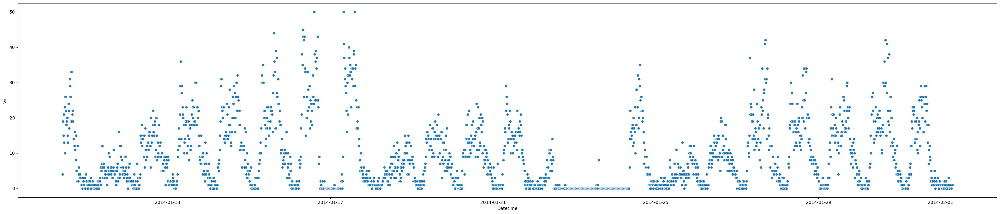

Hue: {'SegmentID': 88035, 'Direction': 'SB'}


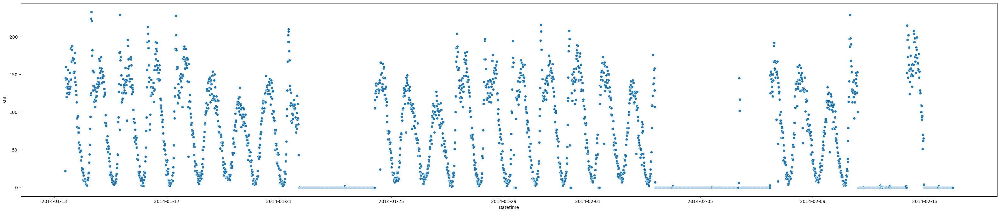

Hue: {'SegmentID': 31050, 'Direction': 'EB'}


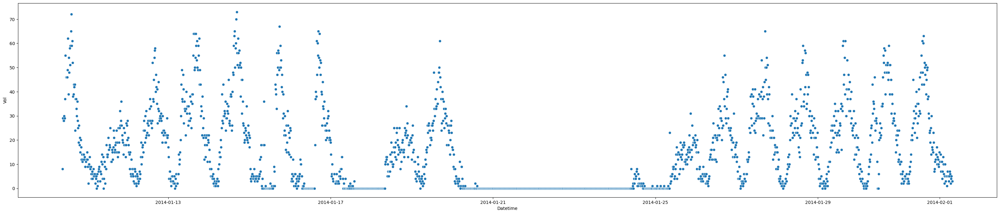

Hue: {'SegmentID': 110982, 'Direction': 'WB'}


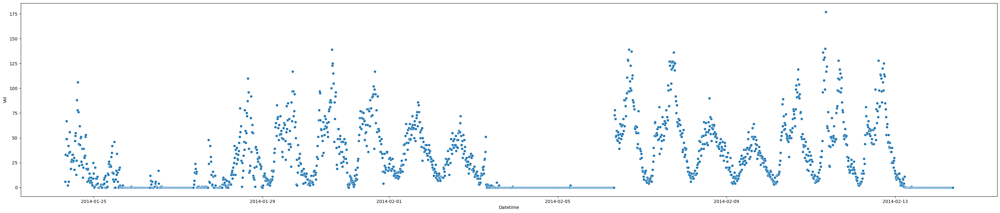

Hue: {'SegmentID': 31035, 'Direction': 'EB'}


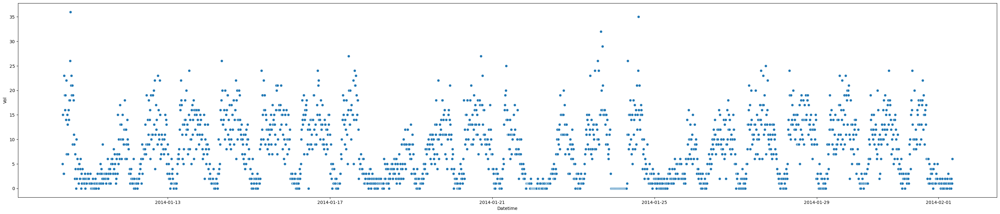

Hue: {'SegmentID': 75423, 'Direction': 'WB'}


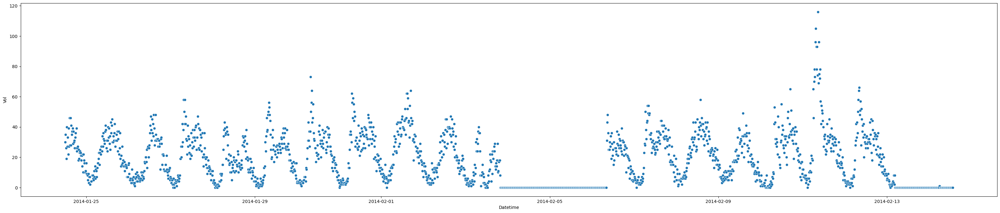

Hue: {'SegmentID': 86529, 'Direction': 'NB'}


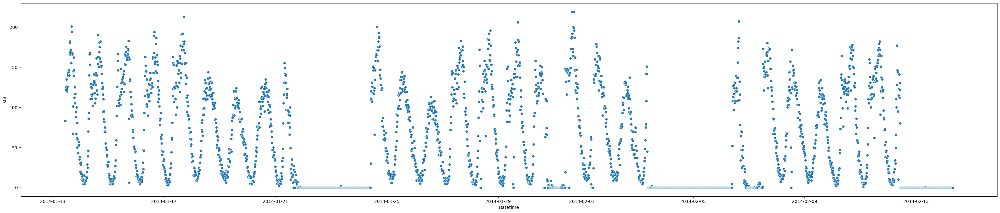

Hue: {'SegmentID': 9870, 'Direction': 'EB'}


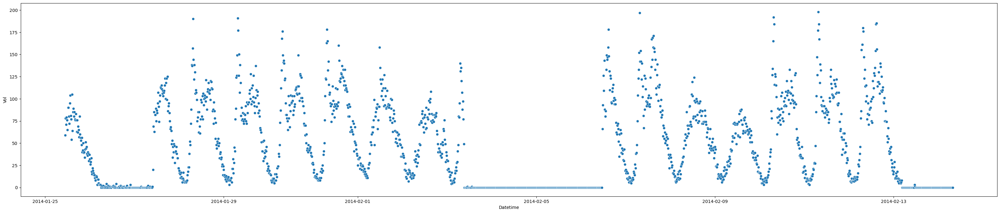

Hue: {'SegmentID': 103541, 'Direction': 'EB'}


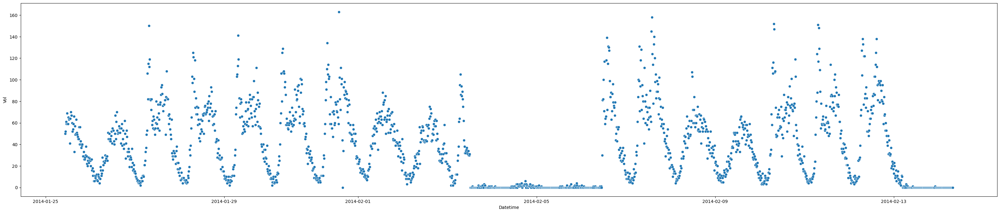

Hue: {'SegmentID': 5652, 'Direction': 'WB'}


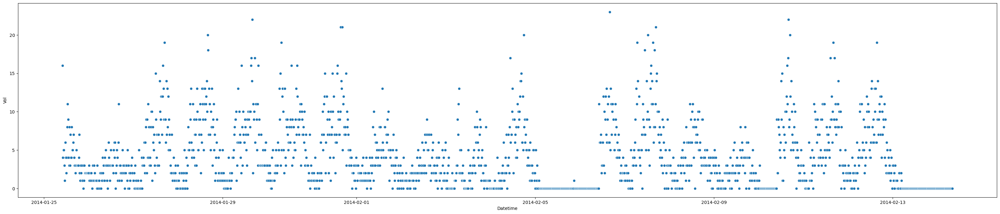

Hue: {'SegmentID': 75592, 'Direction': 'WB'}


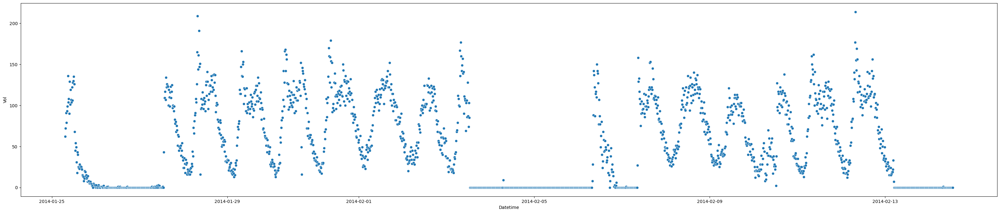

Hue: {'SegmentID': 75595, 'Direction': 'SB'}


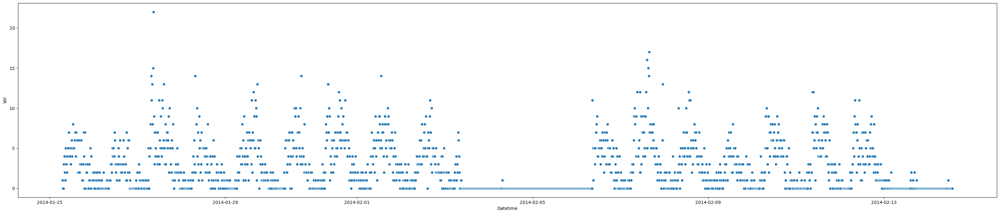

Hue: {'SegmentID': 34017, 'Direction': 'SB'}


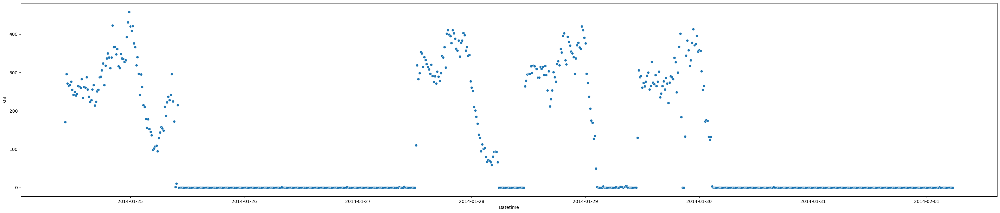

Hue: {'SegmentID': 185359, 'Direction': 'WB'}


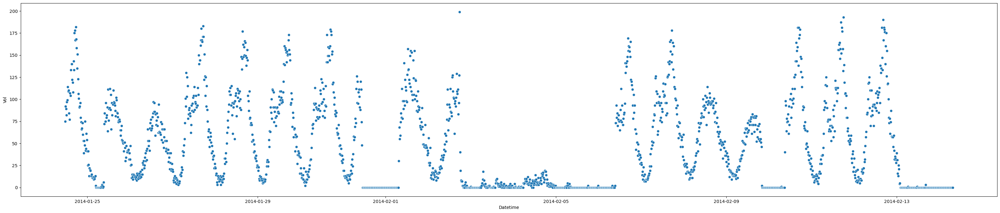

Hue: {'SegmentID': 34172, 'Direction': 'SB'}


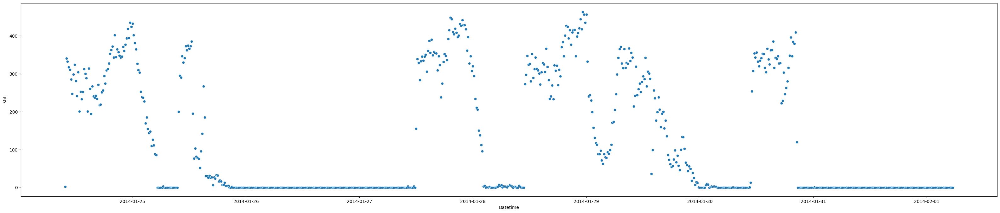

Hue: {'SegmentID': 5748, 'Direction': 'EB'}


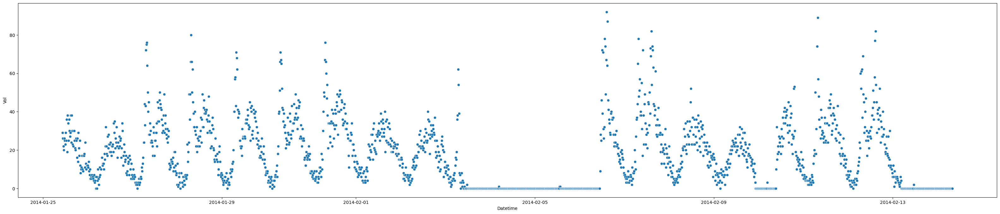

Hue: {'SegmentID': 31187, 'Direction': 'SB'}


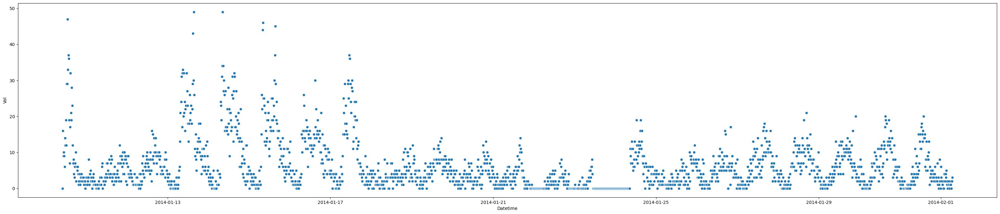

Hue: {'SegmentID': 119765, 'Direction': 'EB'}


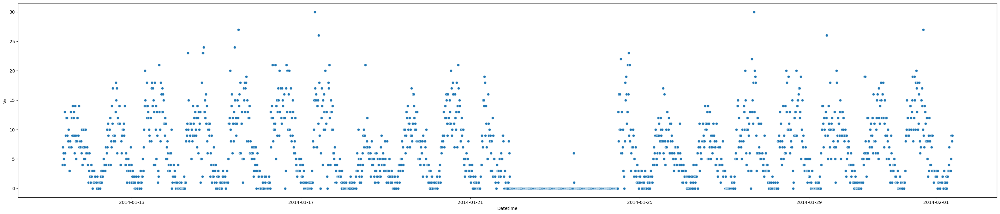

Hue: {'SegmentID': 31035, 'Direction': 'WB'}


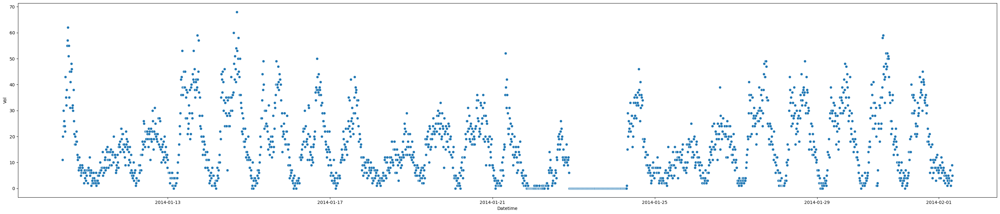

Hue: {'SegmentID': 69450, 'Direction': 'NB'}


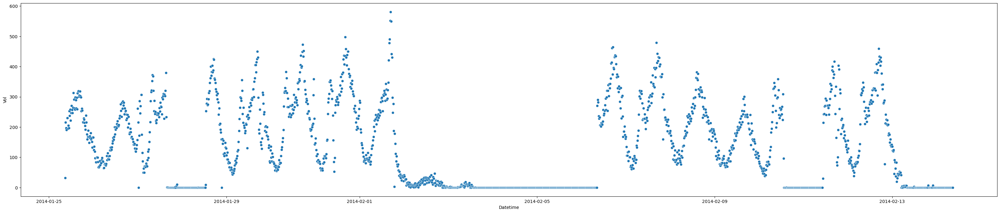

Hue: {'SegmentID': 31033, 'Direction': 'EB'}


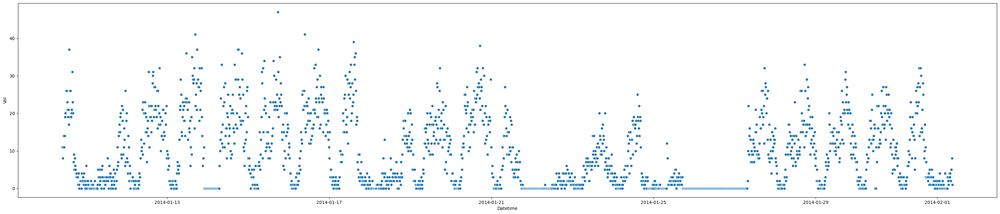

Hue: {'SegmentID': 36011, 'Direction': 'SB'}


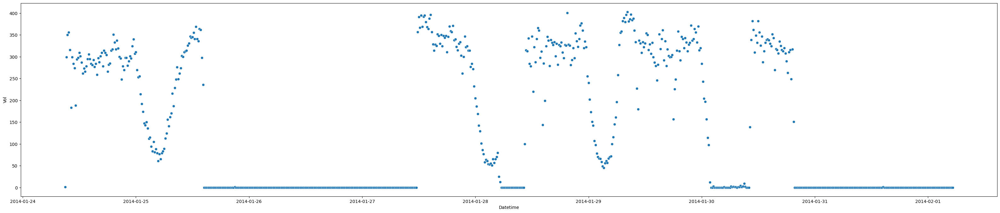

Hue: {'SegmentID': 9944, 'Direction': 'EB'}


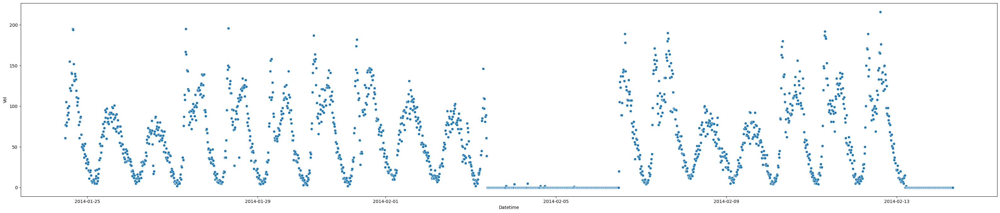

Hue: {'SegmentID': 75422, 'Direction': 'EB'}


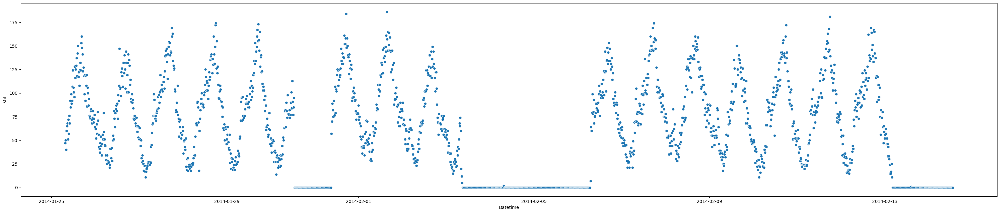

Hue: {'SegmentID': 9885, 'Direction': 'WB'}


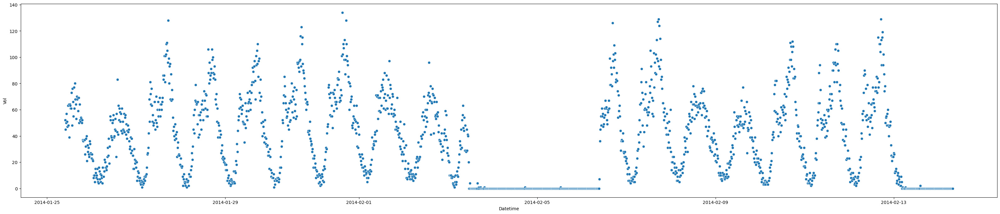

Hue: {'SegmentID': 35810, 'Direction': 'SB'}


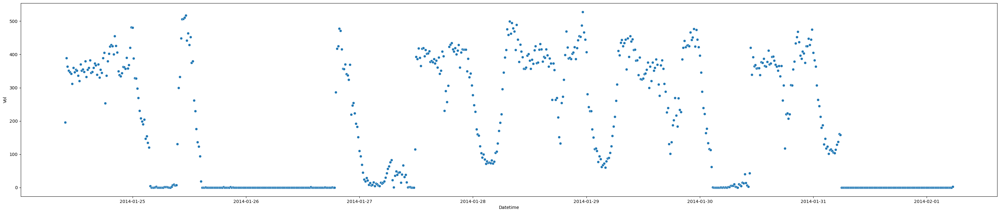

Hue: {'SegmentID': 31189, 'Direction': 'NB'}


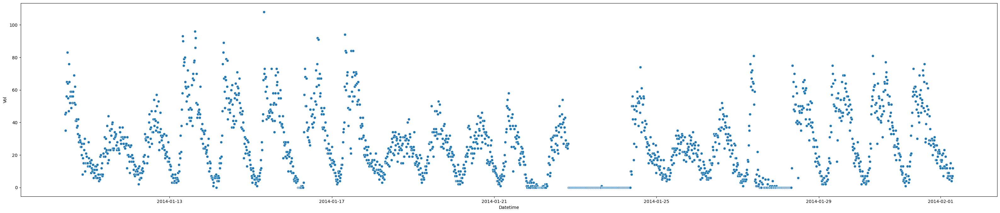

Hue: {'SegmentID': 31217, 'Direction': 'SB'}


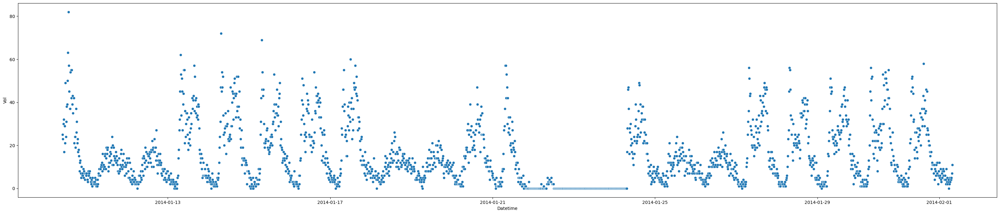

Hue: {'SegmentID': 31210, 'Direction': 'SB'}


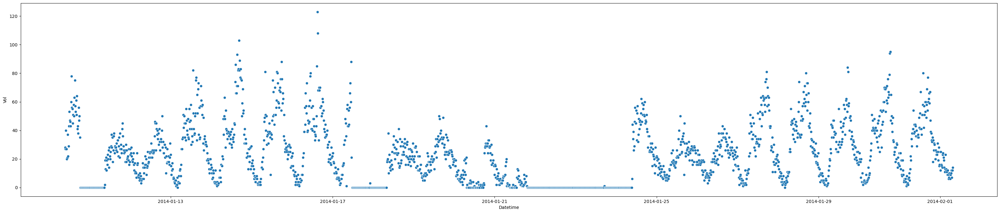

Hue: {'SegmentID': 33884, 'Direction': 'SB'}


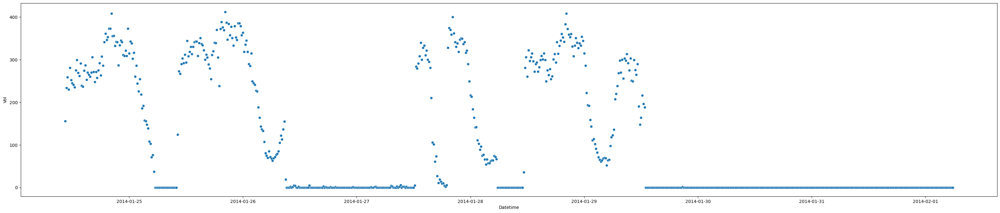

Hue: {'SegmentID': 106006, 'Direction': 'NB'}


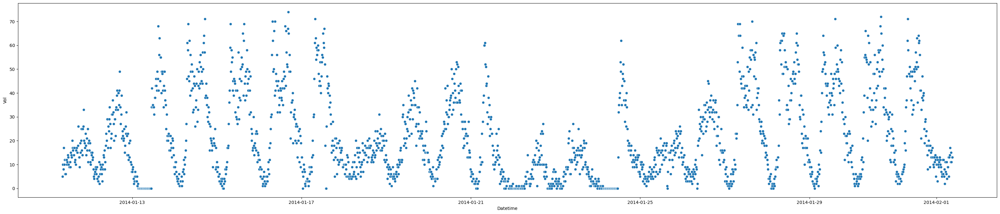

Hue: {'SegmentID': 31029, 'Direction': 'EB'}


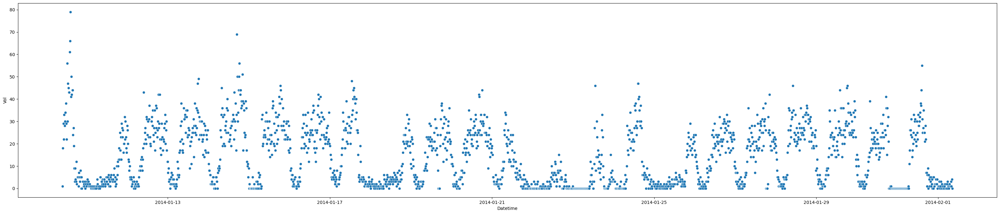

Hue: {'SegmentID': 9832, 'Direction': 'WB'}


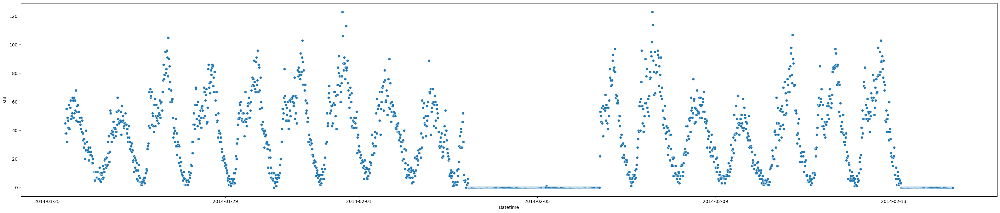

Hue: {'SegmentID': 5753, 'Direction': 'WB'}


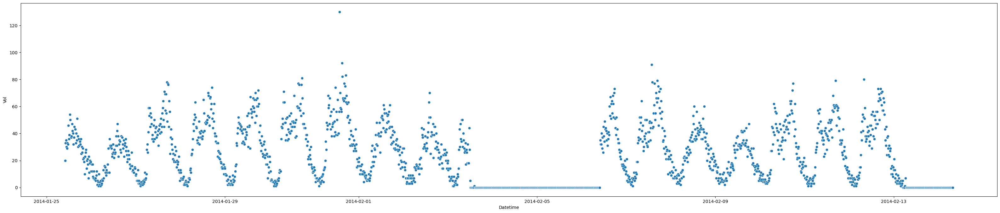

Hue: {'SegmentID': 75601, 'Direction': 'SB'}


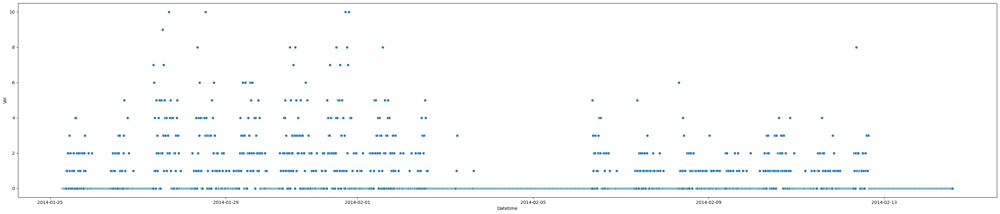

Hue: {'SegmentID': 119730, 'Direction': 'EB'}


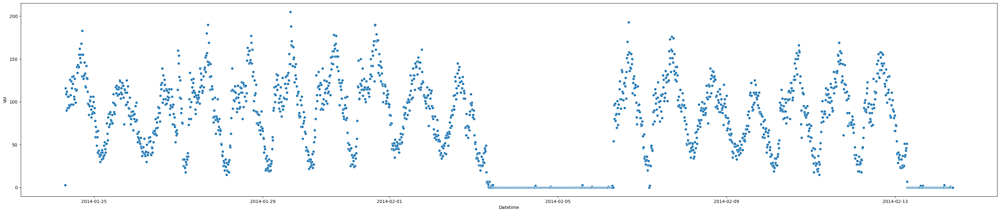

Hue: {'SegmentID': 119765, 'Direction': 'WB'}


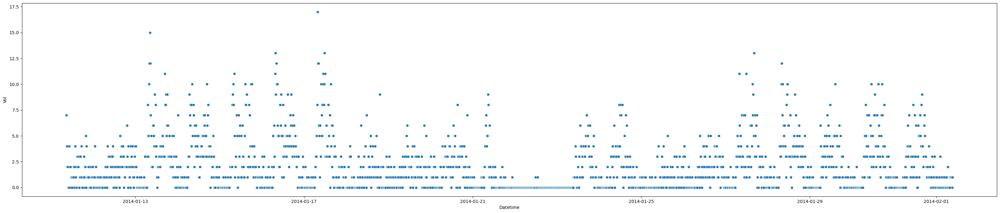

Hue: {'SegmentID': 88033, 'Direction': 'EB'}


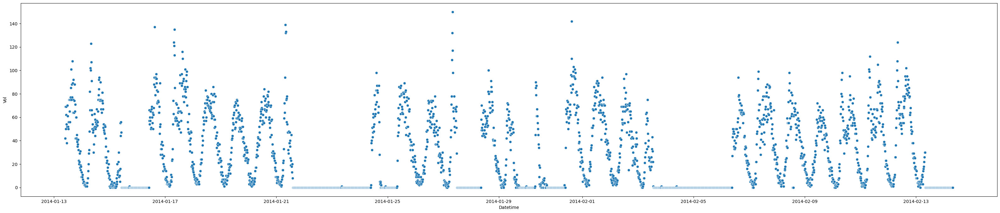

Hue: {'SegmentID': 128138, 'Direction': 'NB'}


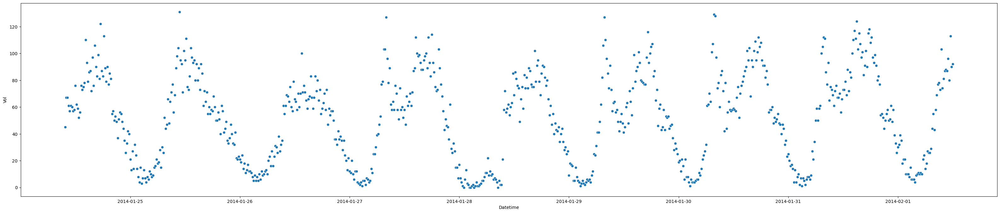

Hue: {'SegmentID': 128138, 'Direction': 'SB'}


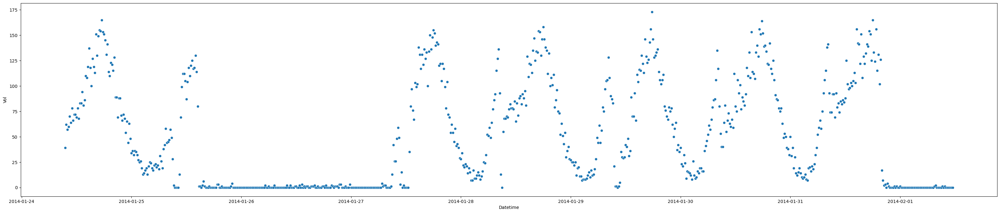

Hue: {'SegmentID': 41687, 'Direction': 'SB'}


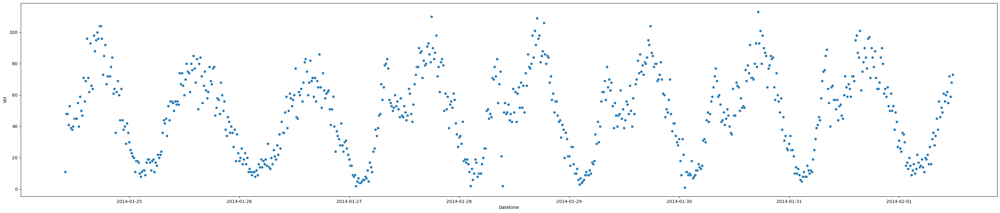

In [38]:
create_scatterplots(df_2014_0102_with_filter, 'Datetime', 'Vol', ['SegmentID', 'Direction'])

In [40]:
df_2014_0102_with_filter.filter(F.col('Datetime') > '2014-01-25').show()

+---------+---------+----+---+---+---+---+---+---------+--------------------+------+---------------+---------------+---------+-------------------+
|RequestID|     Boro|  Yr|  M|  D| HH| MM|Vol|SegmentID|             WktGeom|street|         fromSt|           toSt|Direction|           Datetime|
+---------+---------+----+---+---+---+---+---+---------+--------------------+------+---------------+---------------+---------+-------------------+
|    16594|Manhattan|2014|  1| 25|  0| 15|388|    35810|POINT (990250.6 2...|  5 AV|E 47 ST/W 47 ST|E 48 ST/W 48 ST|       SB|2014-01-25 00:15:00|
|    16594|Manhattan|2014|  1| 25|  0| 30|329|    35810|POINT (990250.6 2...|  5 AV|E 47 ST/W 47 ST|E 48 ST/W 48 ST|       SB|2014-01-25 00:30:00|
|    16594|Manhattan|2014|  1| 25|  0| 45|328|    35810|POINT (990250.6 2...|  5 AV|E 47 ST/W 47 ST|E 48 ST/W 48 ST|       SB|2014-01-25 00:45:00|
|    16594|Manhattan|2014|  1| 25|  1|  0|298|    35810|POINT (990250.6 2...|  5 AV|E 47 ST/W 47 ST|E 48 ST/W 48 ST|  

Hue: {'SegmentID': 31188, 'Direction': 'WB'}


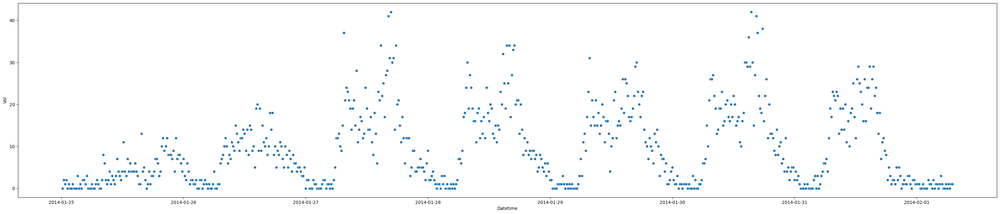

Hue: {'SegmentID': 88035, 'Direction': 'SB'}


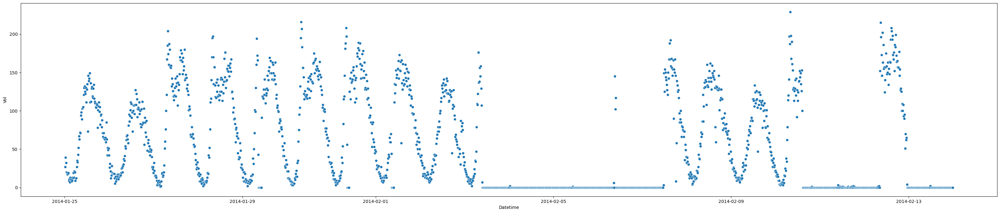

Hue: {'SegmentID': 31050, 'Direction': 'EB'}


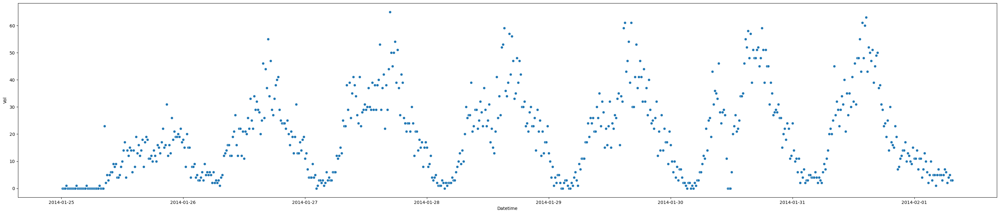

Hue: {'SegmentID': 110982, 'Direction': 'WB'}


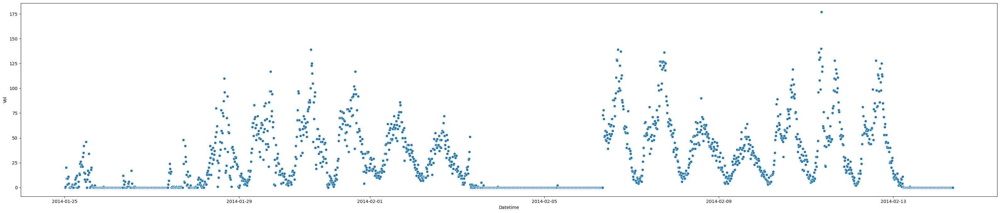

Hue: {'SegmentID': 31035, 'Direction': 'EB'}


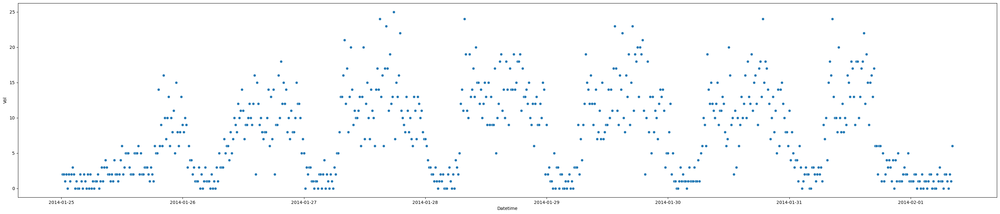

Hue: {'SegmentID': 75423, 'Direction': 'WB'}


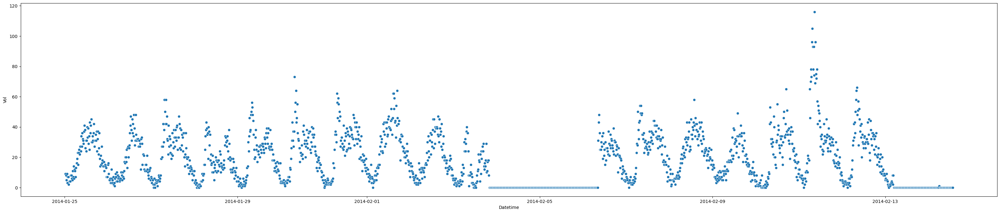

Hue: {'SegmentID': 86529, 'Direction': 'NB'}


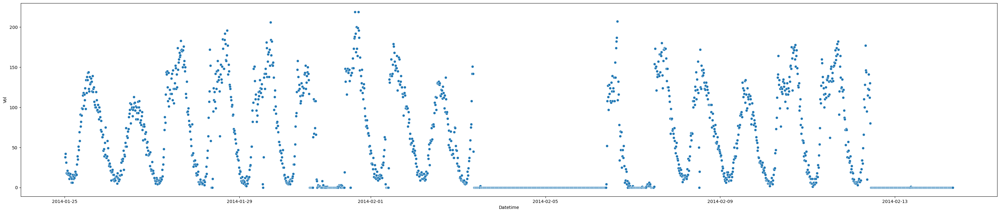

Hue: {'SegmentID': 9870, 'Direction': 'EB'}


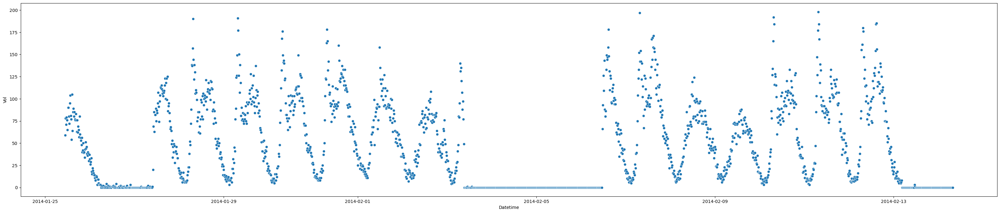

Hue: {'SegmentID': 103541, 'Direction': 'EB'}


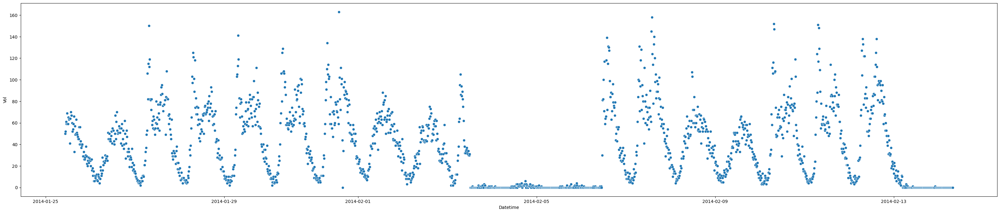

Hue: {'SegmentID': 5652, 'Direction': 'WB'}


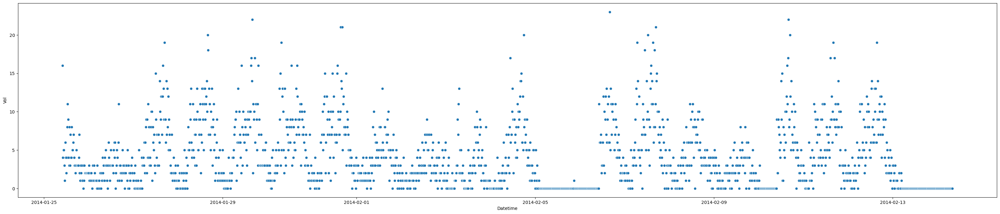

Hue: {'SegmentID': 75592, 'Direction': 'WB'}


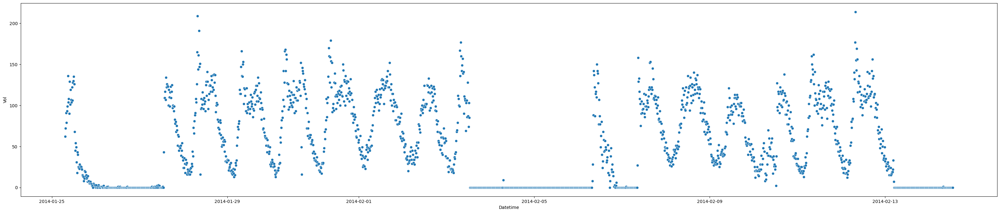

Hue: {'SegmentID': 75595, 'Direction': 'SB'}


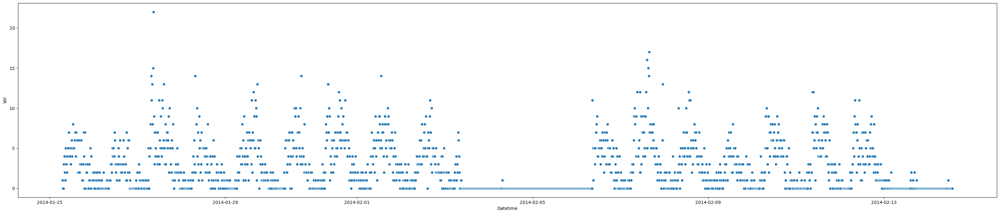

Hue: {'SegmentID': 34017, 'Direction': 'SB'}


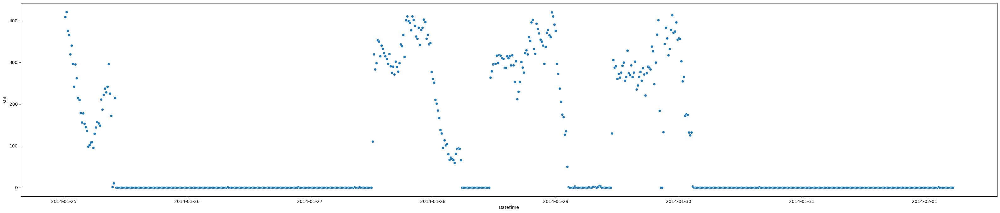

Hue: {'SegmentID': 185359, 'Direction': 'WB'}


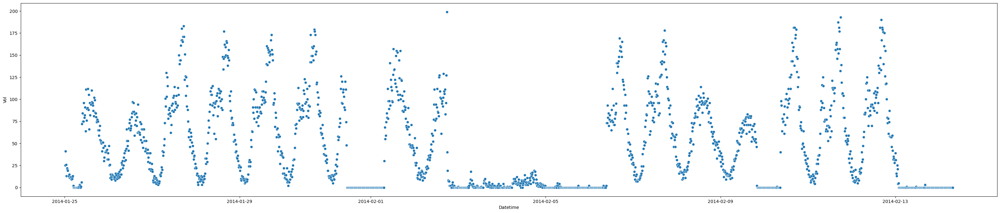

Hue: {'SegmentID': 34172, 'Direction': 'SB'}


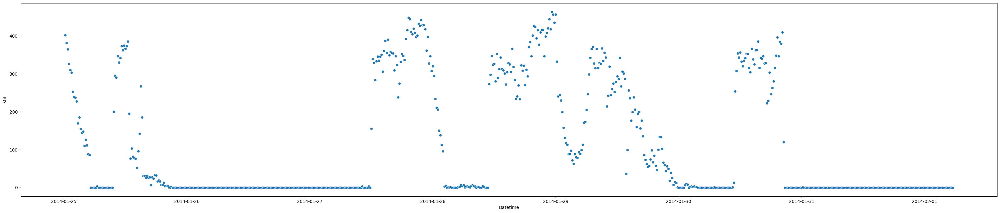

Hue: {'SegmentID': 5748, 'Direction': 'EB'}


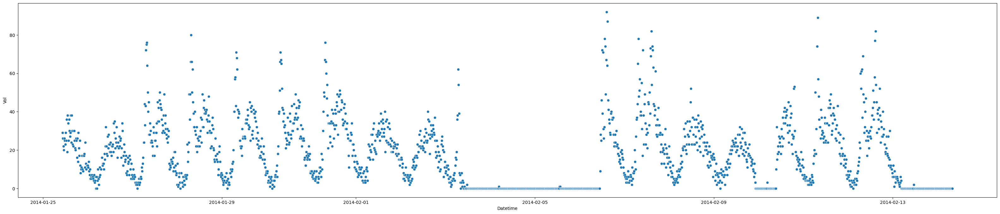

Hue: {'SegmentID': 31187, 'Direction': 'SB'}


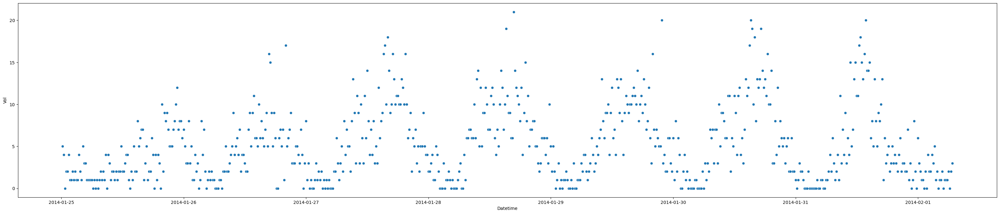

Hue: {'SegmentID': 119765, 'Direction': 'EB'}


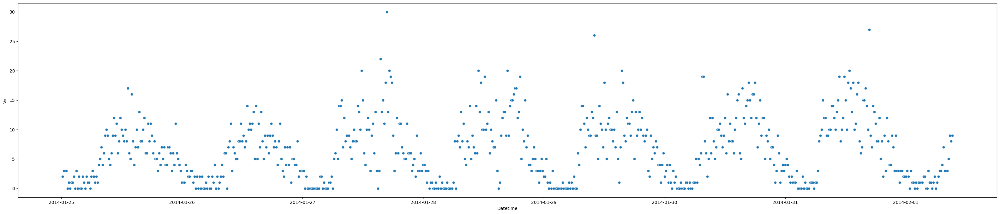

Hue: {'SegmentID': 31035, 'Direction': 'WB'}


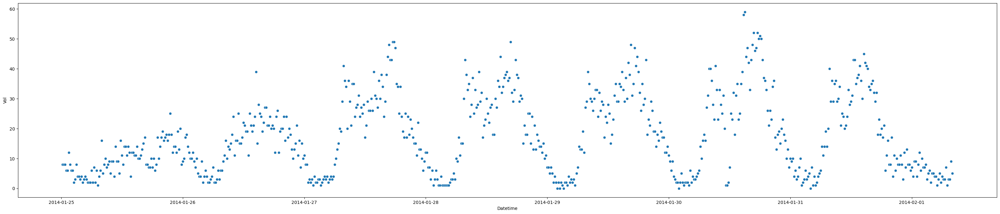

Hue: {'SegmentID': 69450, 'Direction': 'NB'}


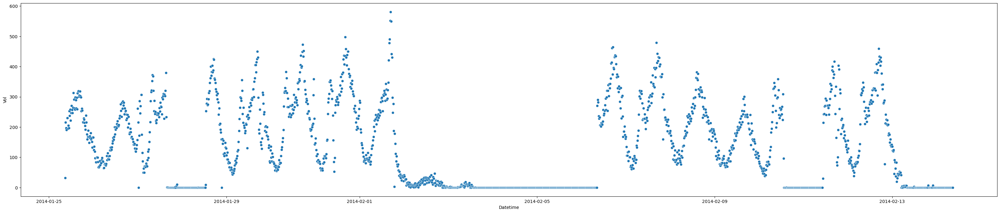

Hue: {'SegmentID': 31033, 'Direction': 'EB'}


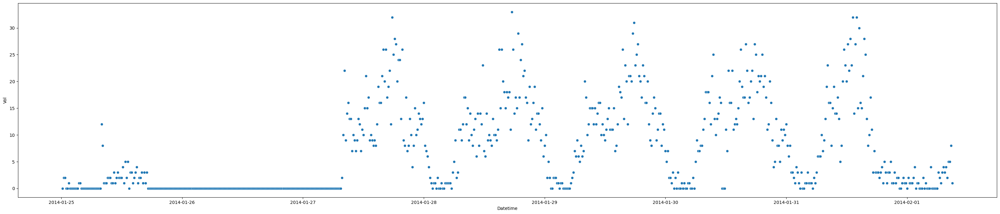

Hue: {'SegmentID': 36011, 'Direction': 'SB'}


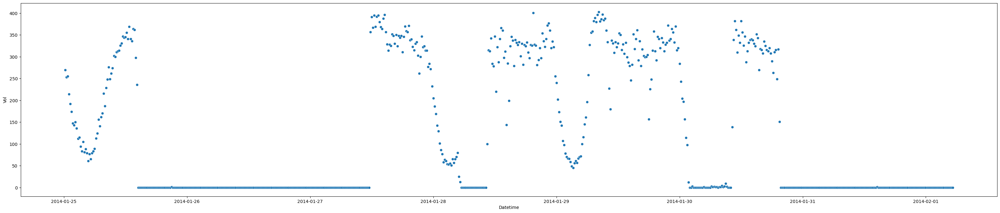

Hue: {'SegmentID': 9944, 'Direction': 'EB'}


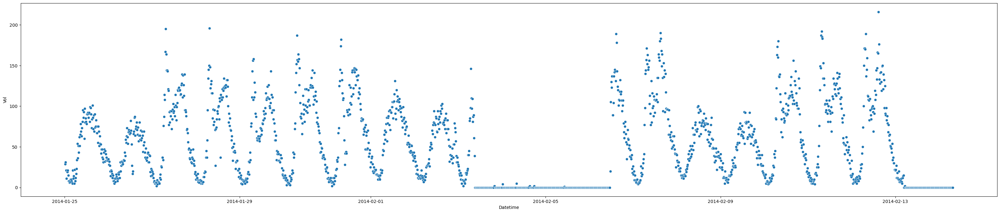

Hue: {'SegmentID': 75422, 'Direction': 'EB'}


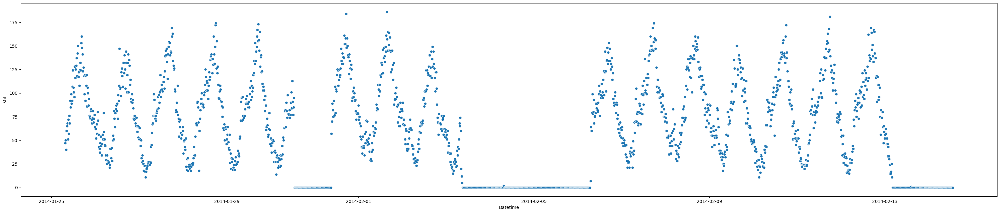

Hue: {'SegmentID': 9885, 'Direction': 'WB'}


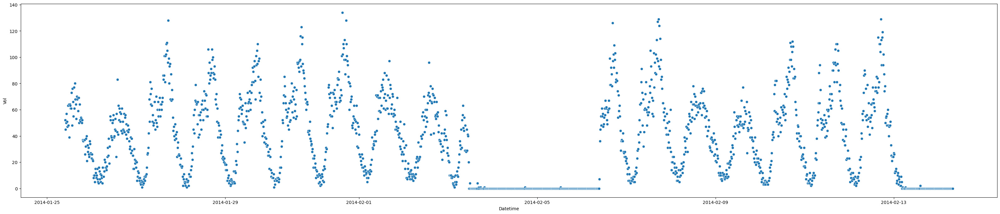

Hue: {'SegmentID': 35810, 'Direction': 'SB'}


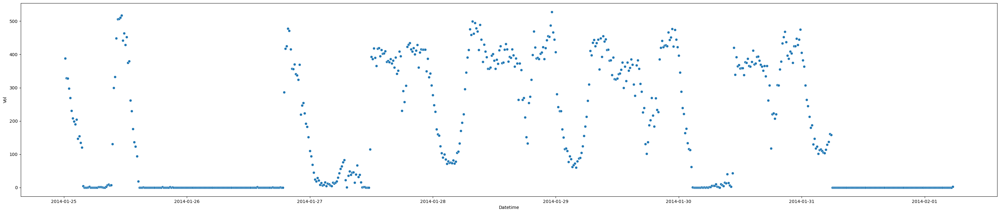

Hue: {'SegmentID': 31189, 'Direction': 'NB'}


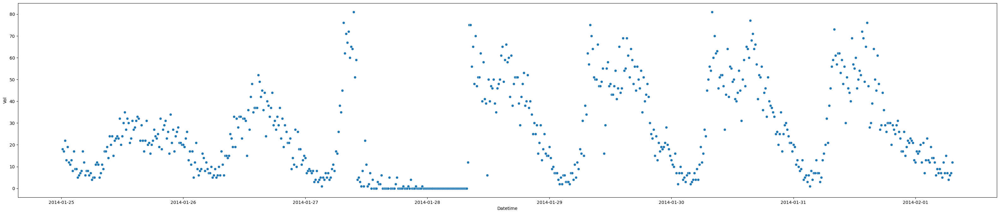

Hue: {'SegmentID': 31217, 'Direction': 'SB'}


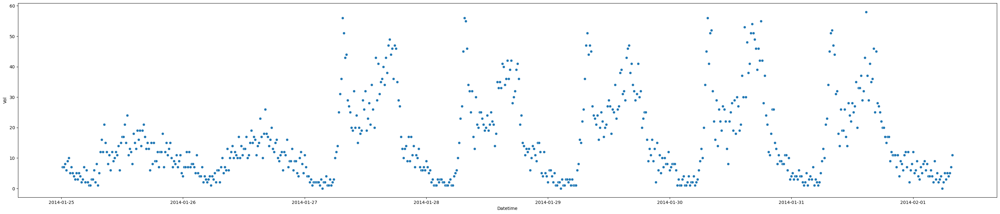

Hue: {'SegmentID': 31210, 'Direction': 'SB'}


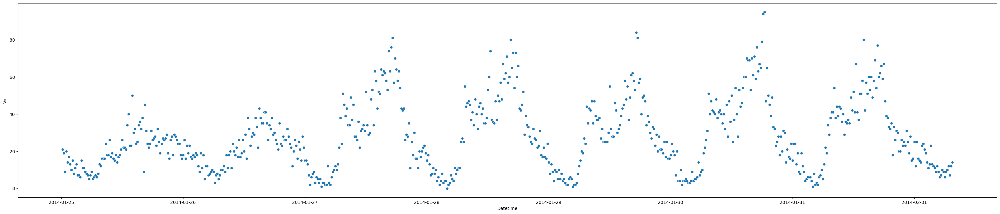

Hue: {'SegmentID': 33884, 'Direction': 'SB'}


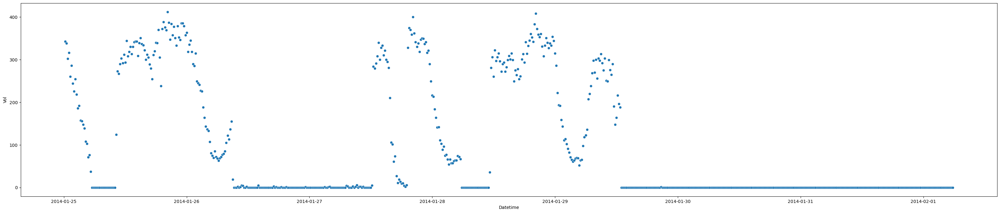

Hue: {'SegmentID': 106006, 'Direction': 'NB'}


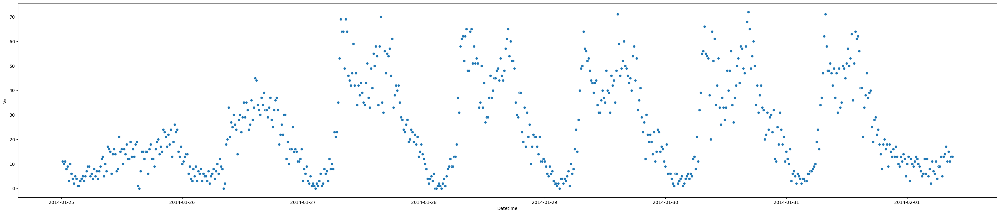

Hue: {'SegmentID': 31029, 'Direction': 'EB'}


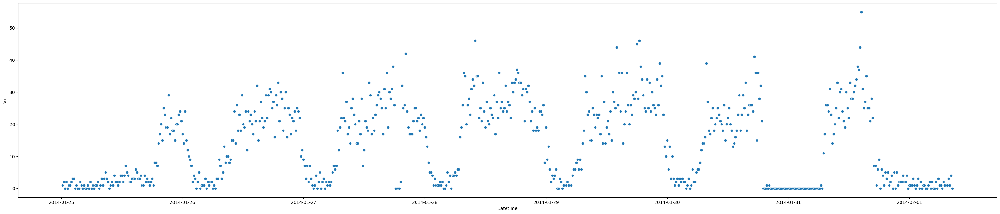

Hue: {'SegmentID': 9832, 'Direction': 'WB'}


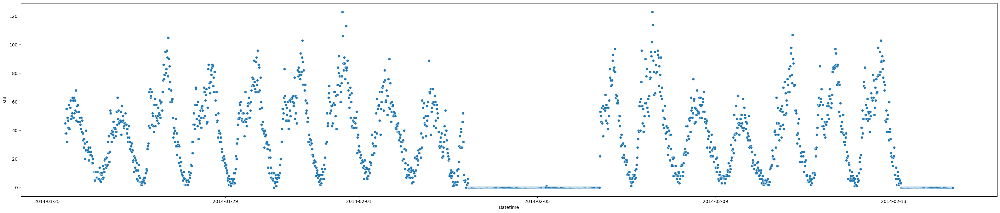

Hue: {'SegmentID': 5753, 'Direction': 'WB'}


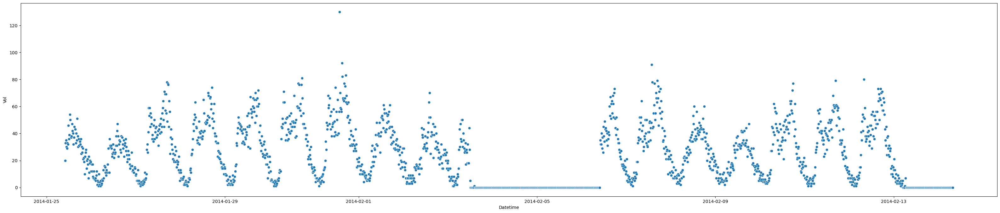

Hue: {'SegmentID': 75601, 'Direction': 'SB'}


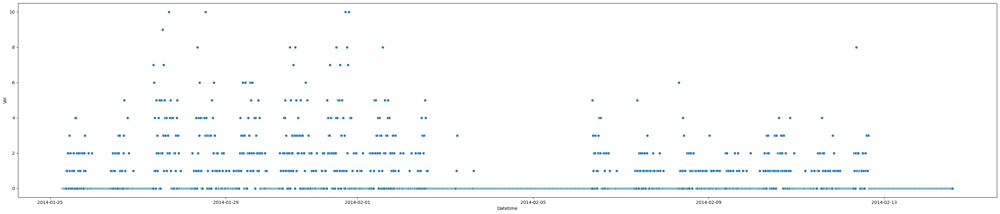

Hue: {'SegmentID': 119730, 'Direction': 'EB'}


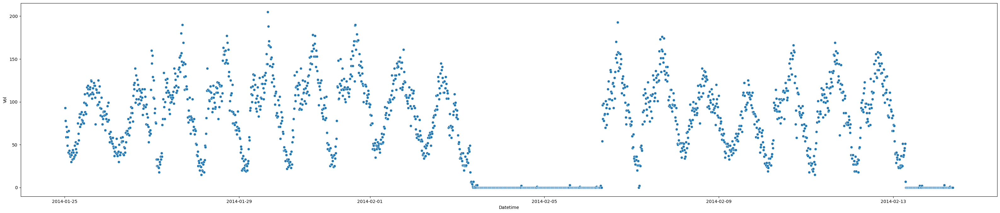

Hue: {'SegmentID': 119765, 'Direction': 'WB'}


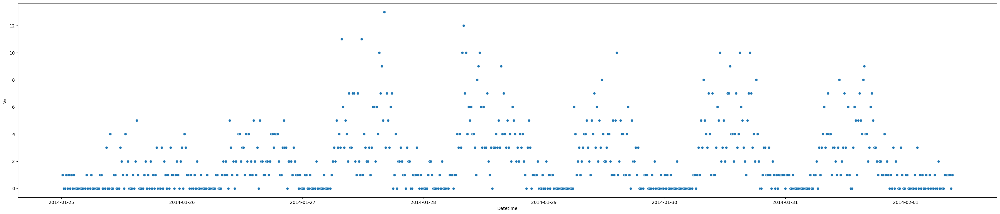

Hue: {'SegmentID': 88033, 'Direction': 'EB'}


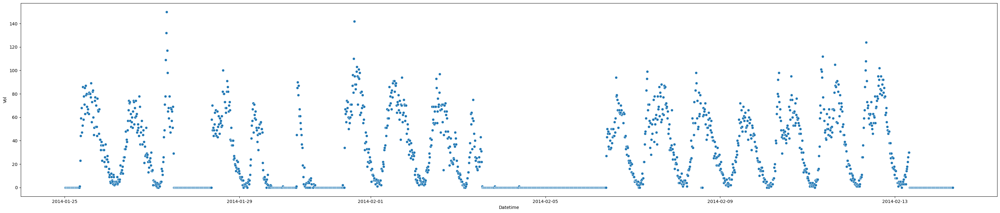

Hue: {'SegmentID': 128138, 'Direction': 'NB'}


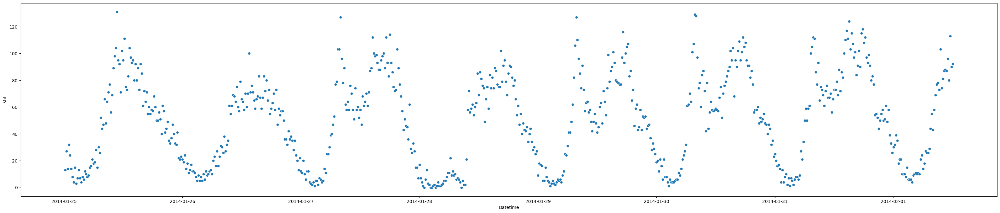

Hue: {'SegmentID': 128138, 'Direction': 'SB'}


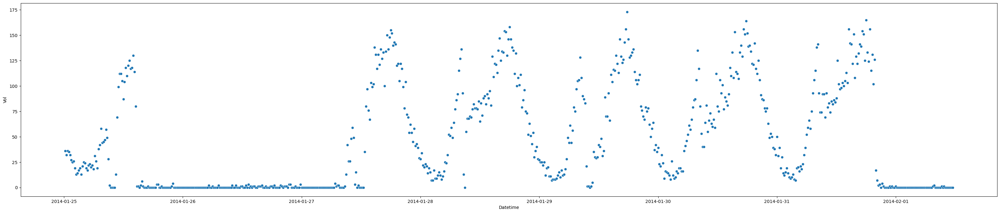

Hue: {'SegmentID': 41687, 'Direction': 'SB'}


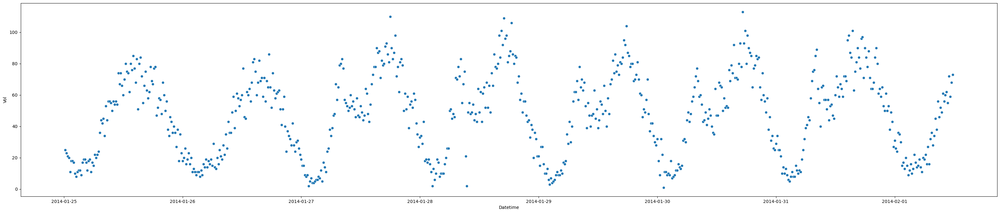

In [41]:
create_scatterplots(
    df_2014_0102_with_filter.filter(
        F.col('Datetime') > '2014-01-25'
    ),
    'Datetime',
    'Vol',
    ['SegmentID', 'Direction']
)

In [42]:
df_2017_0506_with_filter = df.filter((F.col('Datetime') > '2017-05-01') & (F.col('Datetime') < '2017-07-01'))

In [50]:
segmentIDs = [
    (dual_value['SegmentID'], dual_value['Direction'])
    for dual_value in df_2017_0506_with_filter.groupBy(
        'SegmentID', 'Direction'
    ).count().filter(F.col('count') > 1000).select(
        'SegmentID', 'Direction'
    ).collect()
]

Hue: {'SegmentID': 85918, 'Direction': 'SB'}


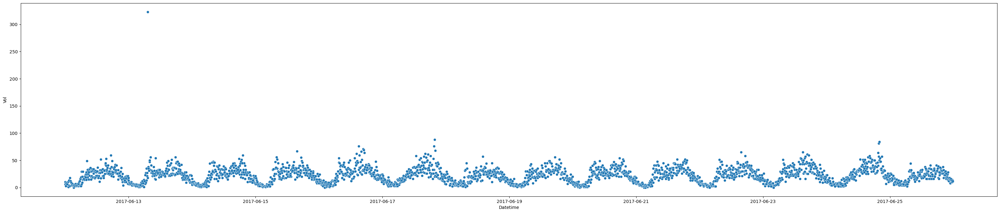

Hue: {'SegmentID': 31765, 'Direction': 'WB'}


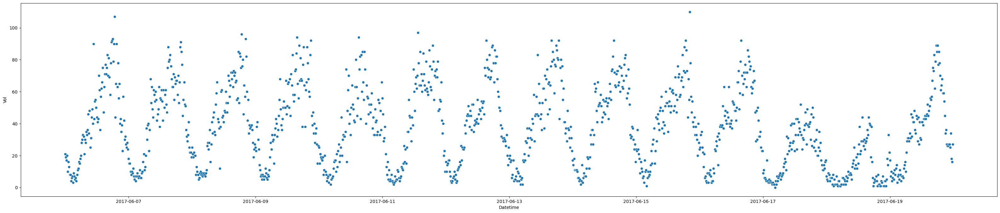

Hue: {'SegmentID': 43630, 'Direction': 'NB'}


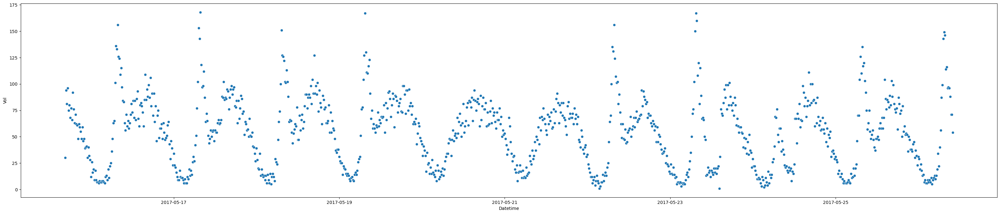

Hue: {'SegmentID': 86340, 'Direction': 'WB'}


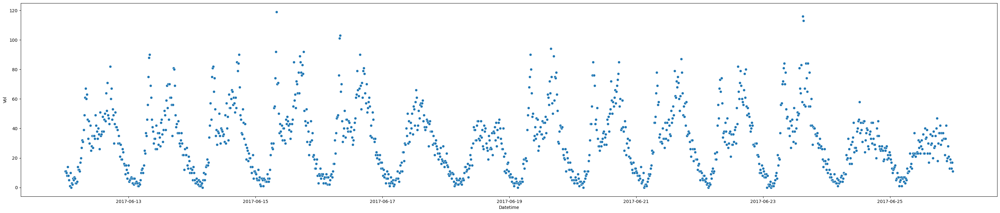

Hue: {'SegmentID': 161527, 'Direction': 'EB'}


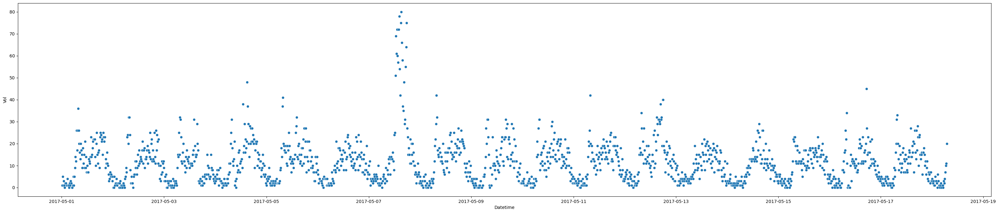

Hue: {'SegmentID': 266710, 'Direction': 'SB'}


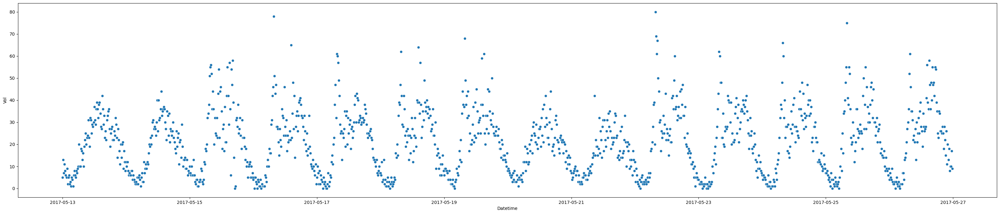

Hue: {'SegmentID': 7847, 'Direction': 'EB'}


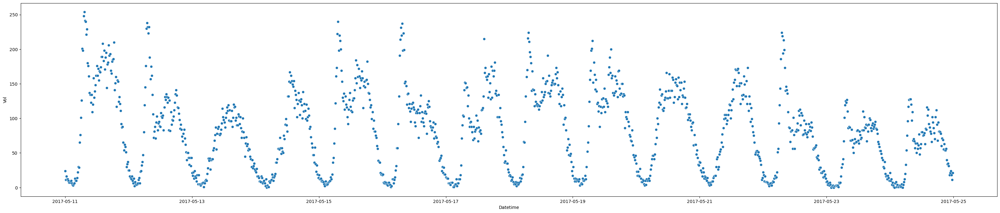

Hue: {'SegmentID': 15995, 'Direction': 'SB'}


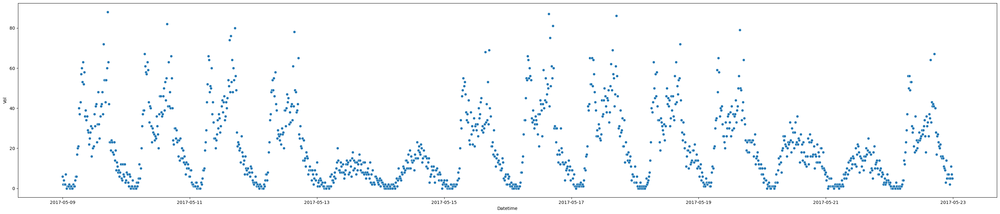

Hue: {'SegmentID': 190592, 'Direction': 'WB'}


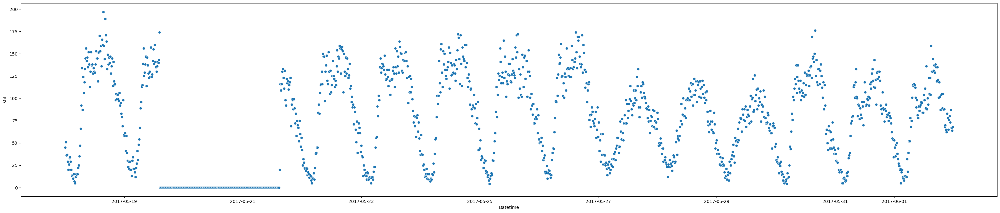

Hue: {'SegmentID': 28382, 'Direction': 'SB'}


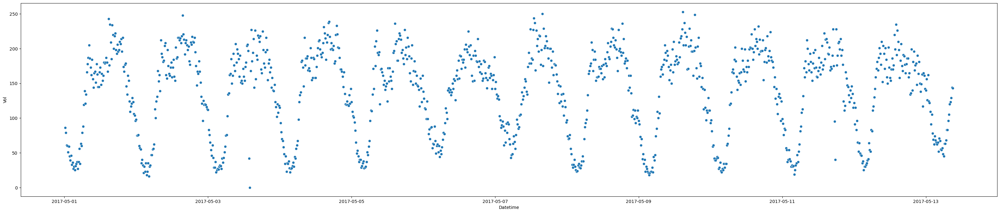

Hue: {'SegmentID': 9009313, 'Direction': 'SB'}


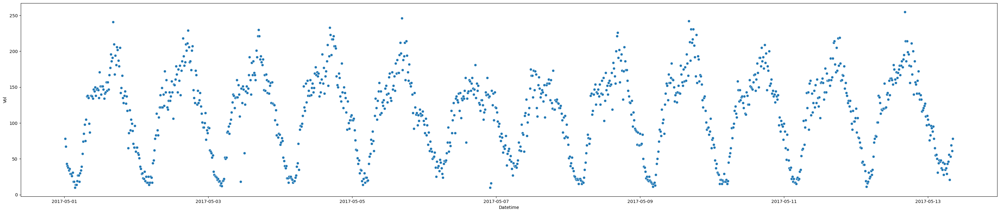

Hue: {'SegmentID': 24223, 'Direction': 'SB'}


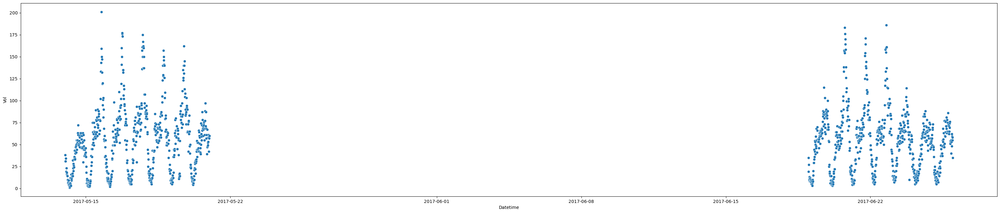

Hue: {'SegmentID': 9009270, 'Direction': 'SB'}


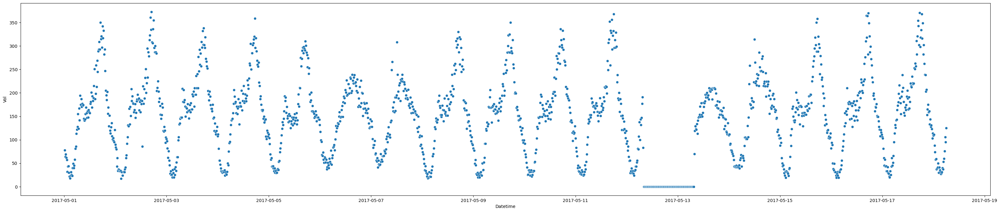

Hue: {'SegmentID': 9009312, 'Direction': 'NB'}


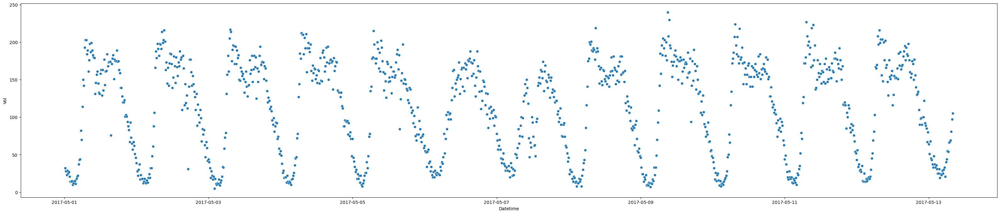

Hue: {'SegmentID': 67932, 'Direction': 'EB'}


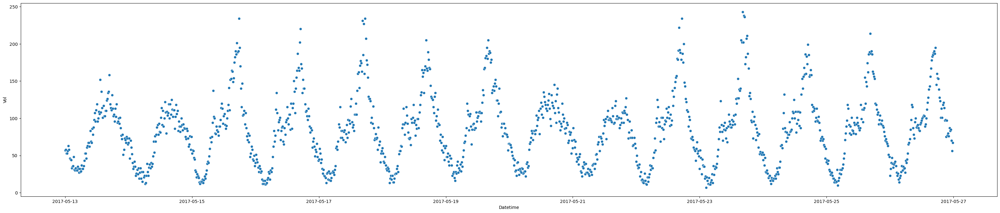

Hue: {'SegmentID': 7648, 'Direction': 'EB'}


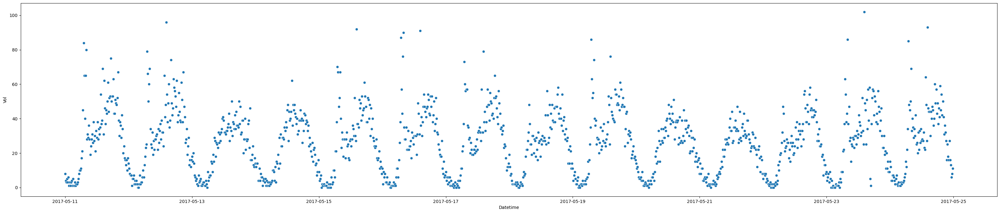

Hue: {'SegmentID': 14820, 'Direction': 'NB'}


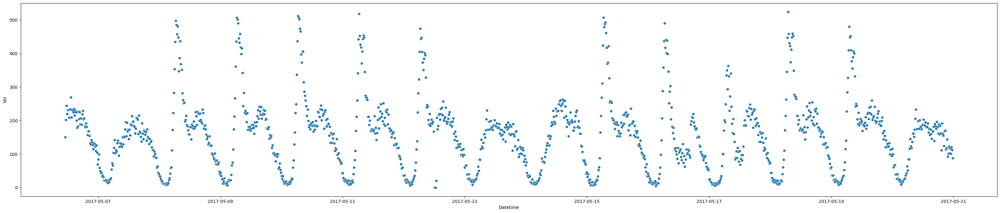

Hue: {'SegmentID': 163632, 'Direction': 'WB'}


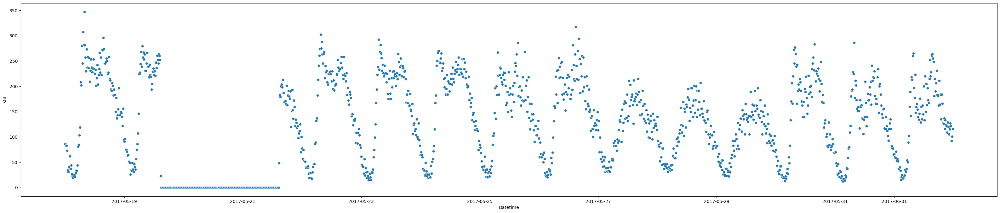

Hue: {'SegmentID': 41652, 'Direction': 'SB'}


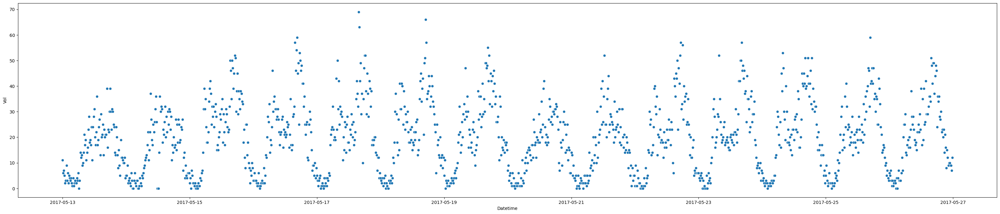

Hue: {'SegmentID': 258969, 'Direction': 'NB'}


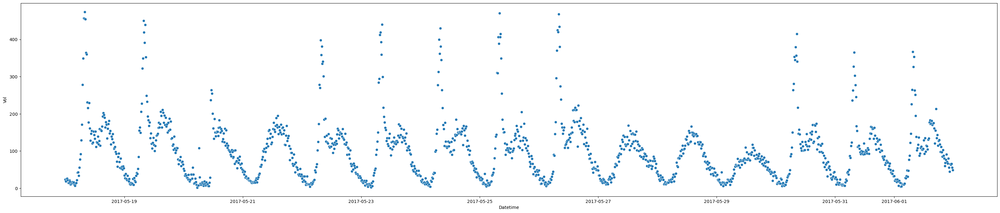

Hue: {'SegmentID': 67846, 'Direction': 'SB'}


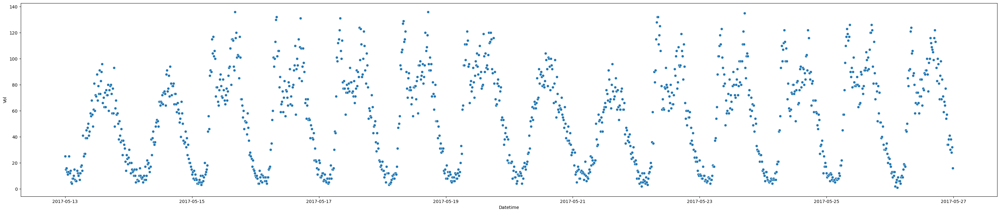

Hue: {'SegmentID': 70542, 'Direction': 'EB'}


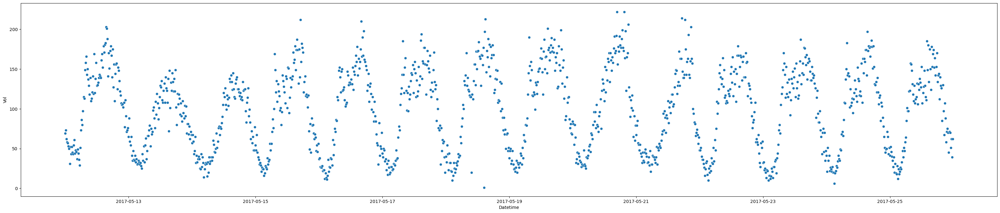

Hue: {'SegmentID': 86055, 'Direction': 'NB'}


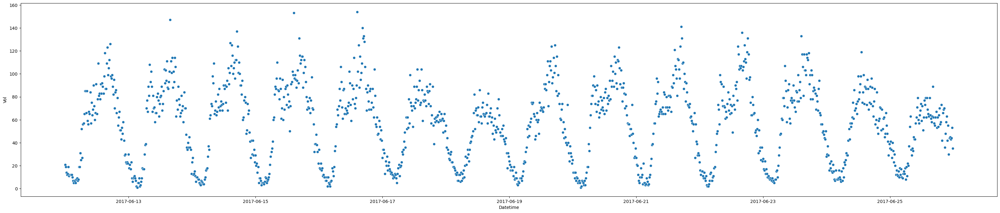

Hue: {'SegmentID': 87446, 'Direction': 'WB'}


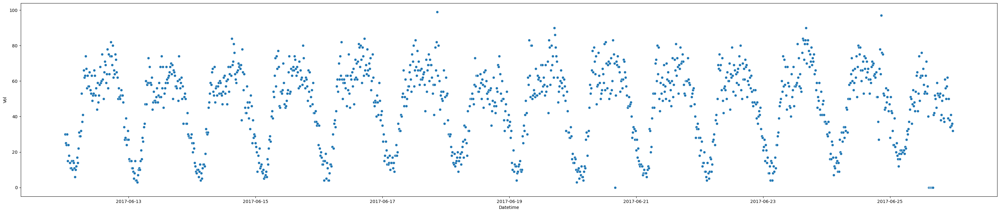

Hue: {'SegmentID': 23257, 'Direction': 'SB'}


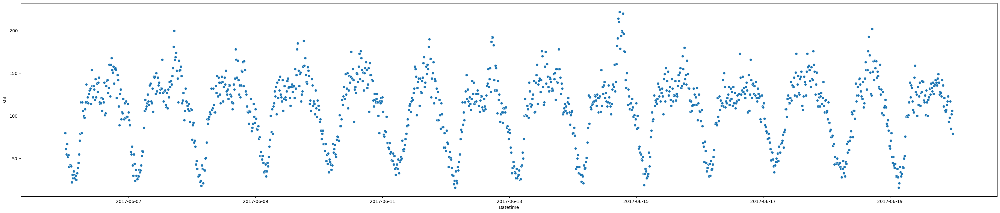

Hue: {'SegmentID': 109171, 'Direction': 'NB'}


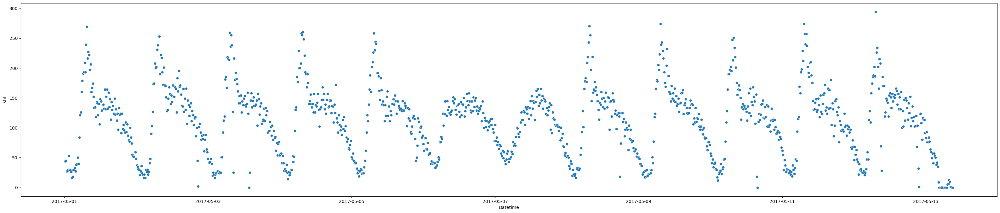

Hue: {'SegmentID': 113977, 'Direction': 'NB'}


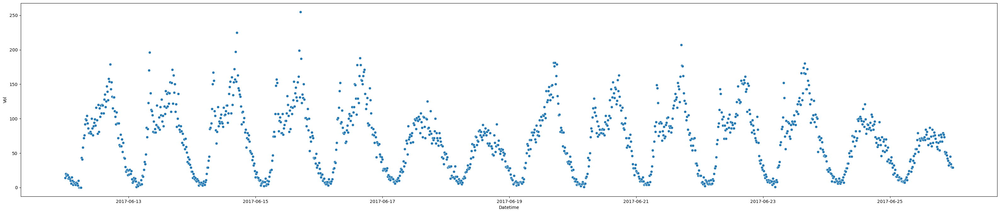

Hue: {'SegmentID': 163723, 'Direction': 'NB'}


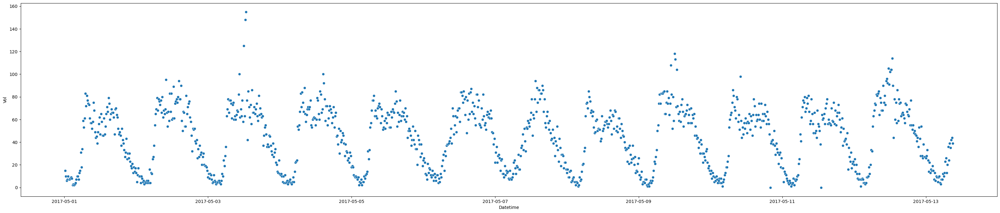

Hue: {'SegmentID': 163648, 'Direction': 'WB'}


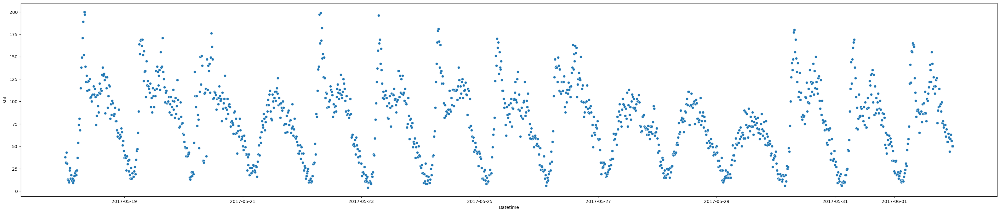

Hue: {'SegmentID': 109856, 'Direction': 'NB'}


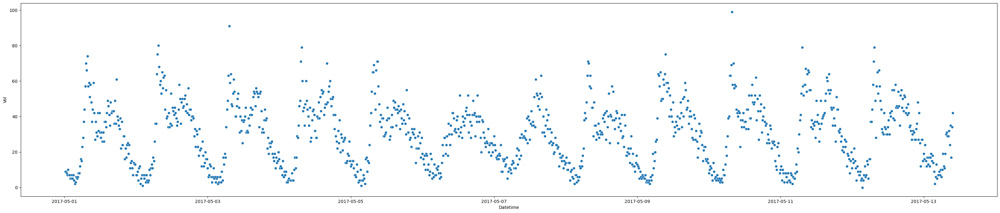

Hue: {'SegmentID': 188023, 'Direction': 'NB'}


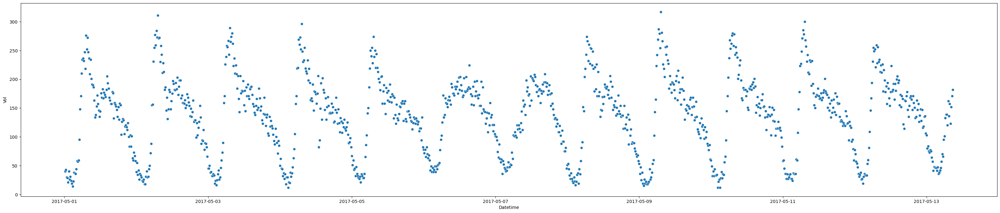

Hue: {'SegmentID': 14820, 'Direction': 'SB'}


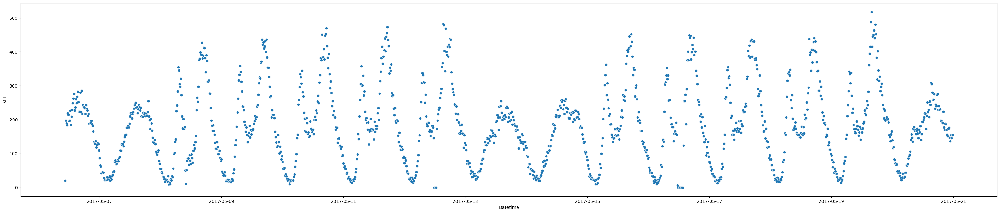

Hue: {'SegmentID': 122466, 'Direction': 'SB'}


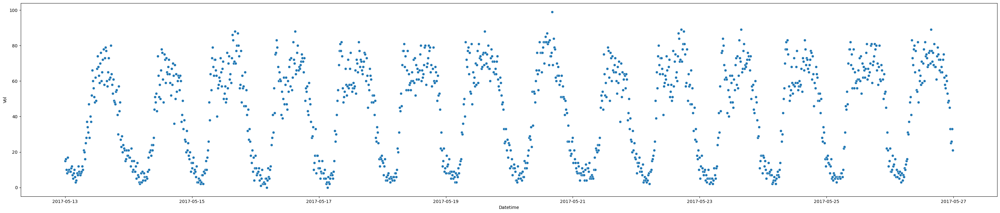

Hue: {'SegmentID': 31558, 'Direction': 'EB'}


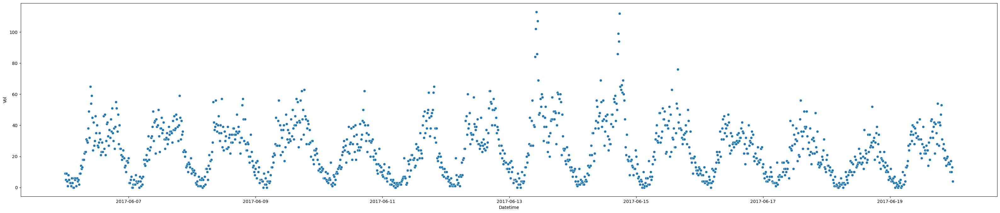

Hue: {'SegmentID': 258946, 'Direction': 'SB'}


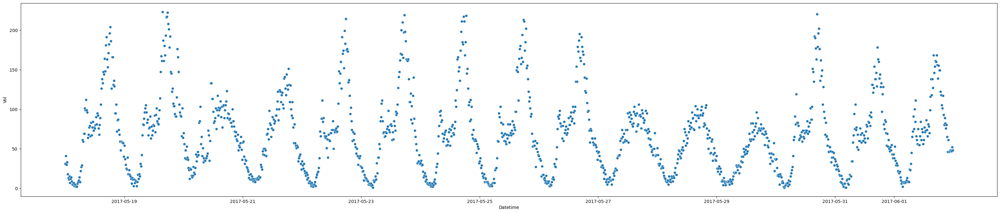

Hue: {'SegmentID': 67487, 'Direction': 'EB'}


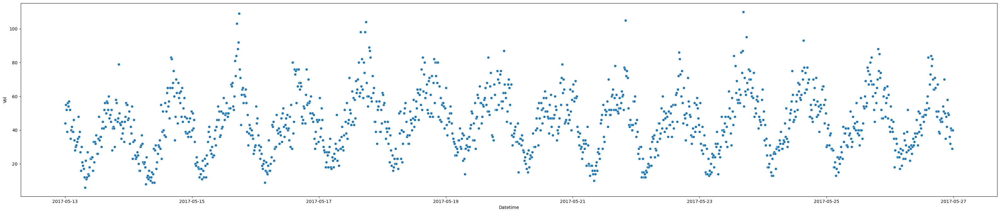

Hue: {'SegmentID': 86336, 'Direction': 'WB'}


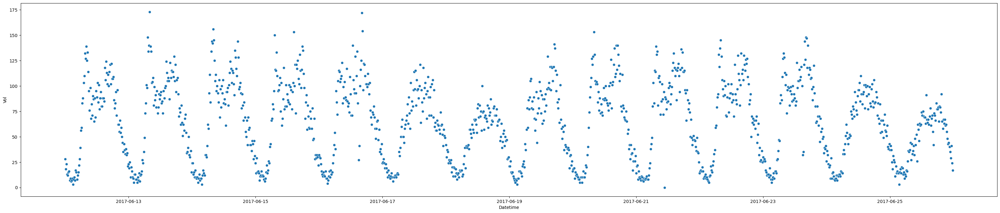

Hue: {'SegmentID': 85916, 'Direction': 'NB'}


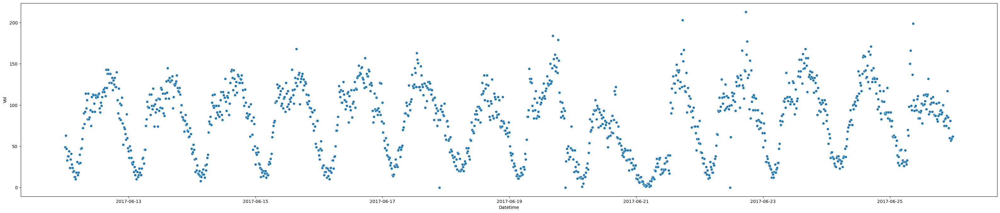

Hue: {'SegmentID': 86486, 'Direction': 'SB'}


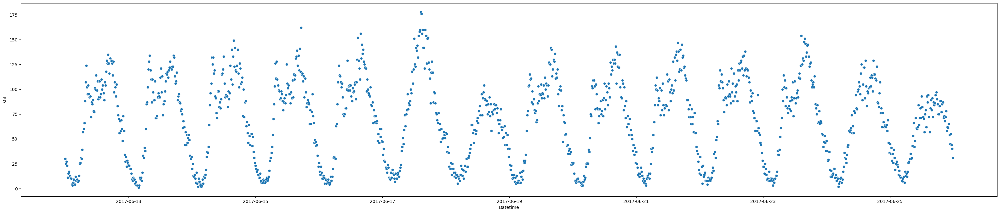

Hue: {'SegmentID': 87459, 'Direction': 'NB'}


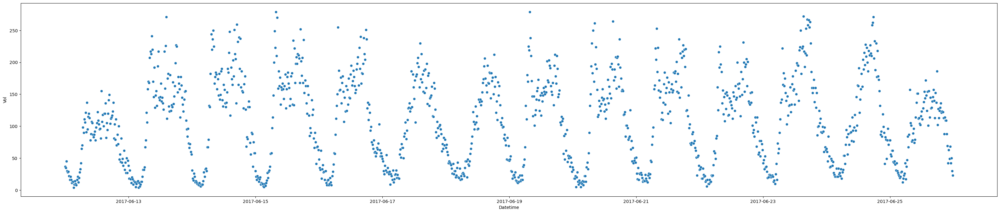

Hue: {'SegmentID': 163652, 'Direction': 'WB'}


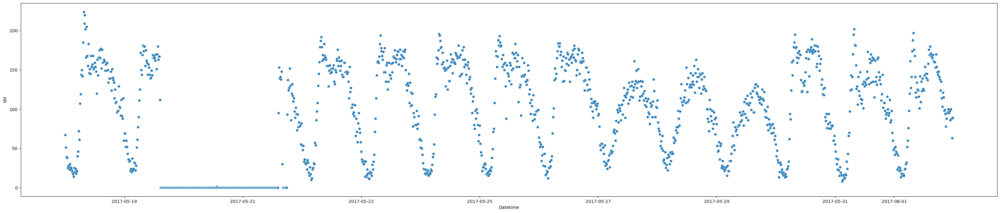

Hue: {'SegmentID': 159723, 'Direction': 'EB'}


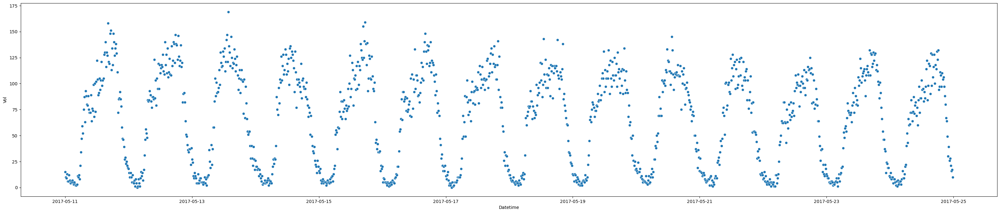

Hue: {'SegmentID': 41646, 'Direction': 'SB'}


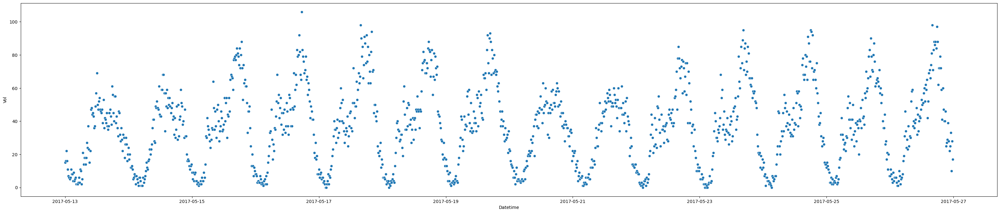

Hue: {'SegmentID': 67619, 'Direction': 'WB'}


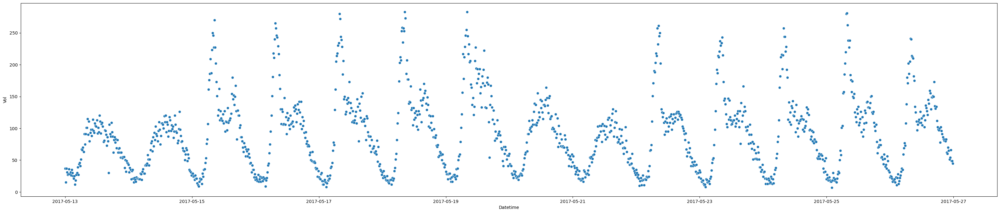

Hue: {'SegmentID': 86040, 'Direction': 'NB'}


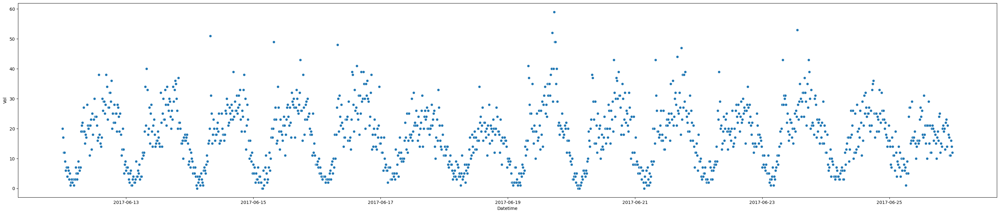

Hue: {'SegmentID': 35745, 'Direction': 'WB'}


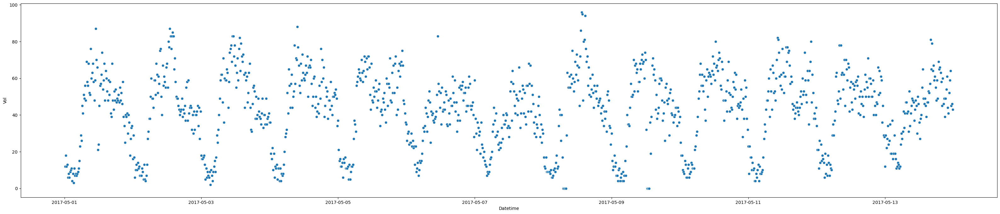

Hue: {'SegmentID': 45945, 'Direction': 'NB'}


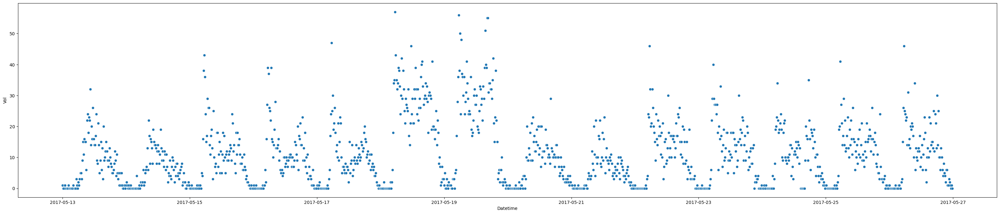

Hue: {'SegmentID': 41646, 'Direction': 'NB'}


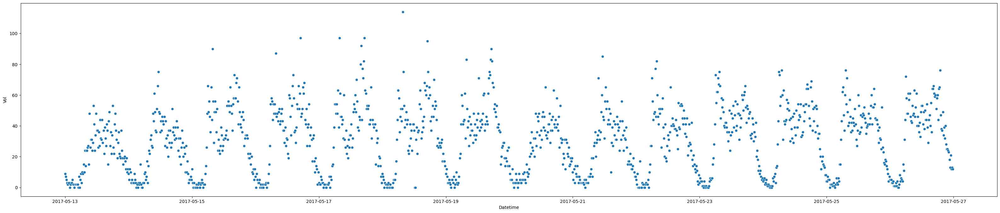

Hue: {'SegmentID': 160666, 'Direction': 'SB'}


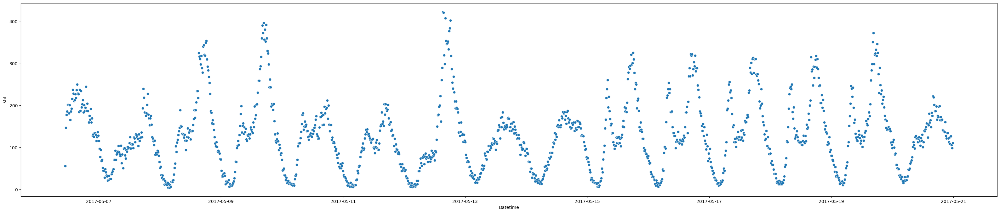

Hue: {'SegmentID': 27929, 'Direction': 'NB'}


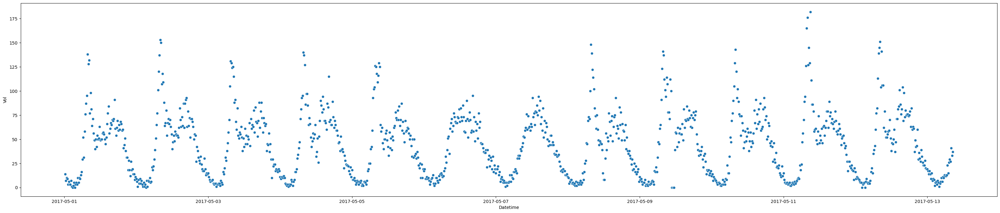

Hue: {'SegmentID': 86065, 'Direction': 'WB'}


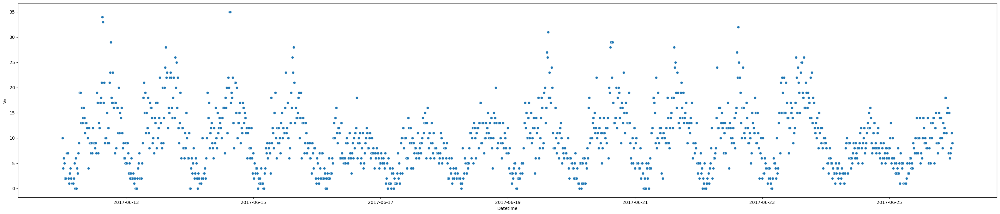

Hue: {'SegmentID': 86219, 'Direction': 'EB'}


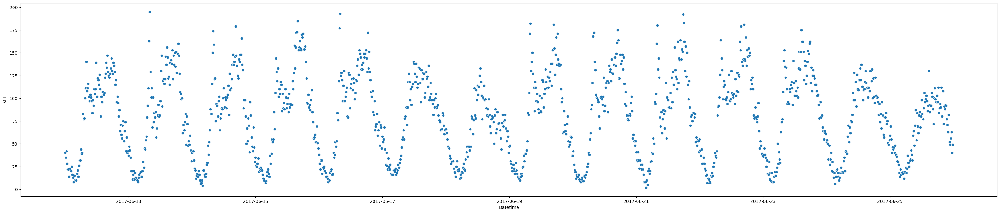

Hue: {'SegmentID': 251715, 'Direction': 'WB'}


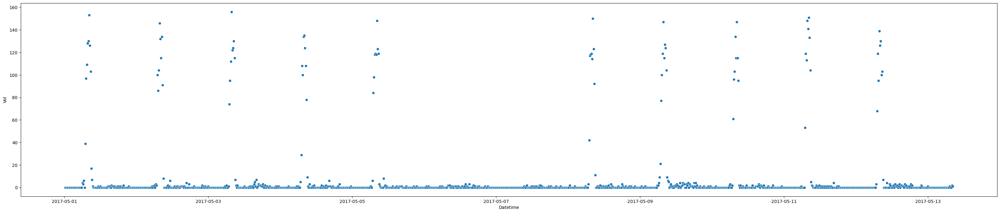

Hue: {'SegmentID': 23393, 'Direction': 'WB'}


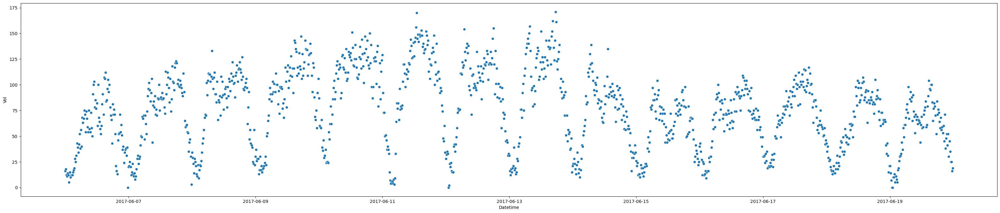

Hue: {'SegmentID': 28250, 'Direction': 'EB'}


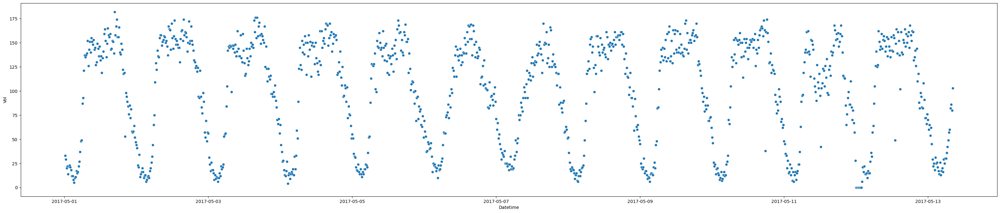

Hue: {'SegmentID': 35765, 'Direction': 'EB'}


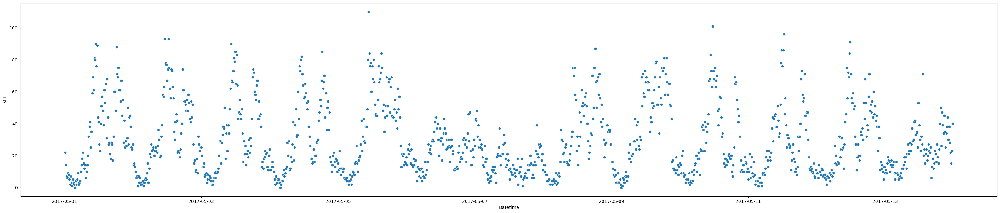

Hue: {'SegmentID': 68172, 'Direction': 'EB'}


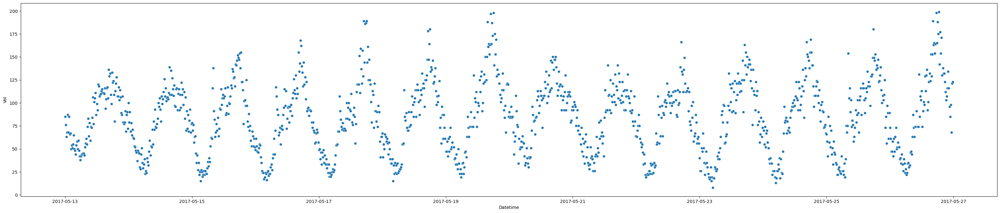

Hue: {'SegmentID': 28261, 'Direction': 'WB'}


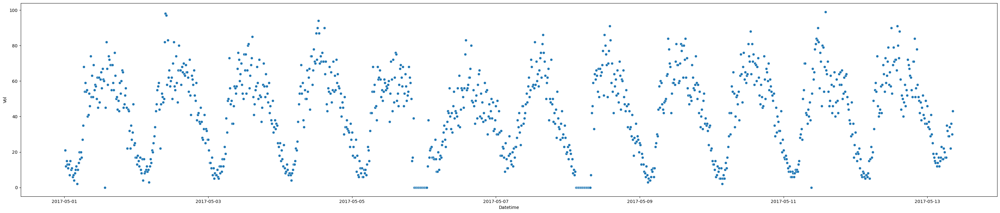

Hue: {'SegmentID': 87447, 'Direction': 'NB'}


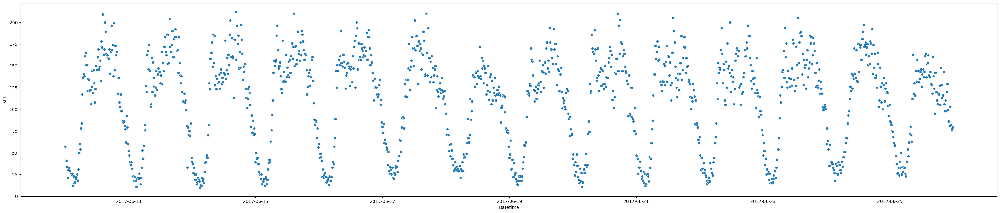

Hue: {'SegmentID': 31789, 'Direction': 'SB'}


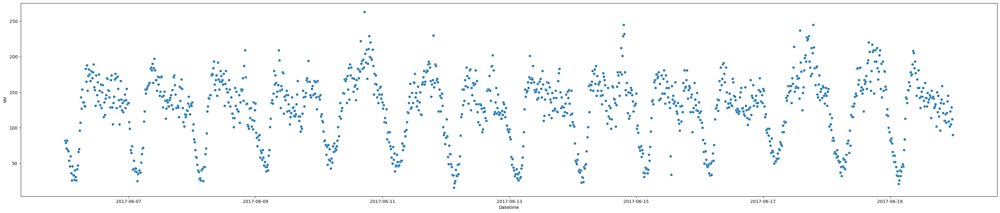

Hue: {'SegmentID': 85914, 'Direction': 'SB'}


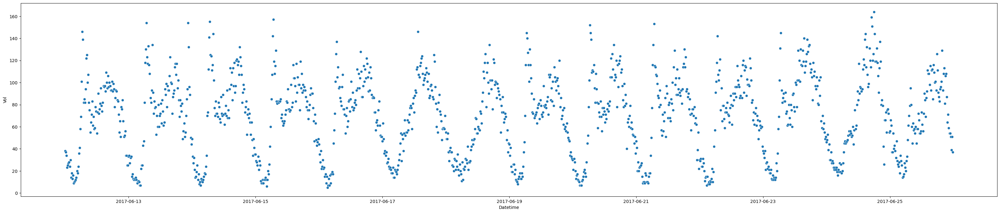

Hue: {'SegmentID': 68048, 'Direction': 'EB'}


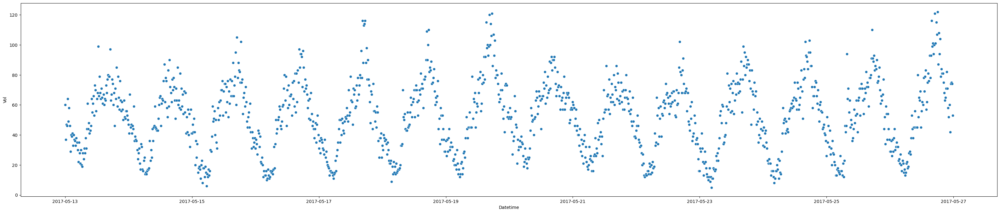

Hue: {'SegmentID': 27789, 'Direction': 'NB'}


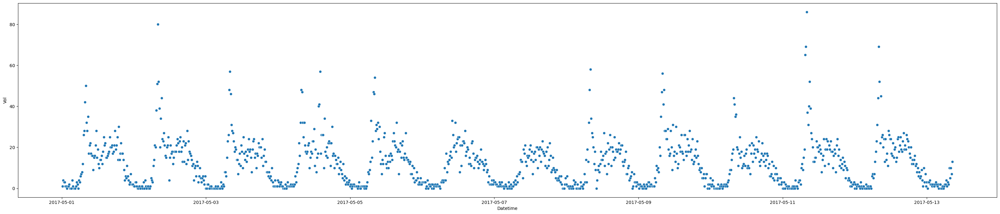

Hue: {'SegmentID': 16025, 'Direction': 'EB'}


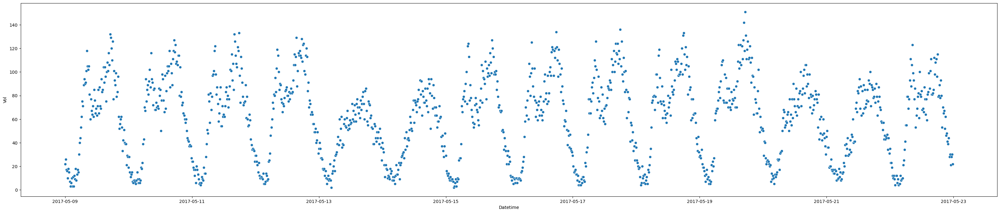

Hue: {'SegmentID': 86064, 'Direction': 'SB'}


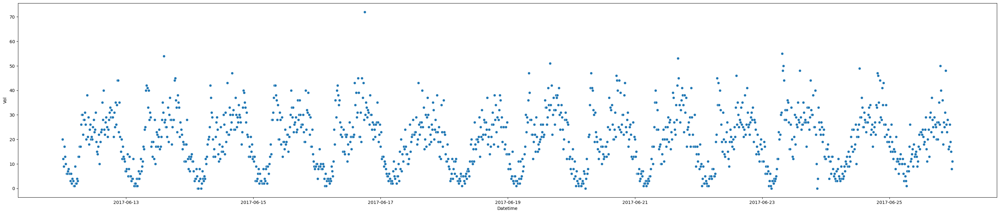

Hue: {'SegmentID': 67724, 'Direction': 'WB'}


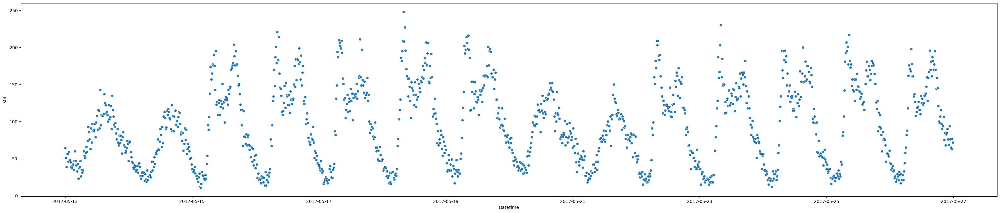

Hue: {'SegmentID': 86462, 'Direction': 'NB'}


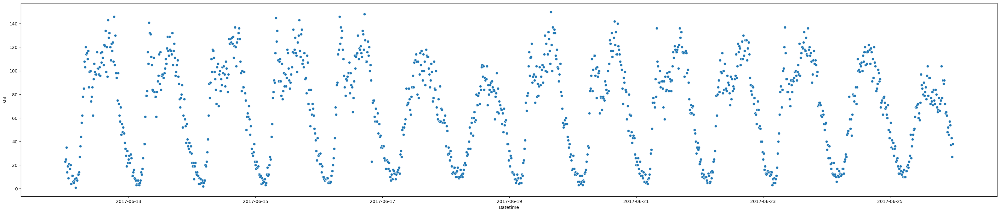

Hue: {'SegmentID': 86053, 'Direction': 'NB'}


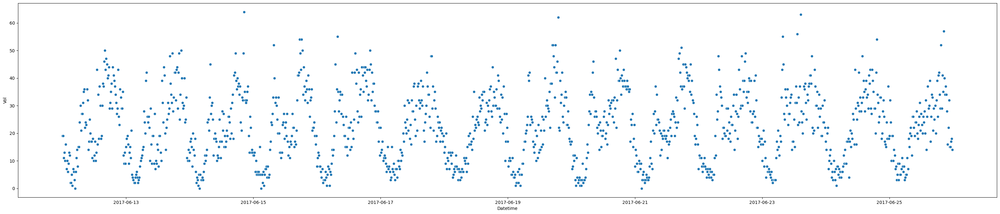

Hue: {'SegmentID': 160666, 'Direction': 'NB'}


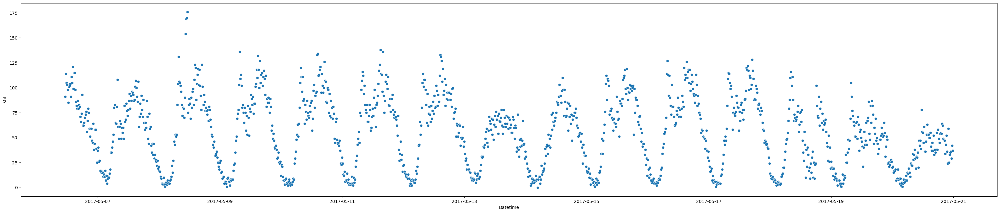

Hue: {'SegmentID': 28276, 'Direction': 'EB'}


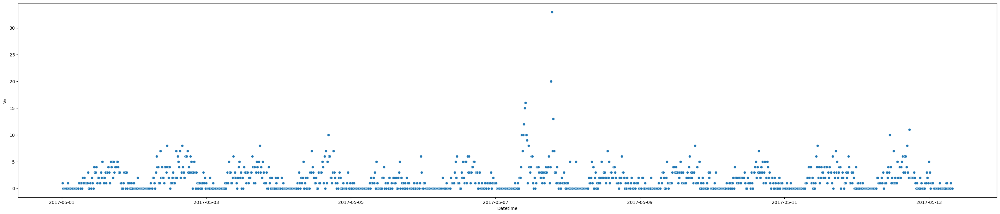

Hue: {'SegmentID': 172610, 'Direction': 'NB'}


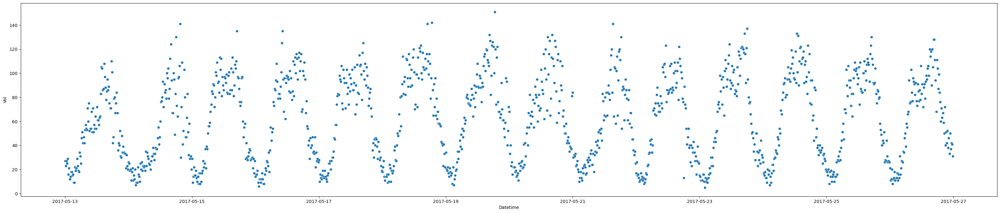

Hue: {'SegmentID': 262241, 'Direction': 'SB'}


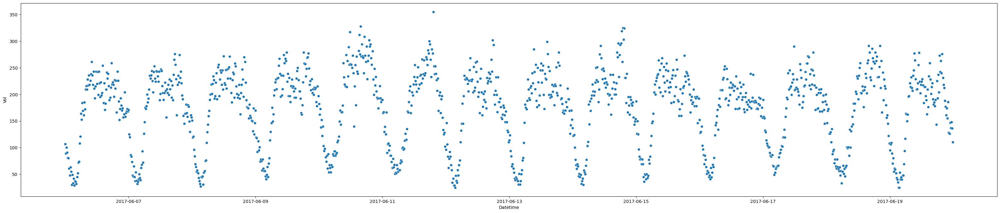

Hue: {'SegmentID': 35747, 'Direction': 'WB'}


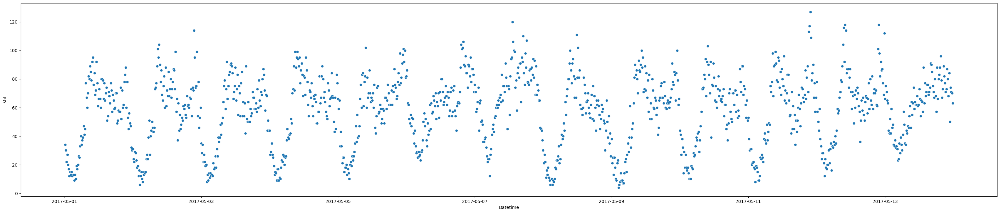

Hue: {'SegmentID': 258930, 'Direction': 'NB'}


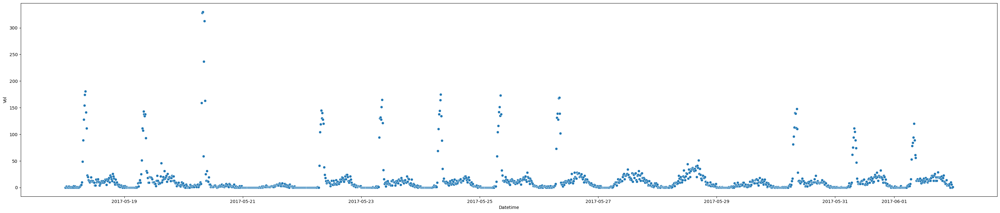

Hue: {'SegmentID': 191130, 'Direction': 'EB'}


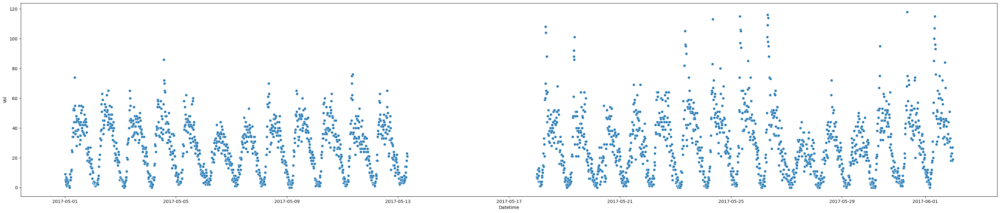

Hue: {'SegmentID': 86230, 'Direction': 'SB'}


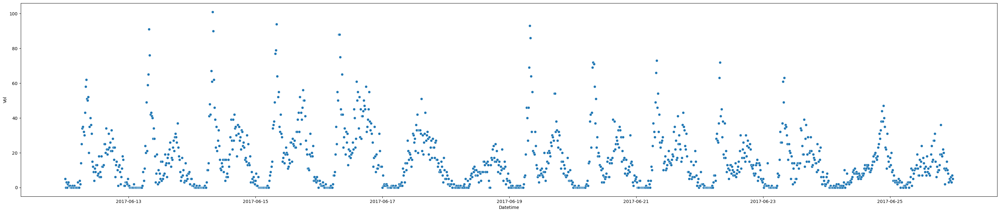

Hue: {'SegmentID': 21422, 'Direction': 'WB'}


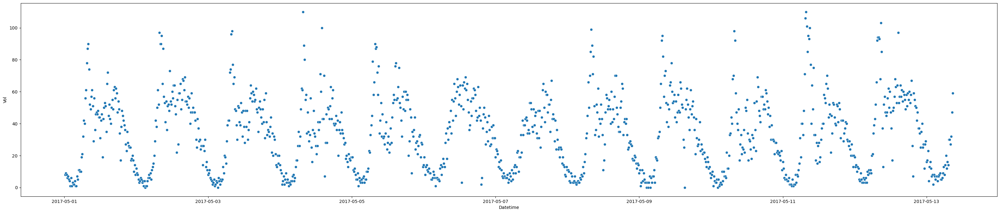

Hue: {'SegmentID': 167268, 'Direction': 'SB'}


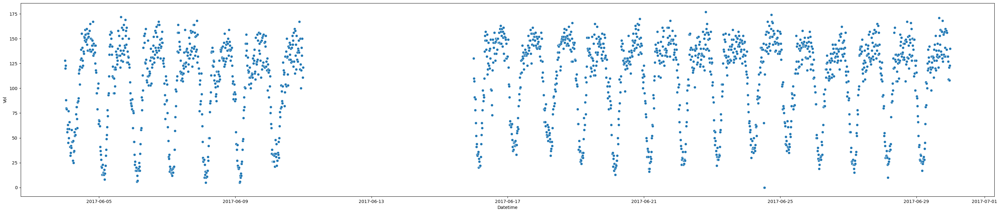

Hue: {'SegmentID': 67615, 'Direction': 'EB'}


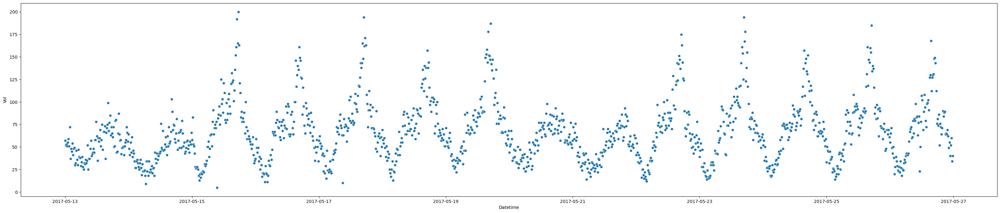

Hue: {'SegmentID': 68052, 'Direction': 'WB'}


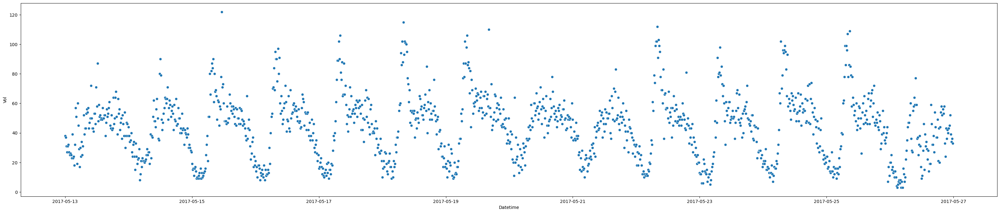

Hue: {'SegmentID': 29283, 'Direction': 'SB'}


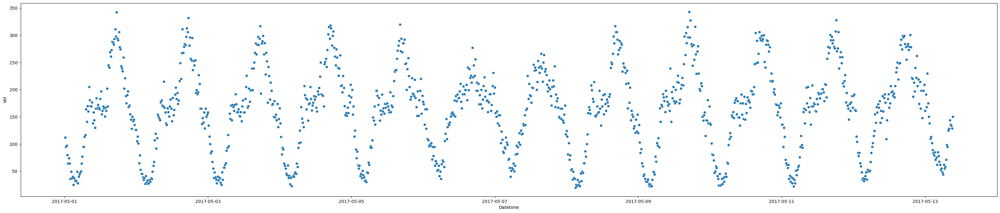

Hue: {'SegmentID': 29279, 'Direction': 'WB'}


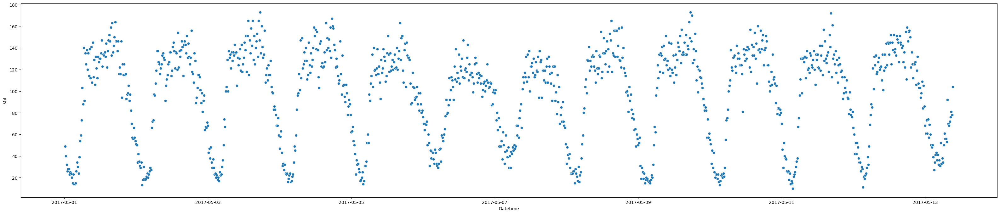

Hue: {'SegmentID': 258848, 'Direction': 'NB'}


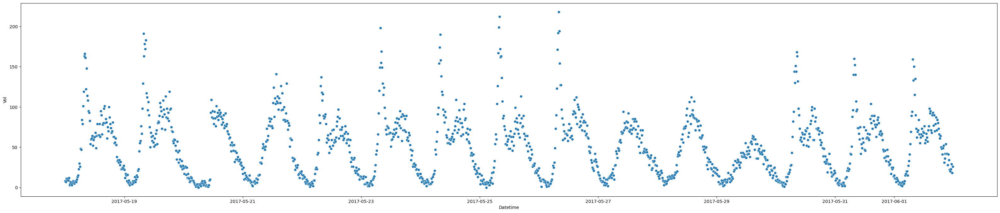

Hue: {'SegmentID': 266714, 'Direction': 'WB'}


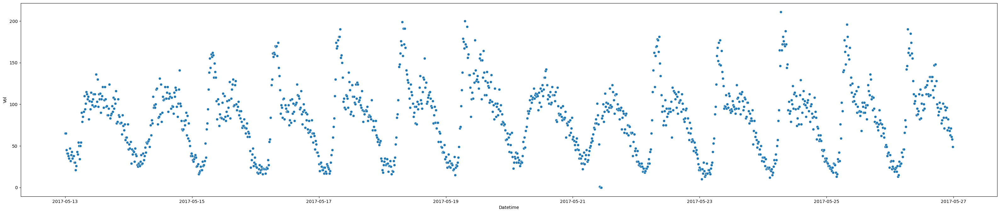

Hue: {'SegmentID': 67834, 'Direction': 'WB'}


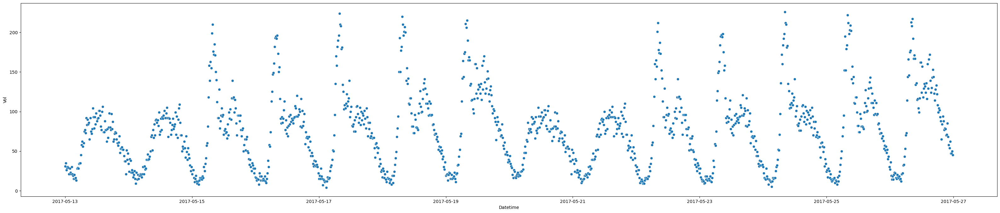

Hue: {'SegmentID': 86491, 'Direction': 'WB'}


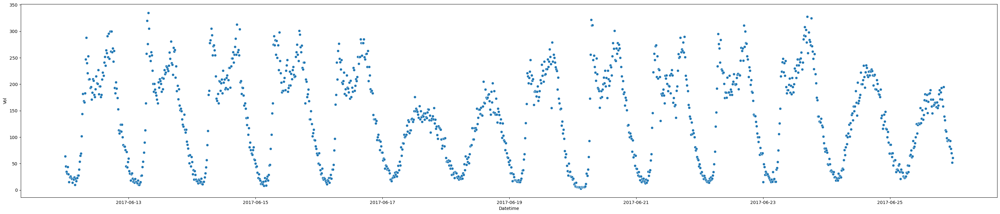

Hue: {'SegmentID': 67946, 'Direction': 'WB'}


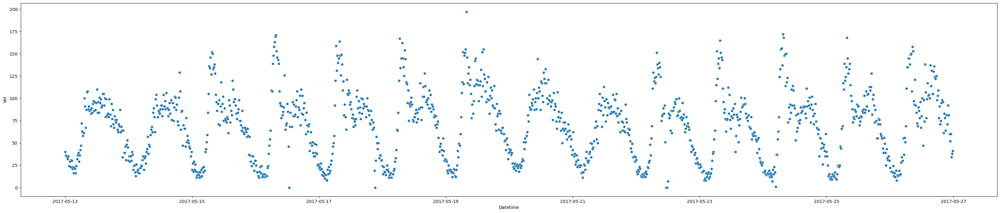

Hue: {'SegmentID': 70545, 'Direction': 'WB'}


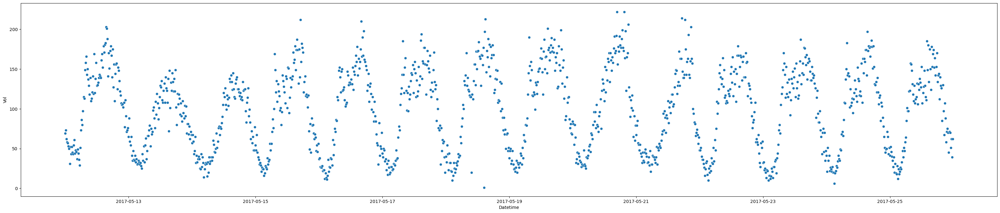

Hue: {'SegmentID': 148398, 'Direction': 'WB'}


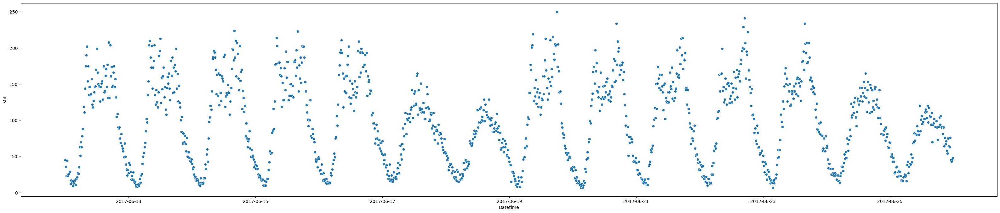

Hue: {'SegmentID': 17876, 'Direction': 'NB'}


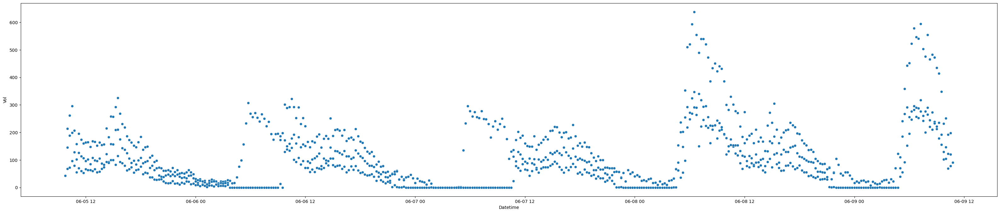

Hue: {'SegmentID': 27918, 'Direction': 'SB'}


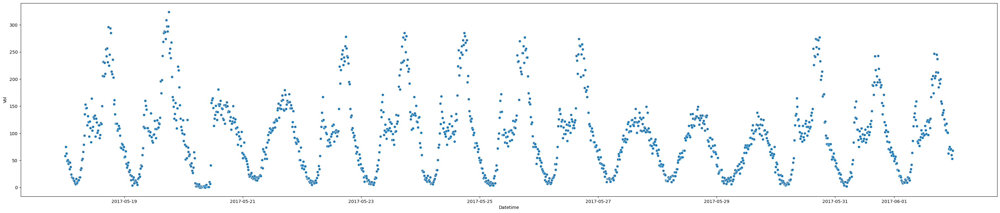

Hue: {'SegmentID': 219641, 'Direction': 'SB'}


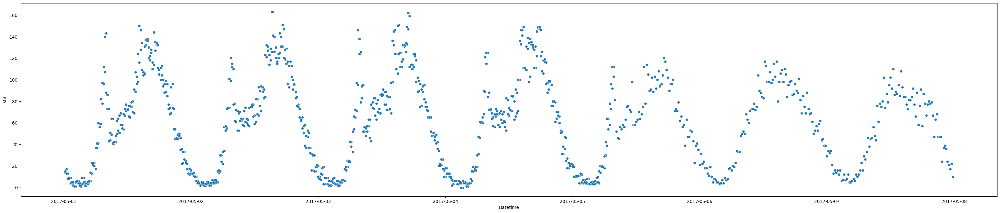

Hue: {'SegmentID': 68050, 'Direction': 'EB'}


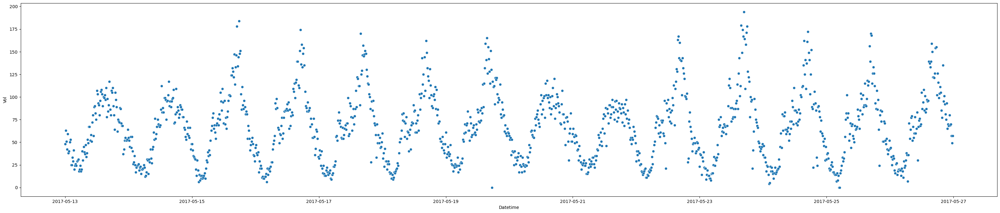

Hue: {'SegmentID': 28377, 'Direction': 'EB'}


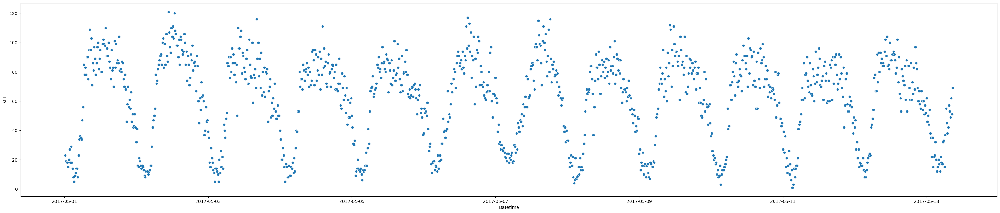

Hue: {'SegmentID': 150372, 'Direction': 'NB'}


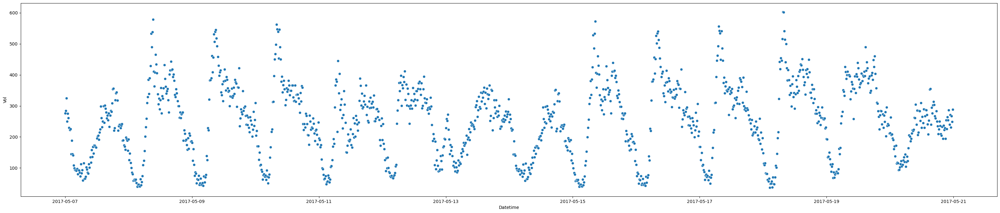

Hue: {'SegmentID': 43361, 'Direction': 'SB'}


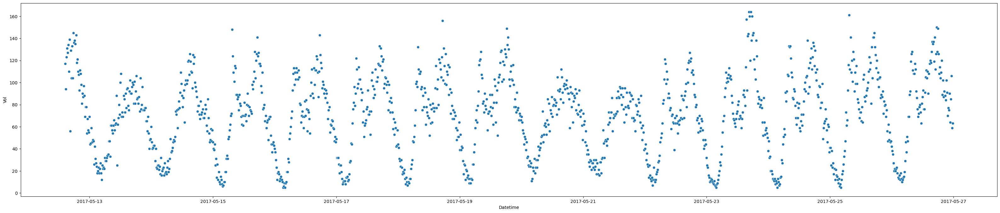

Hue: {'SegmentID': 29277, 'Direction': 'NB'}


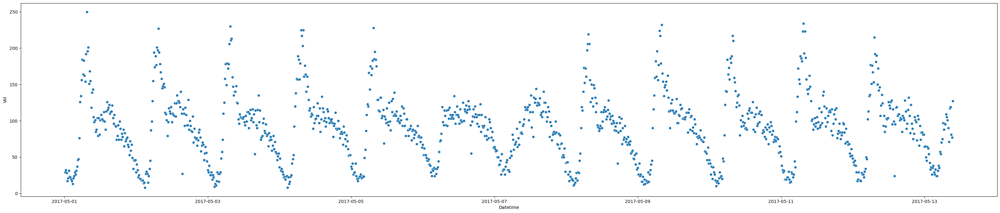

Hue: {'SegmentID': 67713, 'Direction': 'EB'}


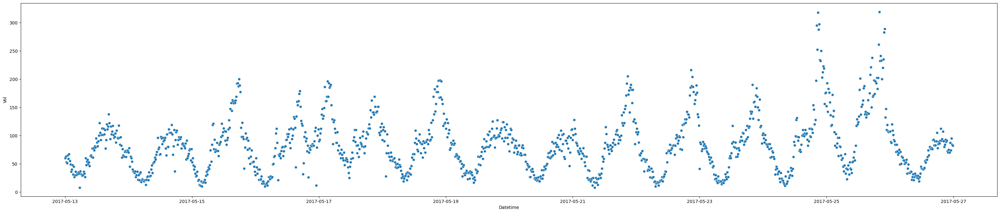

Hue: {'SegmentID': 151648, 'Direction': 'NB'}


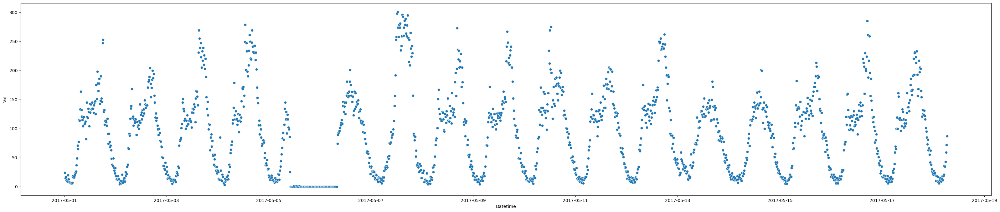

Hue: {'SegmentID': 35880, 'Direction': 'SB'}


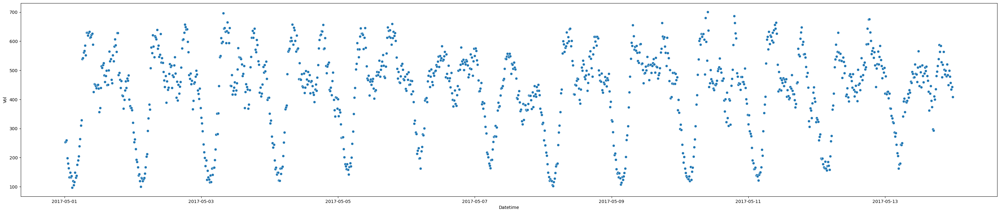

Hue: {'SegmentID': 172648, 'Direction': 'NB'}


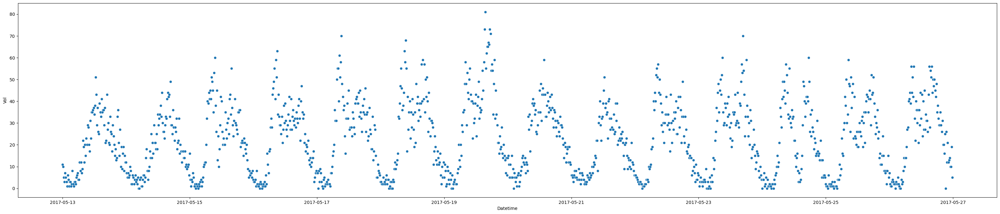

Hue: {'SegmentID': 157494, 'Direction': 'NB'}


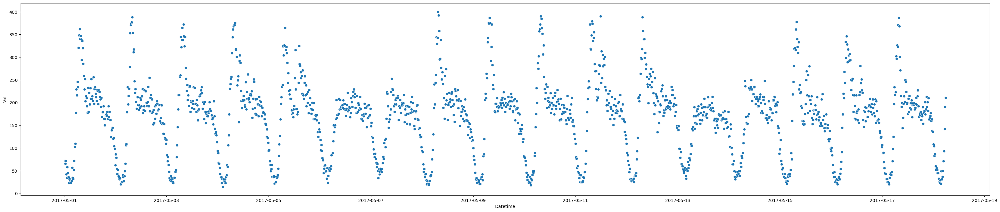

Hue: {'SegmentID': 191563, 'Direction': 'EB'}


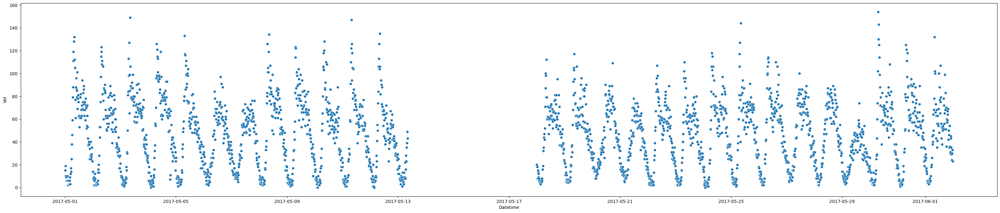

Hue: {'SegmentID': 45950, 'Direction': 'SB'}


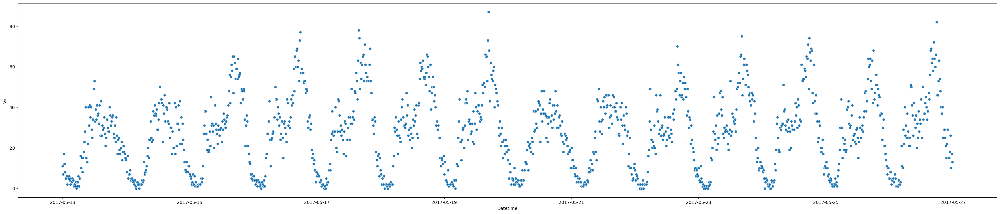

Hue: {'SegmentID': 35742, 'Direction': 'EB'}


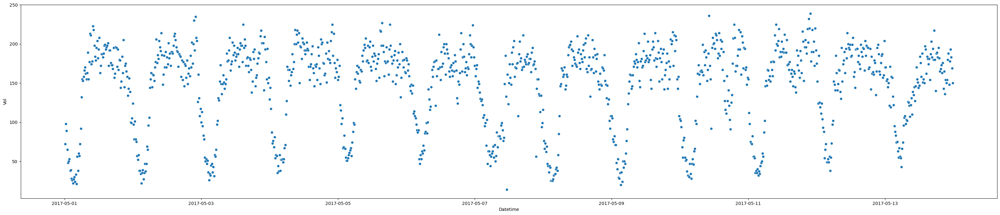

Hue: {'SegmentID': 16025, 'Direction': 'WB'}


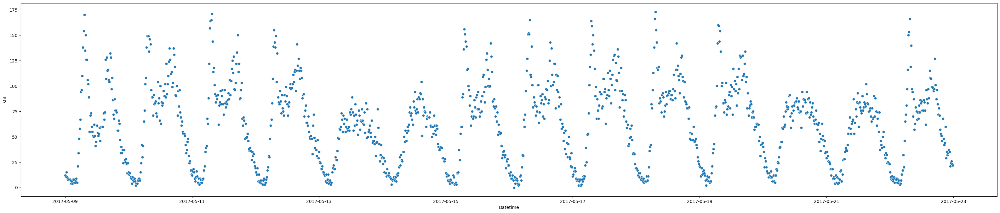

Hue: {'SegmentID': 172632, 'Direction': 'NB'}


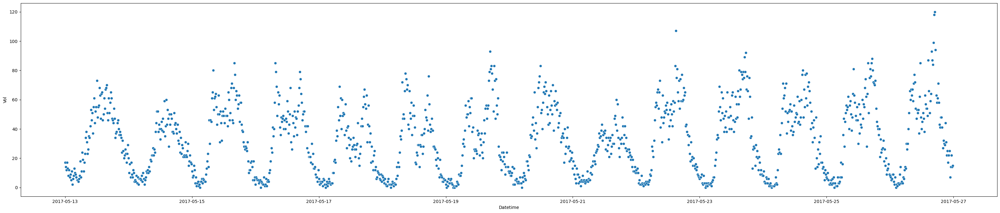

Hue: {'SegmentID': 45950, 'Direction': 'NB'}


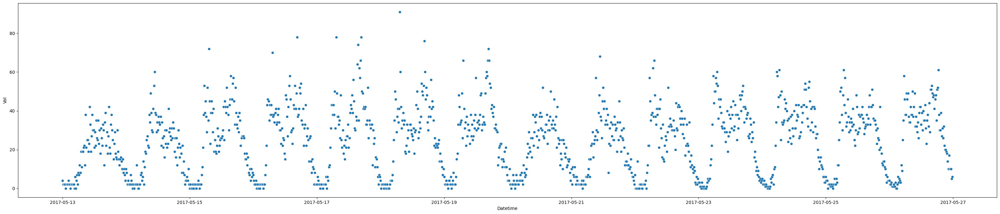

Hue: {'SegmentID': 15995, 'Direction': 'NB'}


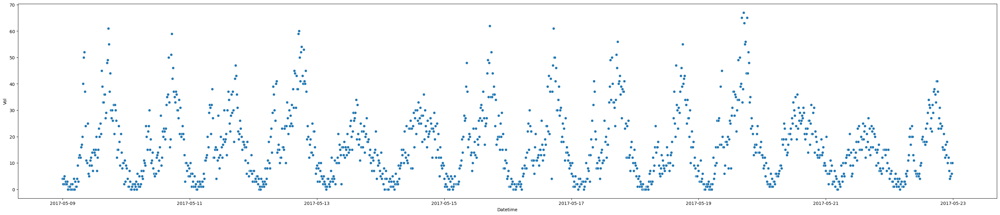

Hue: {'SegmentID': 9002032, 'Direction': 'NB'}


ERROR:root:KeyboardInterrupt while sending command.
Traceback (most recent call last):
  File "C:\Users\le197\anaconda3\Lib\site-packages\py4j\java_gateway.py", line 1038, in send_command
    response = connection.send_command(command)
               ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\le197\anaconda3\Lib\site-packages\py4j\clientserver.py", line 511, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
                          ^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\le197\anaconda3\Lib\socket.py", line 706, in readinto
    return self._sock.recv_into(b)
           ^^^^^^^^^^^^^^^^^^^^^^^
KeyboardInterrupt


KeyboardInterrupt: 

In [53]:
create_scatterplots(df_2017_0506_with_filter.filter(F.col('SegmentID').isin(*[segmentID for segmentID, _ in segmentIDs])), 'Datetime', 'Vol', ['SegmentID', 'Direction'])

<Axes: xlabel='Date', ylabel='count'>

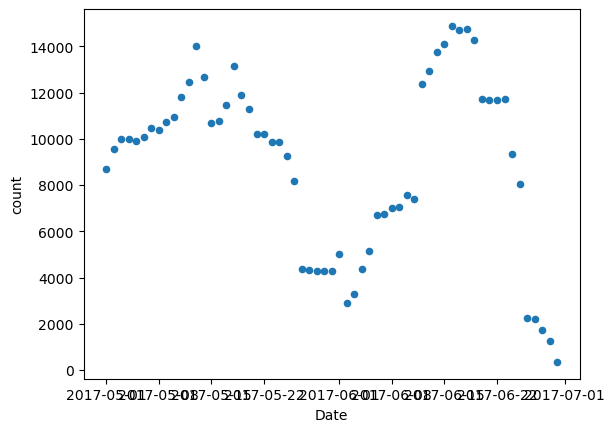

In [60]:
df_2017_0506_with_filter.filter(
    F.col('SegmentID').isin(
        *[segmentID for segmentID, _ in segmentIDs]
    )
).groupBy(
    'Yr', 'M', 'D'
).count().withColumn(
    'Date', F.concat_ws('-', F.col('Yr'), F.col('M'), F.col('D')).cast('Timestamp')
).toPandas().plot.scatter(x='Date', y='count')

In [63]:
df_2017_0506_with_filter.filter(
    (F.col('Datetime') > '2017-06-13') & \
    (F.col('Datetime') <= '2017-06-21')
).groupBy('SegmentID', 'Direction').count().show()

+---------+---------+-----+
|SegmentID|Direction|count|
+---------+---------+-----+
|    85918|       SB| 1536|
|    31765|       WB|  671|
|    86340|       WB|  768|
|    48650|       EB|  161|
|    45286|       EB|  168|
|   271269|       SB|  479|
|    49206|       NB|  326|
|    86055|       NB|  768|
|    12499|       EB|  318|
|    87446|       WB|  768|
|    23257|       SB|  671|
|    32102|       EB|  383|
|   113977|       NB|  768|
|   110915|       NB|  383|
|    27935|       NB|  630|
|   115148|       EB|  156|
|    27794|       WB|  315|
|    31558|       EB|  671|
|    19900|       SB|  325|
|    19773|       EB|  325|
+---------+---------+-----+
only showing top 20 rows



In [67]:
df_2017_0506_with_filter.filter(
    (F.col('Datetime') > '2017-06-13') & \
    (F.col('Datetime') <= '2017-06-21')
).groupBy('SegmentID', 'Direction').count().filter(
    F.col('count') >= 768
).count()

80

In [72]:
df_2017_0506_with_filter.filter(
    (F.col('Datetime') > '2017-06-13') & \
    (F.col('Datetime') <= '2017-06-21')
).groupBy('SegmentID', 'Direction').count().filter(
    F.col('count') >= 768
).drop('count').toPandas().to_csv('SegmentID_Direction.csv', header=True, index=False)

In [75]:
df_2017_06_1321 = df_2017_0506_with_filter.filter(
    (F.col('Datetime') > '2017-06-13') & \
    (F.col('Datetime') <= '2017-06-21')
)

In [73]:
segmentID_direction = pd.read_csv('SegmentID_Direction.csv', header=0)

In [74]:
segmentID_direction

,SegmentID,Direction
0,85918,SB
1,86340,WB
2,86055,NB
3,87446,WB
4,113977,NB
...,...,...
75,184079,EB
76,140178,SB
77,39873,SB
78,192731,WB


In [76]:
tmp_df = df_2017_06_1321.filter(
    F.col('SegmentID').isin(*segmentID_direction['SegmentID']) & \
    F.col('Direction').isin(*segmentID_direction['Direction'])
)

In [78]:
tmp_df.show()

+---------+-----+----+---+---+---+---+---+---------+--------------------+------------------+-------------+----------------+---------+-------------------+
|RequestID| Boro|  Yr|  M|  D| HH| MM|Vol|SegmentID|             WktGeom|            street|       fromSt|            toSt|Direction|           Datetime|
+---------+-----+----+---+---+---+---+---+---------+--------------------+------------------+-------------+----------------+---------+-------------------+
|    26015|Bronx|2017|  6| 13|  0| 15| 28|    86462|POINT (1024865.24...|CASTLE HILL AVENUE|Zerega Avenue|Bronxdale Avenue|       NB|2017-06-13 00:15:00|
|    26015|Bronx|2017|  6| 13|  0| 30| 22|    86462|POINT (1024865.24...|CASTLE HILL AVENUE|Zerega Avenue|Bronxdale Avenue|       NB|2017-06-13 00:30:00|
|    26015|Bronx|2017|  6| 13|  0| 45| 29|    86462|POINT (1024865.24...|CASTLE HILL AVENUE|Zerega Avenue|Bronxdale Avenue|       NB|2017-06-13 00:45:00|
|    26015|Bronx|2017|  6| 13|  1|  0| 26|    86462|POINT (1024865.24...|CAS

Hue: {'SegmentID': 85918, 'Direction': 'SB'}


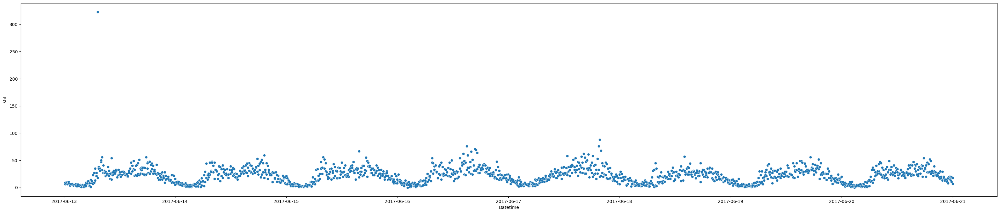

Hue: {'SegmentID': 86340, 'Direction': 'WB'}


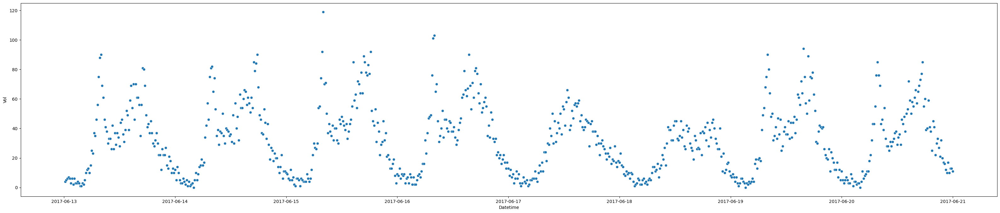

Hue: {'SegmentID': 86055, 'Direction': 'NB'}


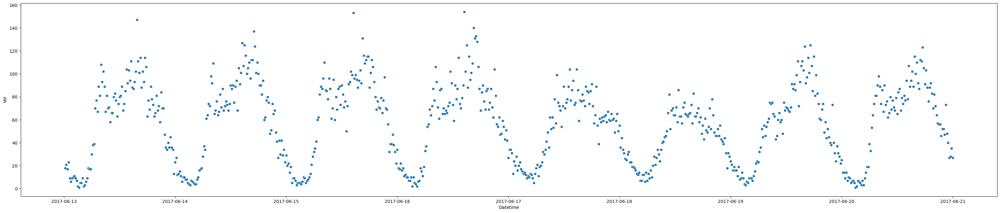

Hue: {'SegmentID': 87446, 'Direction': 'WB'}


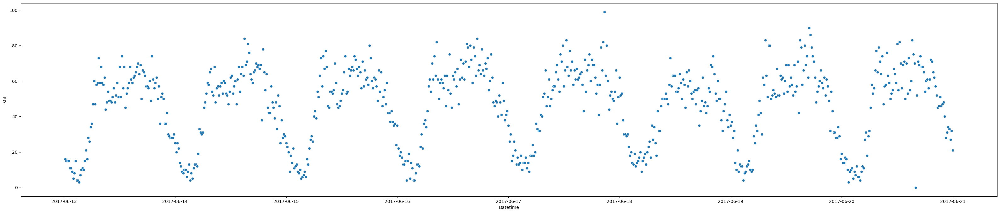

Hue: {'SegmentID': 113977, 'Direction': 'NB'}


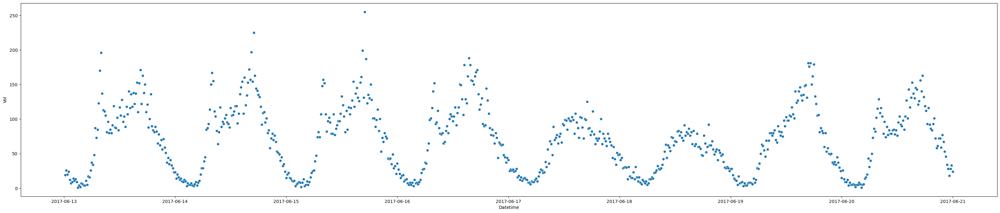

Hue: {'SegmentID': 86336, 'Direction': 'WB'}


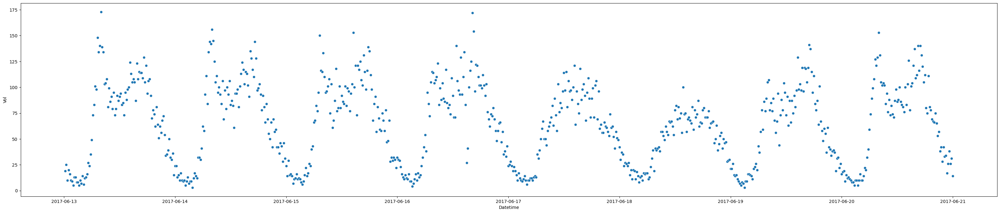

Hue: {'SegmentID': 85916, 'Direction': 'NB'}


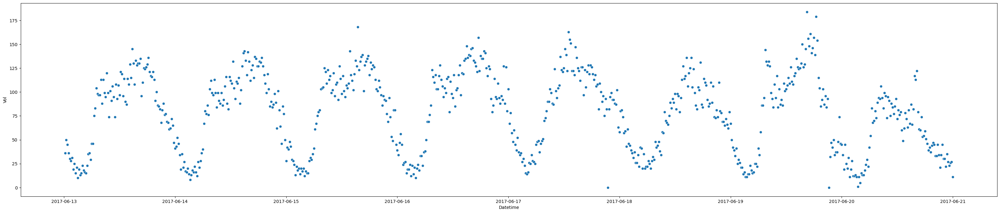

Hue: {'SegmentID': 86486, 'Direction': 'SB'}


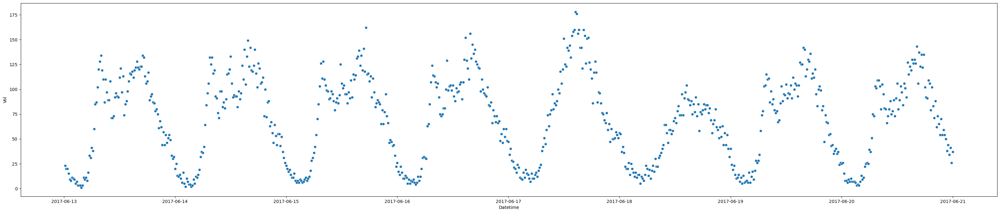

Hue: {'SegmentID': 87459, 'Direction': 'NB'}


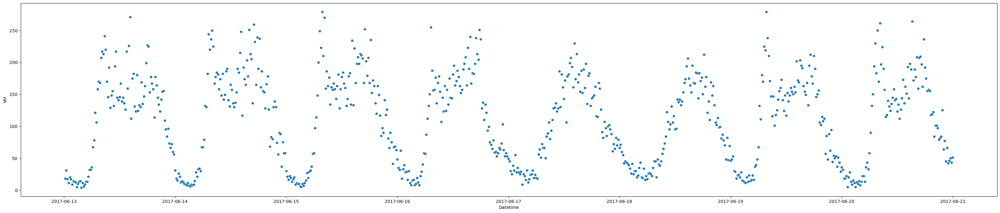

Hue: {'SegmentID': 86040, 'Direction': 'NB'}


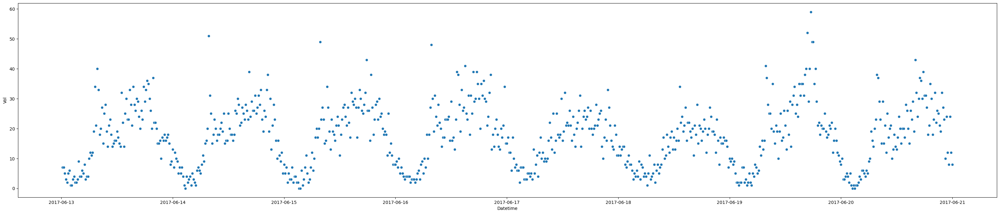

Hue: {'SegmentID': 86065, 'Direction': 'WB'}


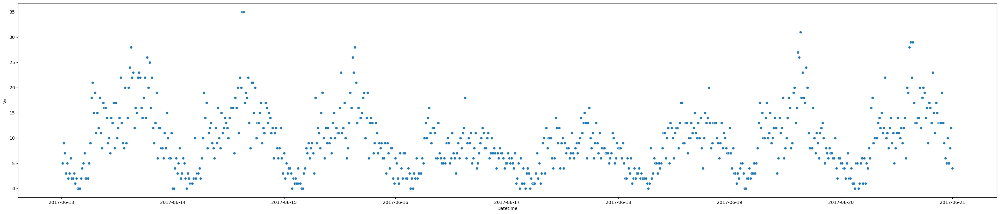

Hue: {'SegmentID': 86219, 'Direction': 'EB'}


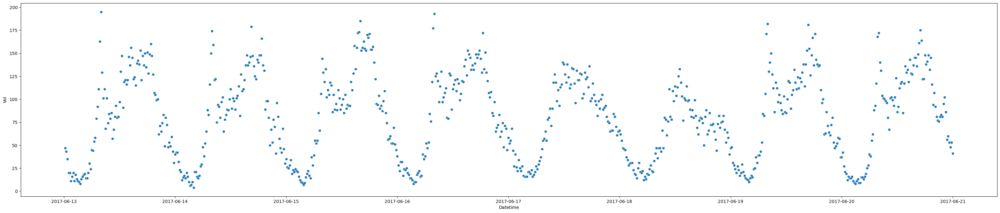

Hue: {'SegmentID': 87447, 'Direction': 'NB'}


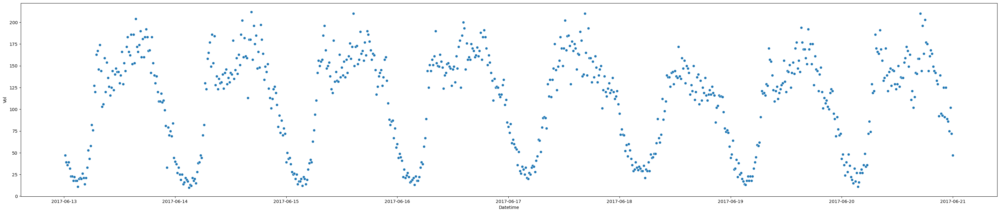

Hue: {'SegmentID': 85914, 'Direction': 'SB'}


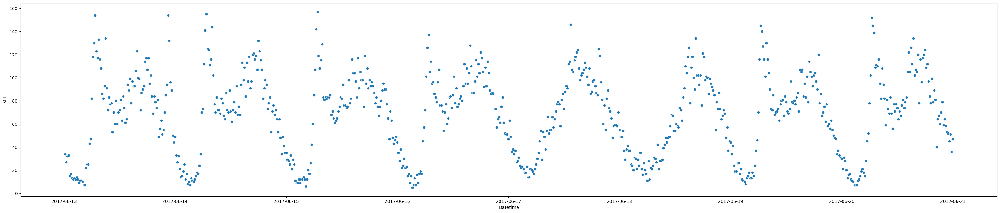

Hue: {'SegmentID': 86064, 'Direction': 'SB'}


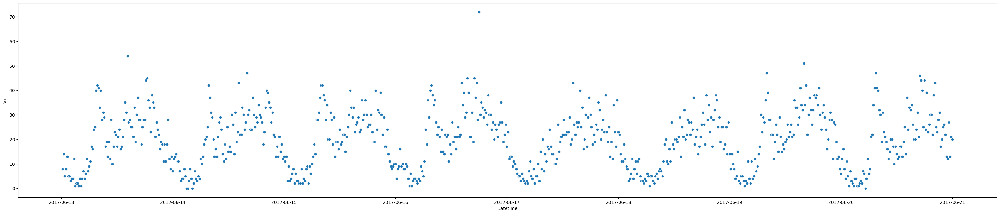

Hue: {'SegmentID': 86462, 'Direction': 'NB'}


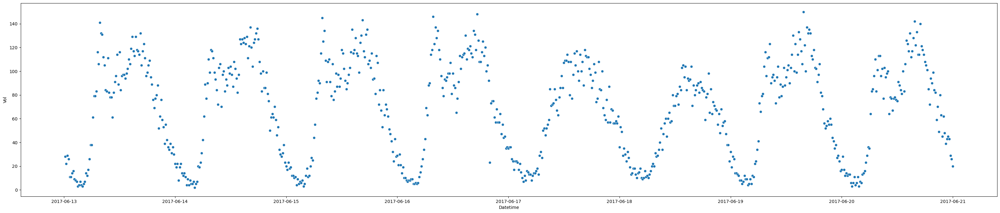

Hue: {'SegmentID': 86053, 'Direction': 'NB'}


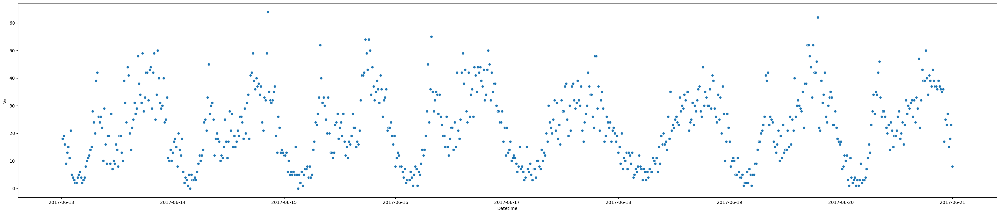

Hue: {'SegmentID': 86230, 'Direction': 'SB'}


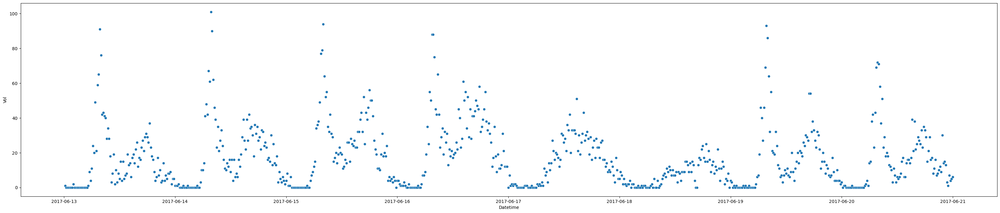

Hue: {'SegmentID': 86491, 'Direction': 'WB'}


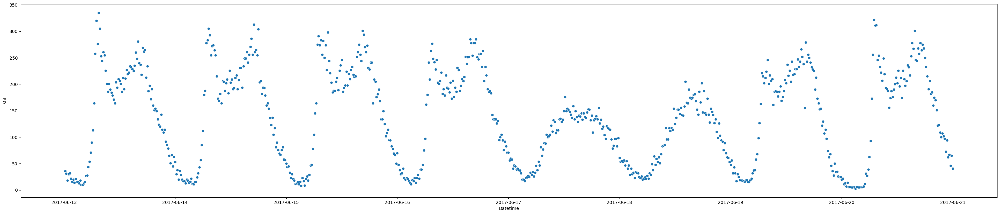

Hue: {'SegmentID': 148398, 'Direction': 'WB'}


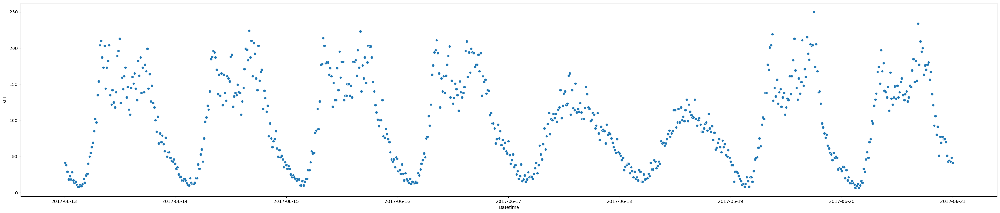

Hue: {'SegmentID': 194931, 'Direction': 'SB'}


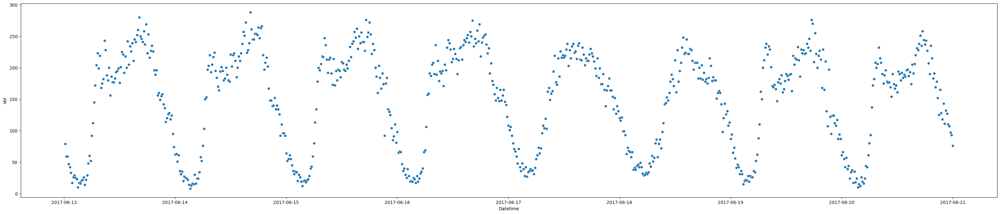

Hue: {'SegmentID': 86234, 'Direction': 'WB'}


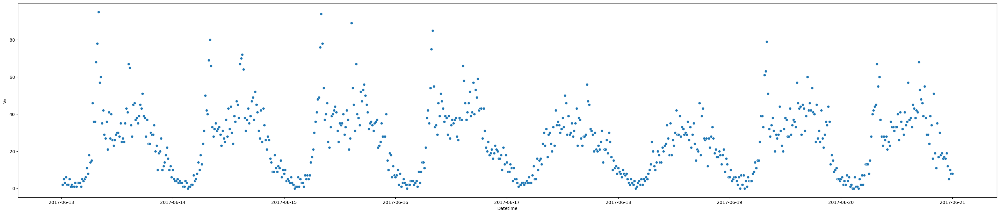

Hue: {'SegmentID': 86040, 'Direction': 'SB'}


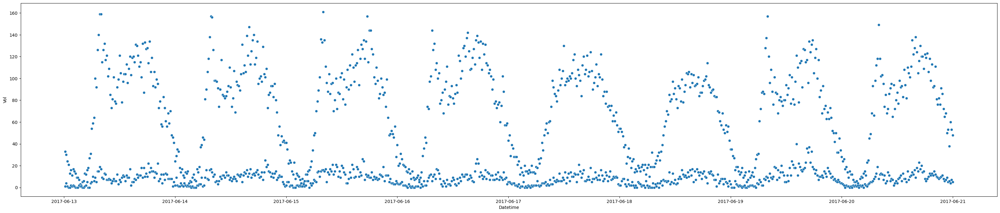

Hue: {'SegmentID': 87440, 'Direction': 'EB'}


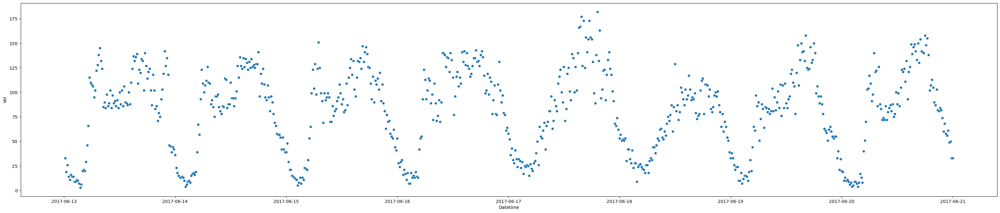

Hue: {'SegmentID': 114135, 'Direction': 'WB'}


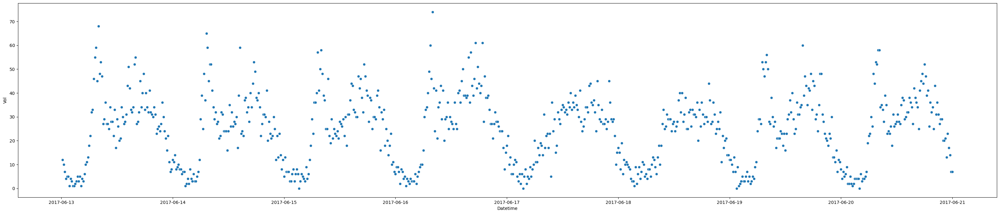

Hue: {'SegmentID': 85912, 'Direction': 'SB'}


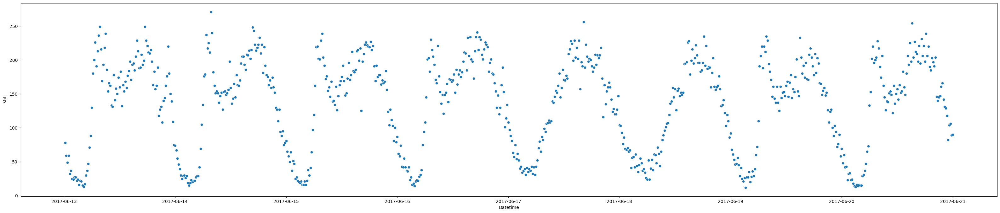

Hue: {'SegmentID': 86231, 'Direction': 'SB'}


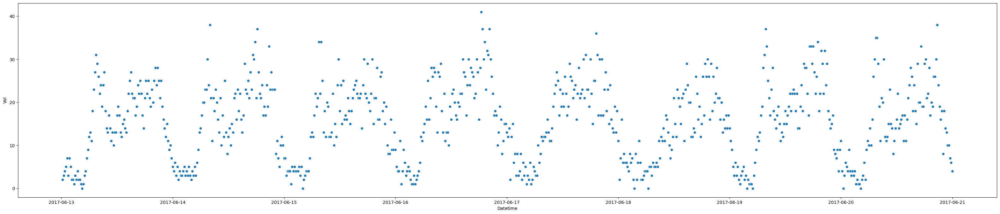

Hue: {'SegmentID': 86487, 'Direction': 'WB'}


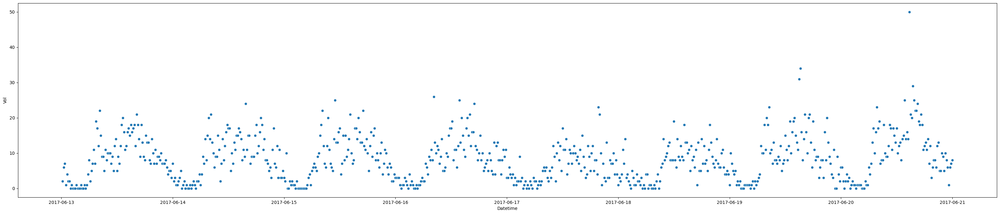

Hue: {'SegmentID': 86225, 'Direction': 'EB'}


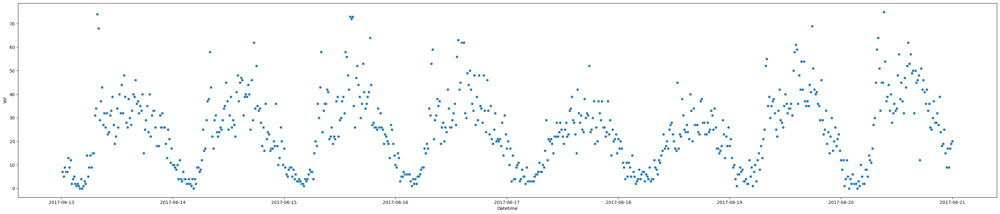

Hue: {'SegmentID': 87459, 'Direction': 'SB'}


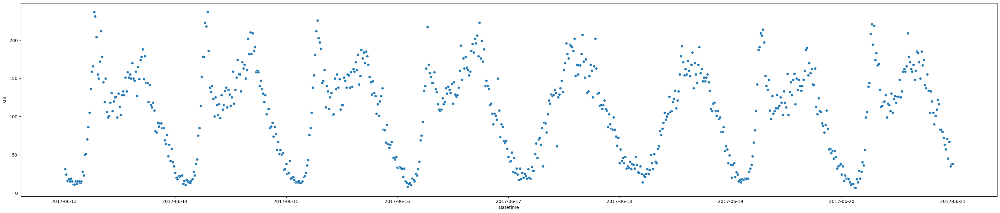

Hue: {'SegmentID': 39977, 'Direction': 'NB'}


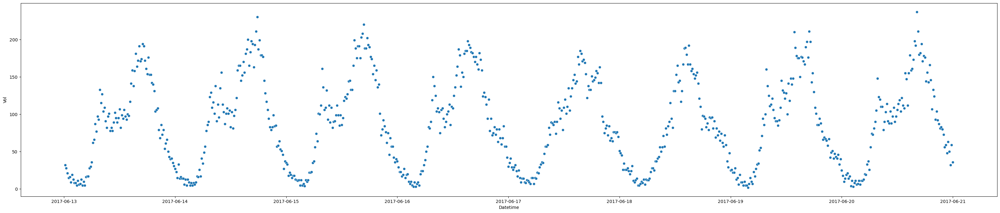

Hue: {'SegmentID': 79180, 'Direction': 'NB'}


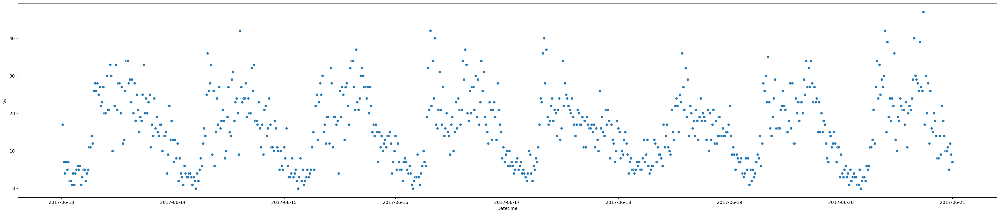

Hue: {'SegmentID': 81341, 'Direction': 'NB'}


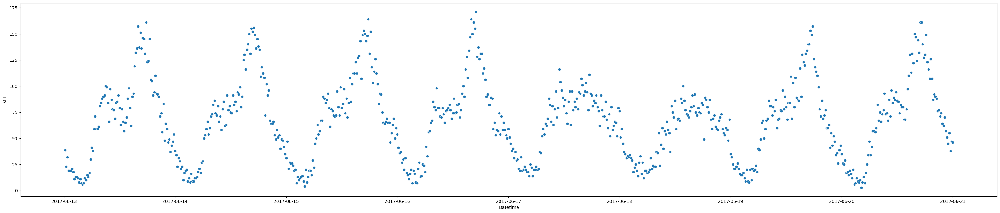

Hue: {'SegmentID': 160222, 'Direction': 'EB'}


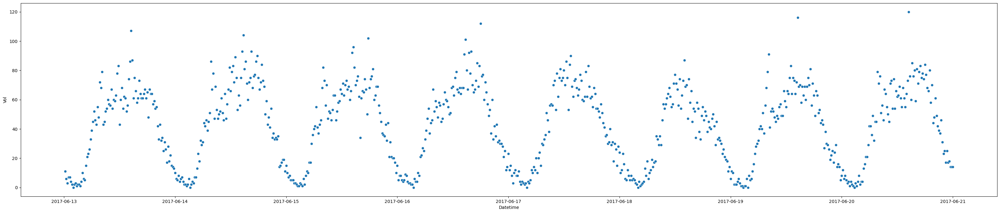

Hue: {'SegmentID': 160346, 'Direction': 'EB'}


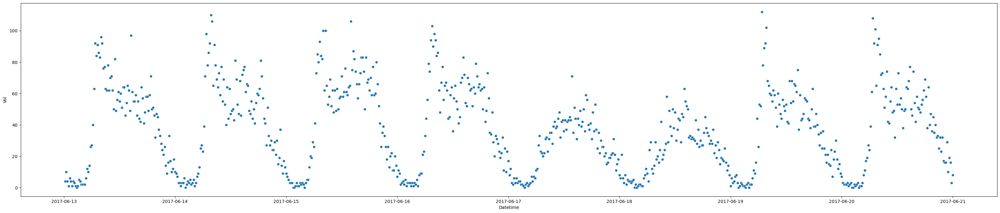

Hue: {'SegmentID': 11787, 'Direction': 'SB'}


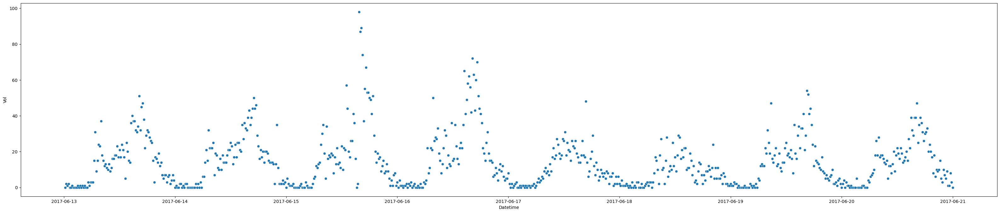

Hue: {'SegmentID': 65785, 'Direction': 'SB'}


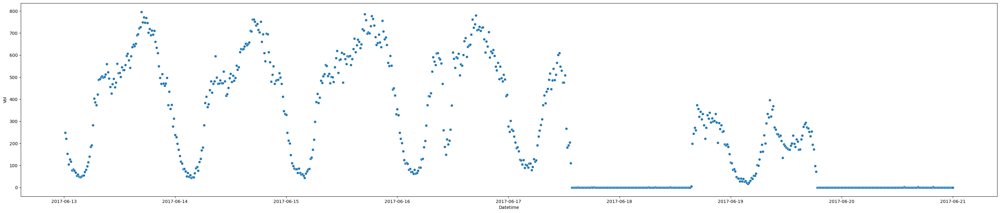

Hue: {'SegmentID': 177593, 'Direction': 'EB'}


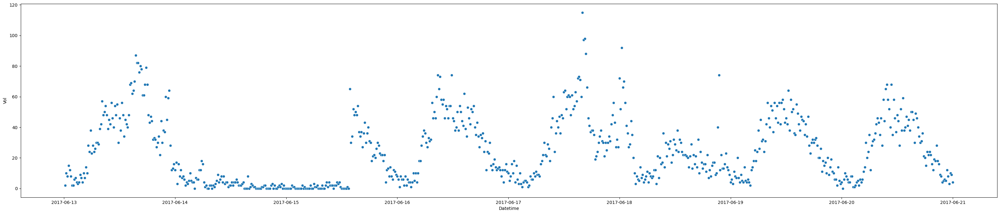

Hue: {'SegmentID': 137934, 'Direction': 'EB'}


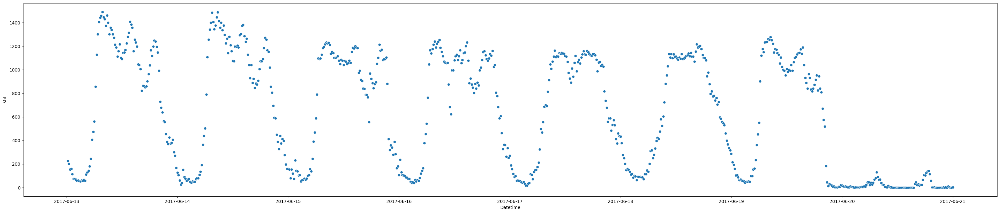

Hue: {'SegmentID': 79147, 'Direction': 'SB'}


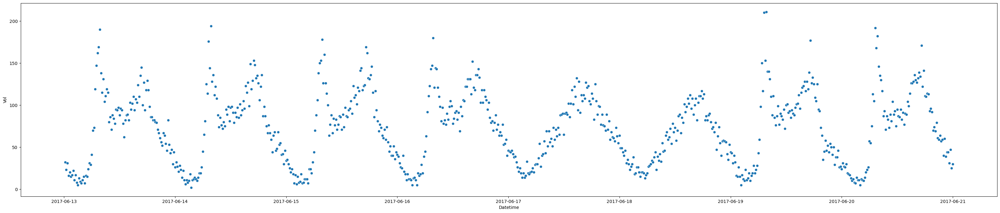

Hue: {'SegmentID': 135152, 'Direction': 'NB'}


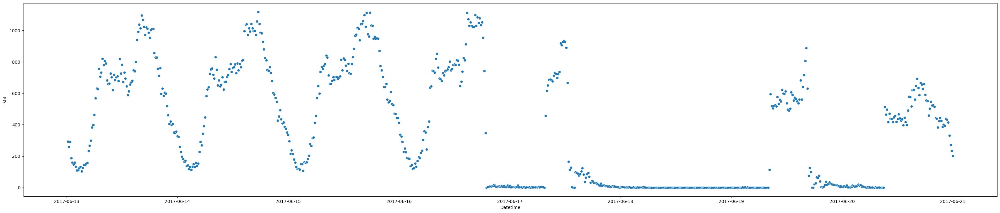

Hue: {'SegmentID': 11787, 'Direction': 'NB'}


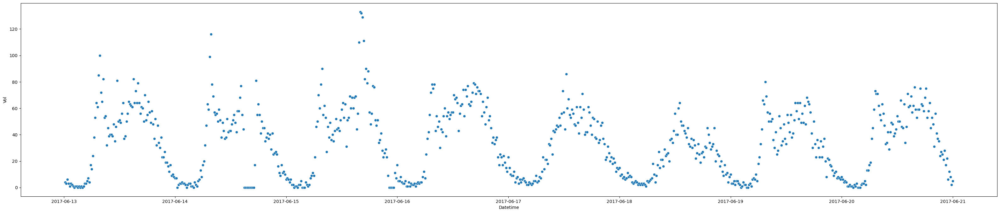

Hue: {'SegmentID': 160344, 'Direction': 'WB'}


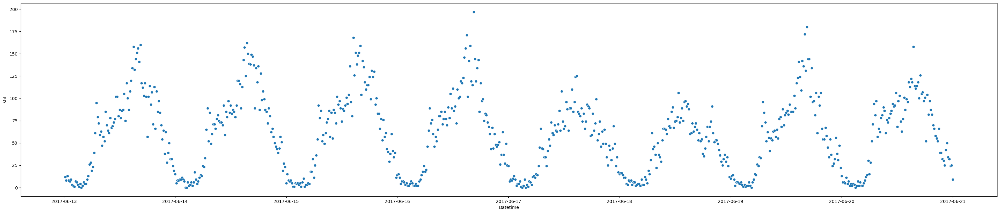

Hue: {'SegmentID': 175381, 'Direction': 'WB'}


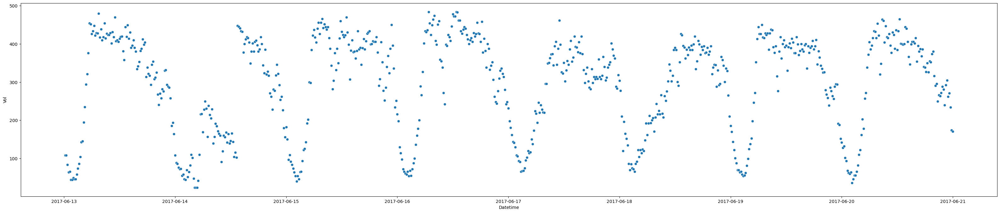

Hue: {'SegmentID': 79001, 'Direction': 'NB'}


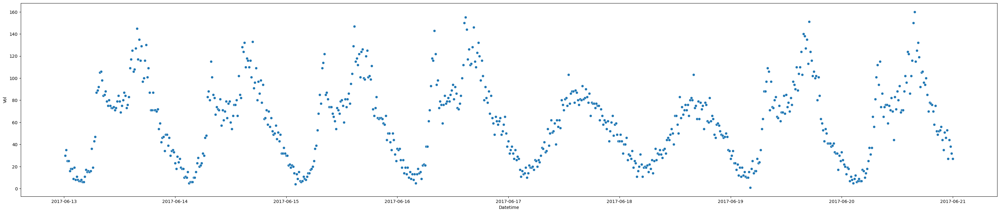

Hue: {'SegmentID': 84439, 'Direction': 'SB'}


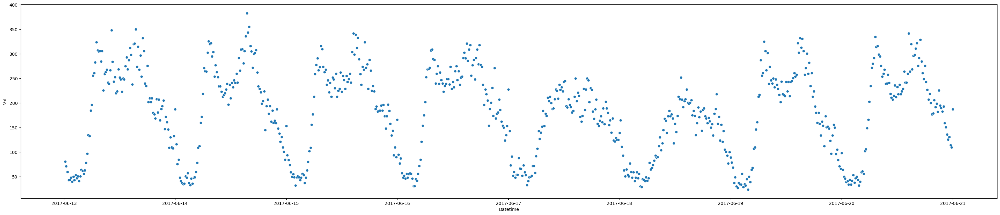

Hue: {'SegmentID': 160222, 'Direction': 'WB'}


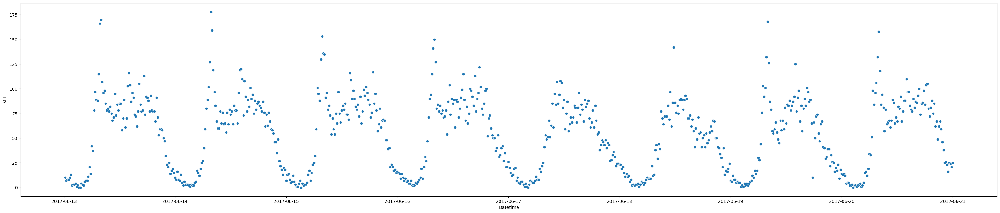

Hue: {'SegmentID': 79199, 'Direction': 'WB'}


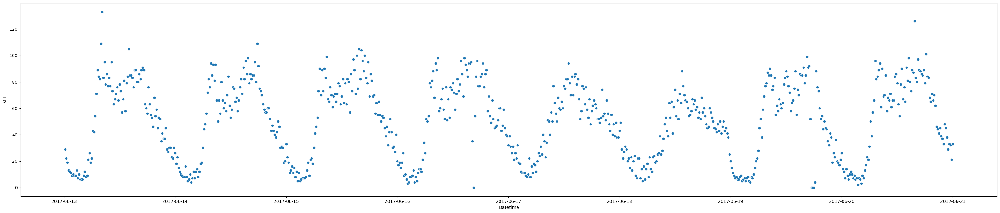

Hue: {'SegmentID': 79199, 'Direction': 'NB'}


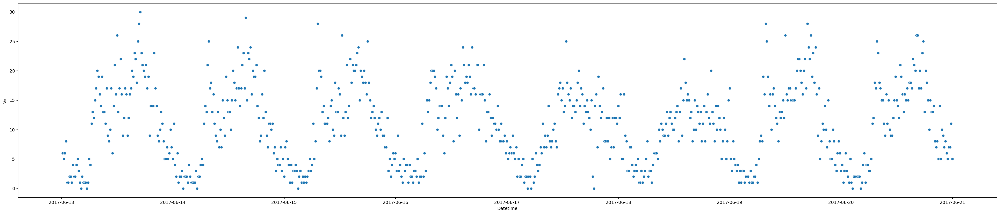

Hue: {'SegmentID': 138592, 'Direction': 'NB'}


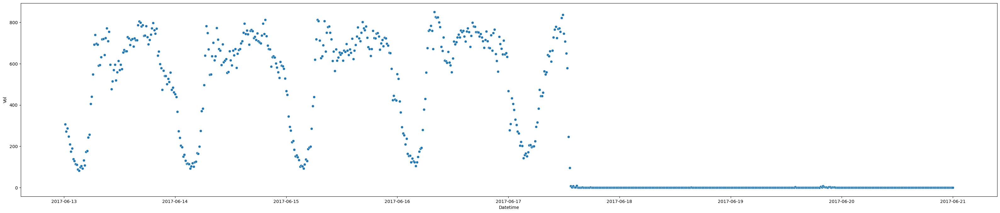

Hue: {'SegmentID': 255311, 'Direction': 'NB'}


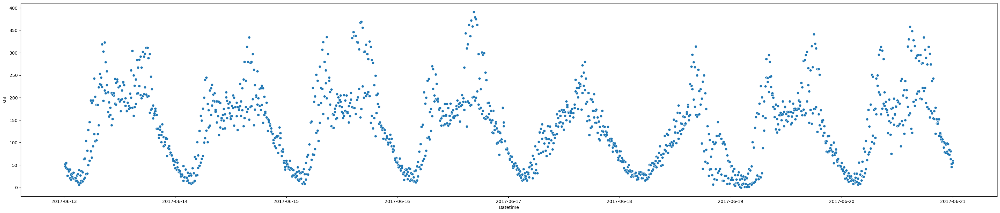

Hue: {'SegmentID': 39978, 'Direction': 'WB'}


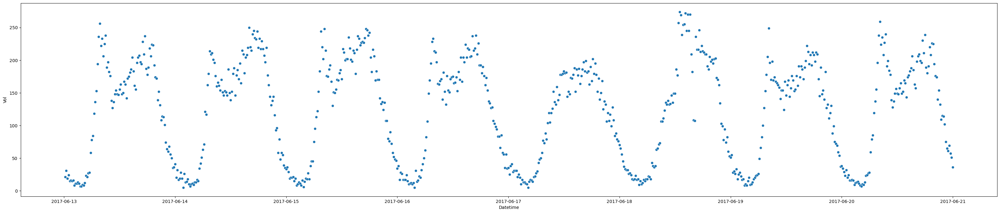

Hue: {'SegmentID': 84005, 'Direction': 'WB'}


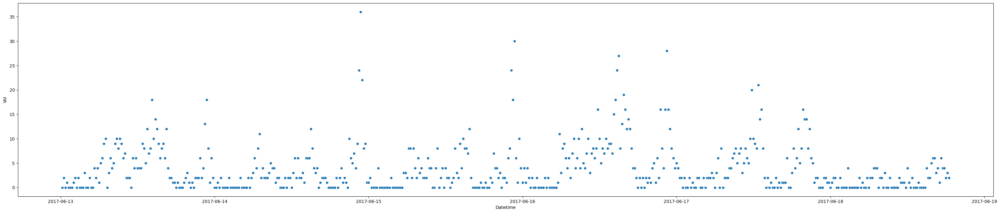

Hue: {'SegmentID': 142783, 'Direction': 'NB'}


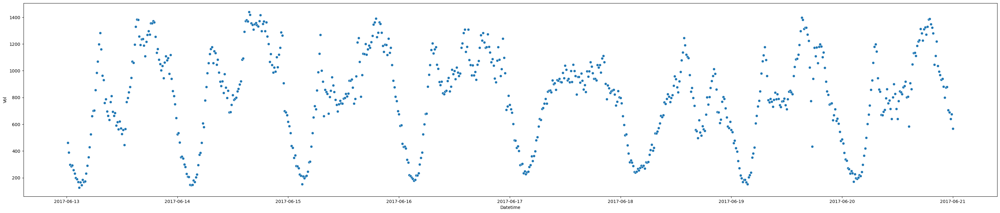

Hue: {'SegmentID': 83890, 'Direction': 'EB'}


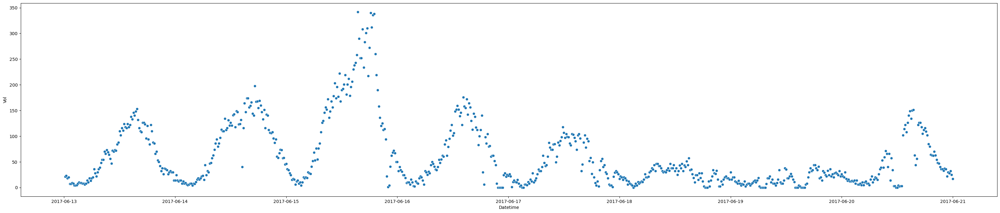

Hue: {'SegmentID': 177593, 'Direction': 'WB'}


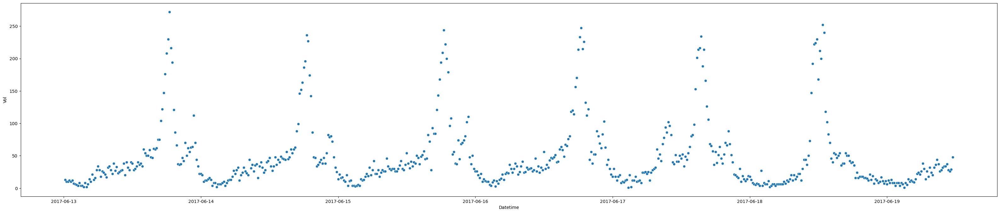

Hue: {'SegmentID': 105505, 'Direction': 'NB'}


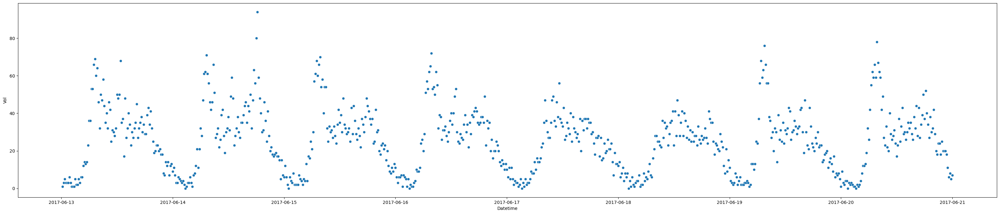

Hue: {'SegmentID': 268582, 'Direction': 'SB'}


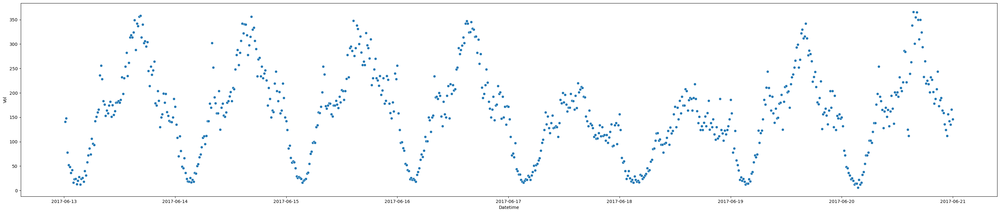

Hue: {'SegmentID': 172152, 'Direction': 'WB'}


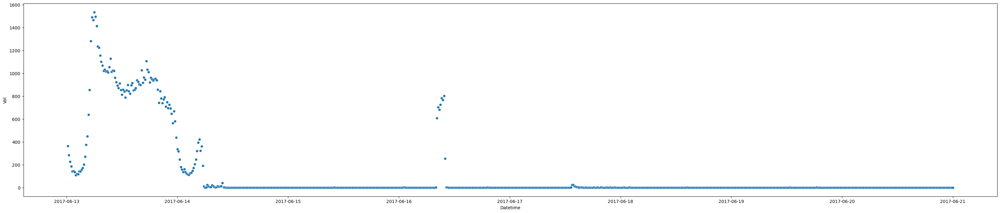

Hue: {'SegmentID': 192756, 'Direction': 'EB'}


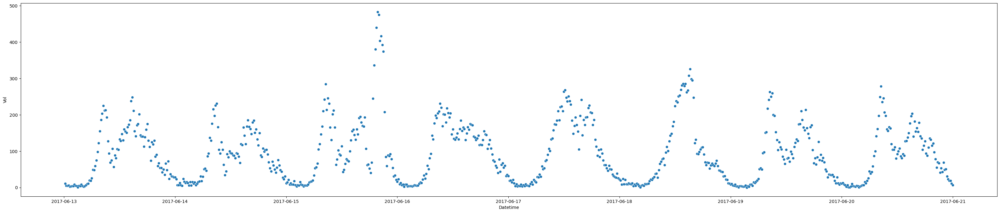

Hue: {'SegmentID': 136512, 'Direction': 'EB'}


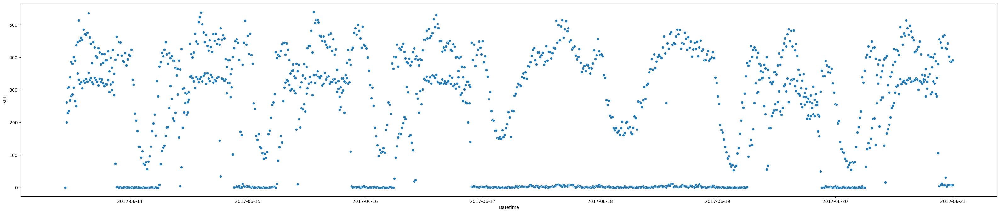

Hue: {'SegmentID': 84005, 'Direction': 'EB'}


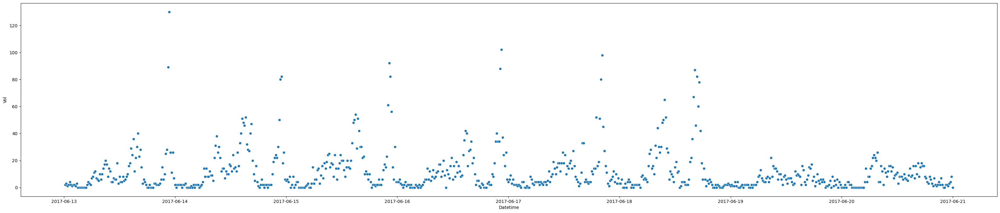

Hue: {'SegmentID': 79016, 'Direction': 'SB'}


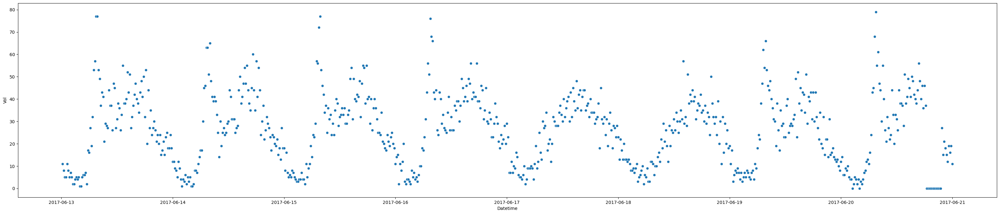

Hue: {'SegmentID': 103857, 'Direction': 'WB'}


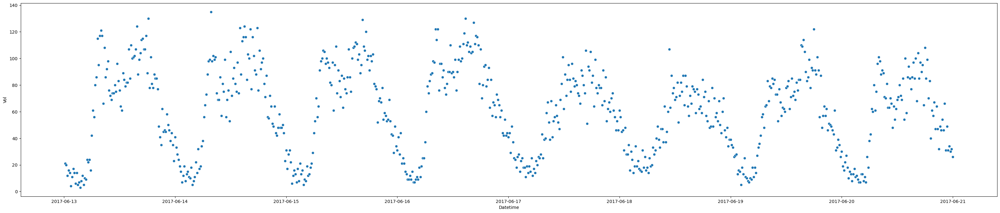

Hue: {'SegmentID': 137935, 'Direction': 'WB'}


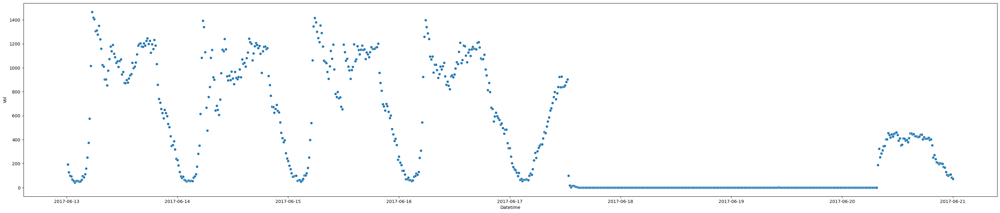

Hue: {'SegmentID': 192770, 'Direction': 'EB'}


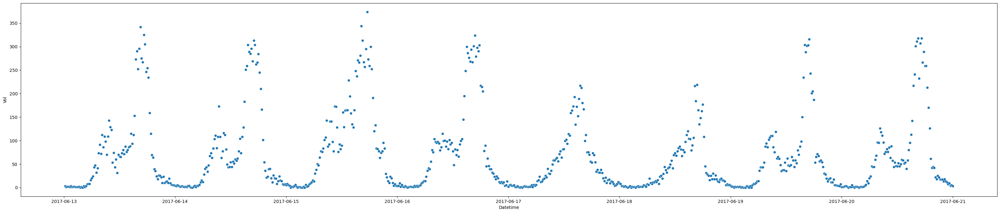

Hue: {'SegmentID': 142785, 'Direction': 'SB'}


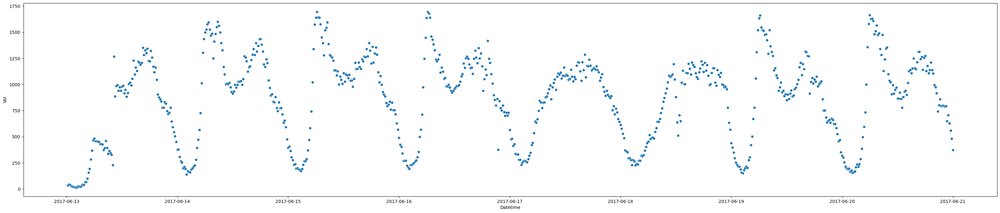

Hue: {'SegmentID': 39976, 'Direction': 'EB'}


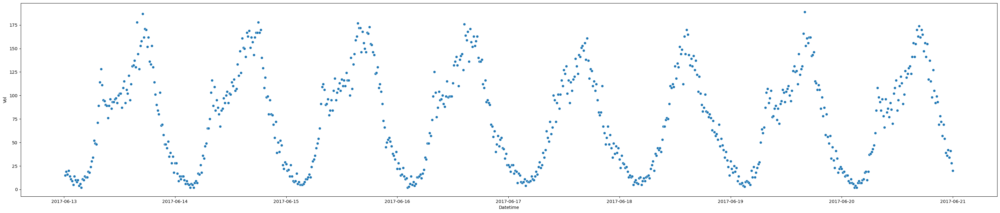

Hue: {'SegmentID': 103857, 'Direction': 'EB'}


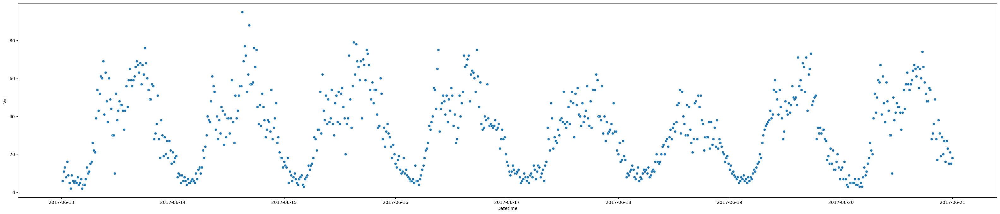

Hue: {'SegmentID': 194239, 'Direction': 'SB'}


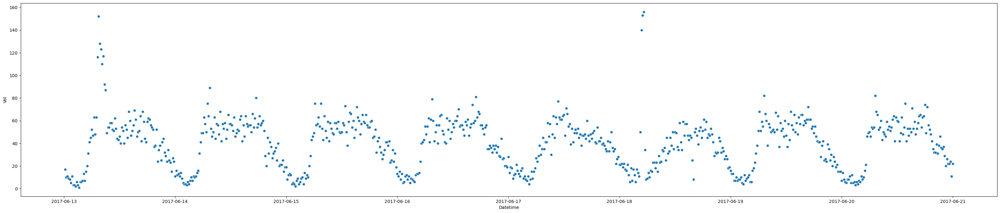

Hue: {'SegmentID': 39978, 'Direction': 'EB'}


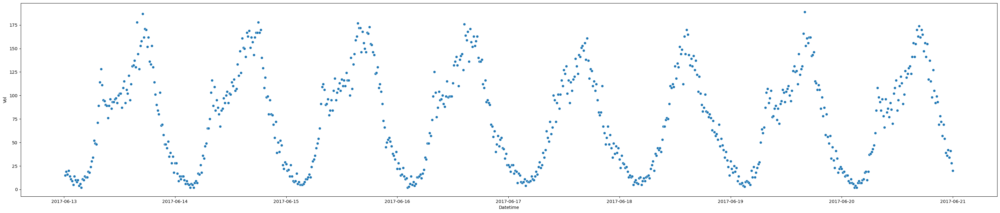

Hue: {'SegmentID': 10855, 'Direction': 'EB'}


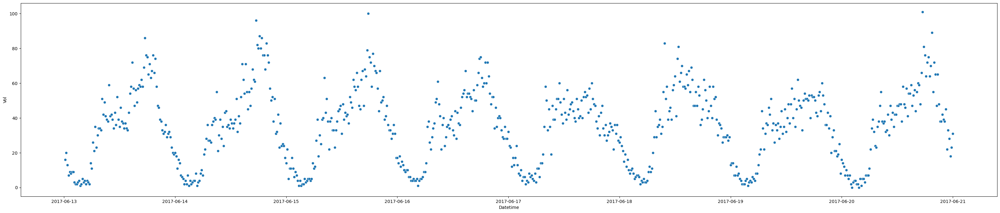

Hue: {'SegmentID': 105505, 'Direction': 'SB'}


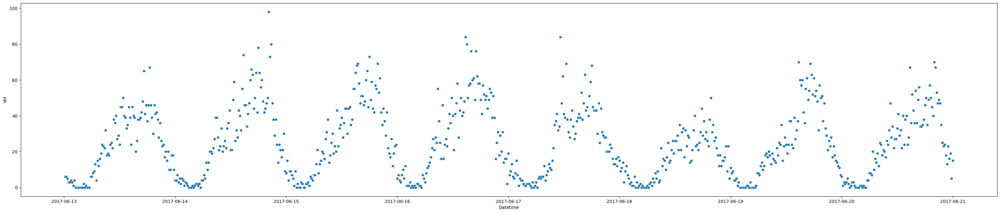

Hue: {'SegmentID': 79015, 'Direction': 'WB'}


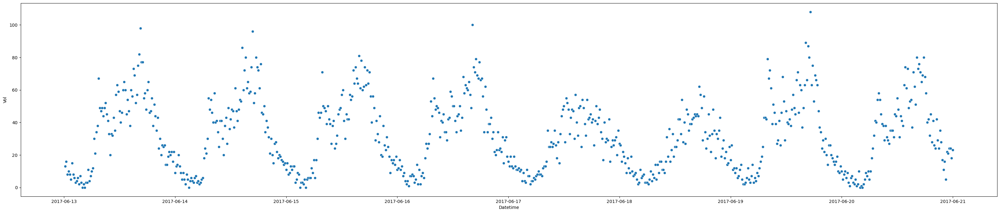

Hue: {'SegmentID': 10855, 'Direction': 'WB'}


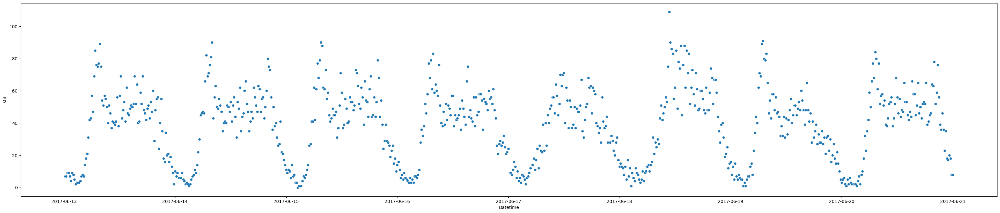

Hue: {'SegmentID': 192771, 'Direction': 'WB'}


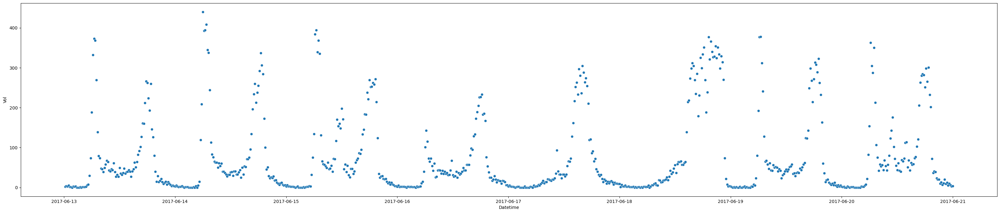

Hue: {'SegmentID': 184079, 'Direction': 'WB'}


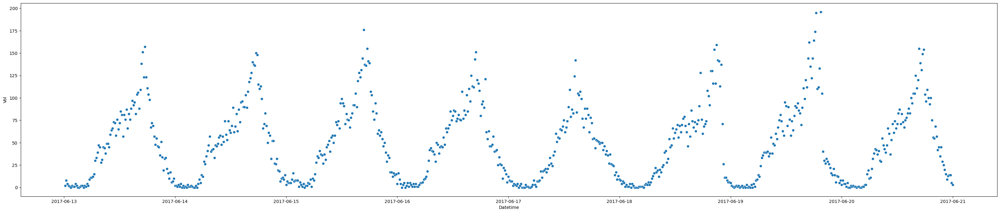

Hue: {'SegmentID': 184079, 'Direction': 'EB'}


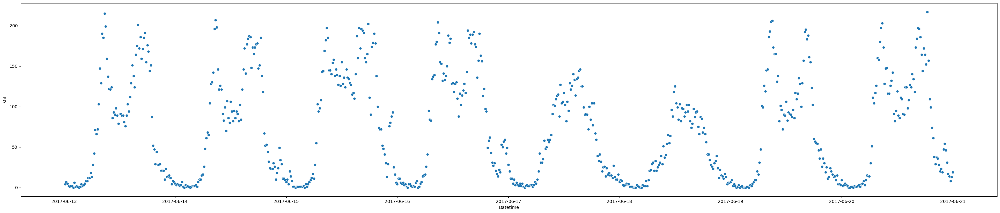

Hue: {'SegmentID': 140178, 'Direction': 'SB'}


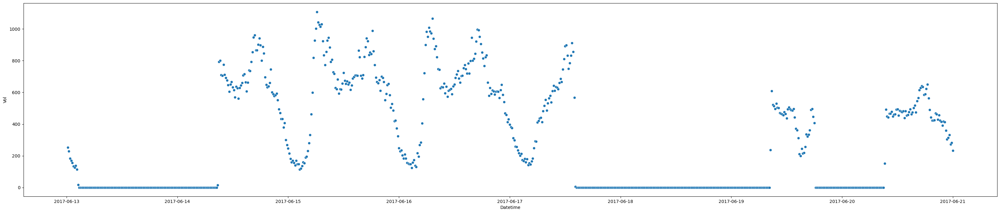

Hue: {'SegmentID': 39873, 'Direction': 'SB'}


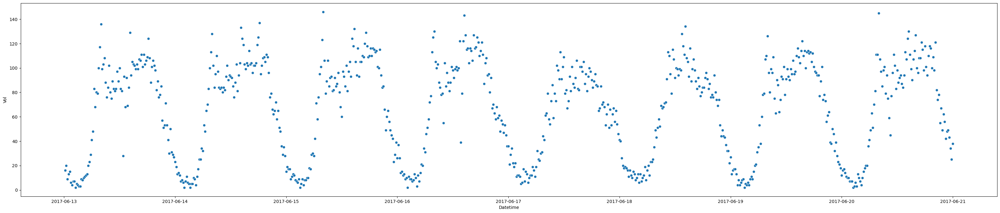

Hue: {'SegmentID': 192731, 'Direction': 'WB'}


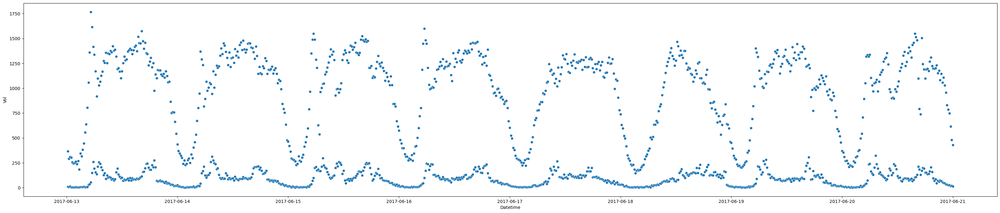

Hue: {'SegmentID': 79150, 'Direction': 'WB'}


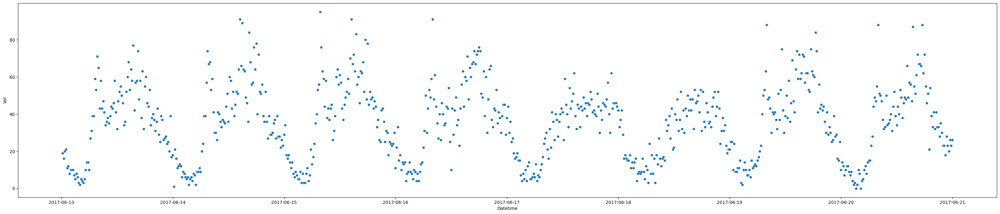

In [79]:
create_scatterplots(tmp_df, 'Datetime', 'Vol', ['SegmentID', 'Direction'])

In [80]:
tmp_df.write\
    .partitionBy('Boro')\
    .format('csv')\
    .save('datas/')